In [3]:
from matminer.datasets.convenience_loaders import load_elastic_tensor
from matminer.featurizers.conversions import StrToComposition, CompositionToOxidComposition
from matminer.featurizers.composition import ElementProperty, OxidationStates
from matminer.featurizers.structure import DensityFeatures
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold, cross_val_score, cross_val_predict
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Import Data and Preprocessing 

In [8]:
df_pec_data = pd.read_excel('PEC_dataset-JCAP.xlsx', header = 1)
df_pec_data = df_pec_data.sort_values(['Sample'], ignore_index = True)
col_labels = ['Sample ID', 'Bi', 'V', 'W', 'Dy', 'Gd', 'Mo', 'Tb', 'Pmax (mW/cm^2)']
df_pec_data.columns = col_labels
df_pec_data

,Sample ID,Bi,V,W,Dy,Gd,Mo,Tb,Pmax (mW/cm^2)
0,1,0.520000,0.480000,0.000000,0.0,0.0,0.0,0.0,0.038472
1,2,0.520000,0.480000,0.000000,0.0,0.0,0.0,0.0,0.120282
2,3,0.520000,0.480000,0.000000,0.0,0.0,0.0,0.0,0.168887
3,4,0.503226,0.496774,0.000000,0.0,0.0,0.0,0.0,0.070647
4,5,0.501608,0.498392,0.000000,0.0,0.0,0.0,0.0,0.043980
...,...,...,...,...,...,...,...,...,...
1374,2107,0.466755,0.503989,0.029255,0.0,0.0,0.0,0.0,0.390934
1375,2108,0.463366,0.500330,0.036304,0.0,0.0,0.0,0.0,0.356557
1376,2109,0.446352,0.490701,0.062947,0.0,0.0,0.0,0.0,0.202859
1377,2110,0.491184,0.488035,0.020781,0.0,0.0,0.0,0.0,0.230917


#### Clean Duplicates and Keep Max Power Entries 

In [9]:
row_i = 0
formula_list = []
for row_i in range(len(df_pec_data)):
    formula = ''
    for col_j in np.arange(1,8,1):
        elm_frac = np.around(df_pec_data.iloc[row_i].values[col_j], 2)      #保留两位小数
        if elm_frac > 0:
            formula+=col_labels[col_j]+str(elm_frac)        
    formula_list.append(formula)
df_pec_data['formula'] = formula_list   #为pd数据格式加了一列formula数据
df_pec_data 

,Sample ID,Bi,V,W,Dy,Gd,Mo,Tb,Pmax (mW/cm^2),formula
0,1,0.520000,0.480000,0.000000,0.0,0.0,0.0,0.0,0.038472,Bi0.52V0.48
1,2,0.520000,0.480000,0.000000,0.0,0.0,0.0,0.0,0.120282,Bi0.52V0.48
2,3,0.520000,0.480000,0.000000,0.0,0.0,0.0,0.0,0.168887,Bi0.52V0.48
3,4,0.503226,0.496774,0.000000,0.0,0.0,0.0,0.0,0.070647,Bi0.5V0.5
4,5,0.501608,0.498392,0.000000,0.0,0.0,0.0,0.0,0.043980,Bi0.5V0.5
...,...,...,...,...,...,...,...,...,...,...
1374,2107,0.466755,0.503989,0.029255,0.0,0.0,0.0,0.0,0.390934,Bi0.47V0.5W0.03
1375,2108,0.463366,0.500330,0.036304,0.0,0.0,0.0,0.0,0.356557,Bi0.46V0.5W0.04
1376,2109,0.446352,0.490701,0.062947,0.0,0.0,0.0,0.0,0.202859,Bi0.45V0.49W0.06
1377,2110,0.491184,0.488035,0.020781,0.0,0.0,0.0,0.0,0.230917,Bi0.49V0.49W0.02


In [10]:
df_pec_data_sorted = df_pec_data.sort_values(by=['formula','Pmax (mW/cm^2)'],ascending = True) #升序排列
df_pec_data_sorted.head(-10)        #?why not make it show last 10 row(X delete)

KeyboardInterrupt: 

In [11]:
df_pec_data_cleaned = df_pec_data_sorted.drop_duplicates('formula', keep='last',ignore_index=True)  #pd格式下按相同的formula过滤，并只留下最后一个P最大的
df_pec_data_cleaned

,Sample ID,Bi,V,W,Dy,Gd,Mo,Tb,Pmax (mW/cm^2),formula
0,1023,0.439437,0.483099,0.000000,0.007746,0.069718,0.000000,0.000000,0.258551,Bi0.44V0.48Dy0.01Gd0.07
1,1745,0.439437,0.483099,0.000000,0.007746,0.000000,0.069718,0.000000,0.592655,Bi0.44V0.48Dy0.01Mo0.07
2,1558,0.439437,0.483099,0.000000,0.007746,0.000000,0.000000,0.069718,0.649684,Bi0.44V0.48Dy0.01Tb0.07
3,1020,0.439437,0.483099,0.000000,0.023239,0.054225,0.000000,0.000000,0.522710,Bi0.44V0.48Dy0.02Gd0.05
4,1011,0.439437,0.483099,0.000000,0.015493,0.061972,0.000000,0.000000,0.650444,Bi0.44V0.48Dy0.02Gd0.06
...,...,...,...,...,...,...,...,...,...,...
611,267,0.498084,0.494891,0.000000,0.000000,0.007024,0.000000,0.000000,0.061652,Bi0.5V0.49Gd0.01
612,1899,0.498084,0.494891,0.000000,0.000000,0.000000,0.007024,0.000000,0.560389,Bi0.5V0.49Mo0.01
613,1434,0.498084,0.494891,0.000000,0.000000,0.000000,0.000000,0.007024,0.048722,Bi0.5V0.49Tb0.01
614,2093,0.498084,0.494891,0.007024,0.000000,0.000000,0.000000,0.000000,0.553551,Bi0.5V0.49W0.01


In [12]:
df_pec = StrToComposition().featurize_dataframe(df_pec_data_cleaned, "formula") #似乎是按前几列的colum label整理target col的数据，输出含有前几列的label，并作为新的col添加到pd中
df_pec.head(10)


StrToComposition:   0%|          | 0/616 [00:00<?, ?it/s]

,Sample ID,Bi,V,W,Dy,Gd,Mo,Tb,Pmax (mW/cm^2),formula,composition
0,1023,0.439437,0.483099,0.0,0.007746,0.069718,0.000000,0.000000,0.258551,Bi0.44V0.48Dy0.01Gd0.07,"(Bi, V, Dy, Gd)"
1,1745,0.439437,0.483099,0.0,0.007746,0.000000,0.069718,0.000000,0.592655,Bi0.44V0.48Dy0.01Mo0.07,"(Bi, V, Dy, Mo)"
2,1558,0.439437,0.483099,0.0,0.007746,0.000000,0.000000,0.069718,0.649684,Bi0.44V0.48Dy0.01Tb0.07,"(Bi, V, Dy, Tb)"
3,1020,0.439437,0.483099,0.0,0.023239,0.054225,0.000000,0.000000,0.522710,Bi0.44V0.48Dy0.02Gd0.05,"(Bi, V, Dy, Gd)"
4,1011,0.439437,0.483099,0.0,0.015493,0.061972,0.000000,0.000000,0.650444,Bi0.44V0.48Dy0.02Gd0.06,"(Bi, V, Dy, Gd)"
5,1735,0.439437,0.483099,0.0,0.023239,0.000000,0.054225,0.000000,0.642537,Bi0.44V0.48Dy0.02Mo0.05,"(Bi, V, Dy, Mo)"
6,1738,0.439437,0.483099,0.0,0.015493,0.000000,0.061972,0.000000,0.580273,Bi0.44V0.48Dy0.02Mo0.06,"(Bi, V, Dy, Mo)"
7,1564,0.439437,0.483099,0.0,0.023239,0.000000,0.000000,0.054225,0.938737,Bi0.44V0.48Dy0.02Tb0.05,"(Bi, V, Dy, Tb)"
8,1562,0.439437,0.483099,0.0,0.015493,0.000000,0.000000,0.061972,0.557919,Bi0.44V0.48Dy0.02Tb0.06,"(Bi, V, Dy, Tb)"
9,1068,0.439437,0.483099,0.0,0.030986,0.046479,0.000000,0.000000,0.233272,Bi0.44V0.48Dy0.03Gd0.05,"(Bi, V, Dy, Gd)"


In [13]:
from sklearn.feature_selection import RFE
from sklearn.feature_selection import mutual_info_regression

In [14]:
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_absolute_percentage_error as mape
from scipy.stats import spearmanr

def y_inverse_transform(y_list, std_scalery):
    #y_orignal = np.exp(std_scalery.inverse_transform(y_list.reshape(-1,1)))
    #y_orignal = std_scalery.inverse_transform(y_list.reshape(-1,1))
    y_orignal = y_list.reshape(-1,1)
    return y_orignal 


def plt_true_vs_pred (y_true_list, y_pred_list, y_uncer_list, title_str_list, color_list):
    fig, axes = plt.subplots(1, 2, figsize=(5.5*2, 4.5))
    fs = 20
    for i in np.arange(len(axes)):
        ## inverse transform 
        y_true = y_inverse_transform(y_true_list[i], std_scalery)
        y_pred = y_inverse_transform(y_pred_list[i], std_scalery)
        y_uncer = np.sqrt(y_uncer_list[i][:,-1])

        lims1 = (0*0.9, 3*1.1)
                        # ========================================================================
        axes[i].scatter(y_true, y_pred, alpha = 0.3, c = color_list[i])
        axes[i].errorbar(y_true, y_pred, yerr = y_uncer, ms = 0, 
                         ls = '', capsize = 2, alpha = 0.6,
                         color = 'gray', zorder = 0)

        axes[i].plot(lims1, lims1, 'k--', alpha=0.75, zorder=0)
        rmse_value = np.sqrt(mse(y_true, y_pred))
        mae_value = mae(y_true, y_pred)
        mape_value = mape(y_true, y_pred) 
        spearman = spearmanr(y_true, y_pred) [0]
        title = title_str_list[i] + " (sprman="+str(np.round(spearman,2))+')'
        axes[i].set_xlabel('Ground Truth', fontsize = fs)
        axes[i].set_ylabel('Prediction', fontsize = fs)
        axes[i].set_title(title, fontsize = fs)
        axes[i].set_xlim(0,3.5)
        axes[i].set_ylim(0,3.5)
#         axes[i].set_yscale('log')
#         axes[i].set_xscale('log')

        axes[i].tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
        axes[i].grid(True, linestyle='-.')

        
    plt.subplots_adjust(wspace = 0.35)
    plt.show()

## Build regression model with composition descriptors (from `matminer`)

In [15]:
ep_feat = ElementProperty.from_preset(preset_name="magpie")
df_pec_magpie = ep_feat.featurize_dataframe(df_pec, col_id="composition")  #这两行是matminer的固定操作，用于加入描述符col
# input the "composition" column to the featurizer
df_pec_magpie.head(10)


ElementProperty:   0%|          | 0/616 [00:00<?, ?it/s]

,Sample ID,Bi,V,W,Dy,Gd,Mo,Tb,Pmax (mW/cm^2),formula,...,MagpieData range GSmagmom,MagpieData mean GSmagmom,MagpieData avg_dev GSmagmom,MagpieData mode GSmagmom,MagpieData minimum SpaceGroupNumber,MagpieData maximum SpaceGroupNumber,MagpieData range SpaceGroupNumber,MagpieData mean SpaceGroupNumber,MagpieData avg_dev SpaceGroupNumber,MagpieData mode SpaceGroupNumber
0,1023,0.439437,0.483099,0.0,0.007746,0.069718,0.000000,0.000000,0.258551,Bi0.44V0.48Dy0.01Gd0.07,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.720000,104.473600,229.0
1,1745,0.439437,0.483099,0.0,0.007746,0.000000,0.069718,0.000000,0.592655,Bi0.44V0.48Dy0.01Mo0.07,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,133.170000,106.629600,229.0
2,1558,0.439437,0.483099,0.0,0.007746,0.000000,0.000000,0.069718,0.649684,Bi0.44V0.48Dy0.01Tb0.07,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.720000,104.473600,229.0
3,1020,0.439437,0.483099,0.0,0.023239,0.054225,0.000000,0.000000,0.522710,Bi0.44V0.48Dy0.02Gd0.05,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.080808,104.960718,229.0
4,1011,0.439437,0.483099,0.0,0.015493,0.061972,0.000000,0.000000,0.650444,Bi0.44V0.48Dy0.02Gd0.06,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.720000,104.473600,229.0
5,1735,0.439437,0.483099,0.0,0.023239,0.000000,0.054225,0.000000,0.642537,Bi0.44V0.48Dy0.02Mo0.05,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,131.848485,106.531987,229.0
6,1738,0.439437,0.483099,0.0,0.015493,0.000000,0.061972,0.000000,0.580273,Bi0.44V0.48Dy0.02Mo0.06,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,132.820000,106.321600,229.0
7,1564,0.439437,0.483099,0.0,0.023239,0.000000,0.000000,0.054225,0.938737,Bi0.44V0.48Dy0.02Tb0.05,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.080808,104.960718,229.0
8,1562,0.439437,0.483099,0.0,0.015493,0.000000,0.000000,0.061972,0.557919,Bi0.44V0.48Dy0.02Tb0.06,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.720000,104.473600,229.0
9,1068,0.439437,0.483099,0.0,0.030986,0.046479,0.000000,0.000000,0.233272,Bi0.44V0.48Dy0.03Gd0.05,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,130.720000,104.473600,229.0


In [21]:
df_pec_magpie.iloc[:,11:].describe()

,MagpieData minimum Number,MagpieData maximum Number,MagpieData range Number,MagpieData mean Number,MagpieData avg_dev Number,MagpieData mode Number,MagpieData minimum MendeleevNumber,MagpieData maximum MendeleevNumber,MagpieData range MendeleevNumber,MagpieData mean MendeleevNumber,...,MagpieData range GSmagmom,MagpieData mean GSmagmom,MagpieData avg_dev GSmagmom,MagpieData mode GSmagmom,MagpieData minimum SpaceGroupNumber,MagpieData maximum SpaceGroupNumber,MagpieData range SpaceGroupNumber,MagpieData mean SpaceGroupNumber,MagpieData avg_dev SpaceGroupNumber,MagpieData mode SpaceGroupNumber
count,616.0,616.0,616.0,616.000000,616.000000,616.000000,616.000000,616.0,616.000000,616.000000,...,616.0,616.0,616.0,616.0,616.0,616.0,616.0,616.000000,616.000000,616.000000
mean,23.0,83.0,60.0,53.522910,29.048573,46.376623,31.616883,86.0,54.383117,64.487850,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,125.114369,106.953873,84.920455
std,0.0,0.0,0.0,1.103932,0.441669,29.283493,6.720867,0.0,6.720867,1.070238,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.229973,1.096214,102.583768
min,23.0,83.0,60.0,50.730000,28.230400,23.000000,27.000000,86.0,40.000000,62.080000,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,116.160000,104.473600,12.000000
25%,23.0,83.0,60.0,52.629066,28.647689,23.000000,27.000000,86.0,55.000000,63.727273,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,122.020202,106.060190,12.000000
50%,23.0,83.0,60.0,53.557778,29.082692,23.000000,29.000000,86.0,57.000000,64.540000,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,125.217376,107.122400,12.000000
75%,23.0,83.0,60.0,54.421061,29.424000,83.000000,31.000000,86.0,59.000000,65.300000,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,128.171717,107.805600,229.000000
max,23.0,83.0,60.0,55.880000,30.000000,83.000000,46.000000,86.0,59.000000,66.800000,...,0.0,0.0,0.0,0.0,12.0,229.0,217.0,133.520000,108.500000,229.000000


In [22]:
X_compo = df_pec_magpie.iloc[:,11:].values  # all descriptors
y_pmax = df_pec_magpie.iloc[:,8].values     #P（Eff max）

 /Users/chrisliu/opt/anaconda3/envs/matminer/lib/python3.10/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning:A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


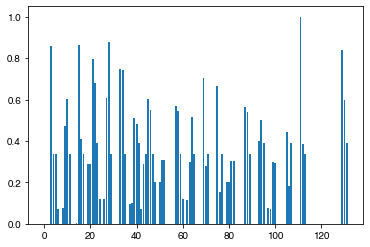

In [23]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split 

std_scalerX = MinMaxScaler()            #用于进行col数据的归一化（norm1）到[0,1]之间，是按列进行norm（将数据的每一个属性值减去其最小值，然后除以其极差）
std_scalery = StandardScaler()          #是一个用来对数据进行归一化和标准化的类norm2（利用var std等（那么在预测的时候， 也要对数据做同样的标准化处理，即也要用上面的scaler中的均值和方差来对预测时候的特征进行标准化

X = np.array(X_compo)
#X_log = np.log(X.astype('float'))   
y = np.array(y_pmax.reshape(-1,1))      

mi = mutual_info_regression(X, y)   #[616, 132] VS [616, 1]
mi /= np.max(mi)                    #还是norm3
plt.bar(np.arange(len(mi)), mi)     #mi 为132项， 画图是为了看mat desc中哪项对于Pmax的关联性最大
plt.show()

from sklearn.decomposition import PCA
pca = PCA(n_components=20)
x_pca = pca.fit_transform(X[:,mi>0.2])      #mi>0.2 输出的也是一个[132, 1]的bool向量 #x_pca是[132, 20]
X_norm =  std_scalerX.fit_transform(x_pca)  #重新对pca后的x进行归一化 norm4     

# y_log = np.log(y.astype('float'))   
#y_norm =  std_scalery.fit_transform(y)

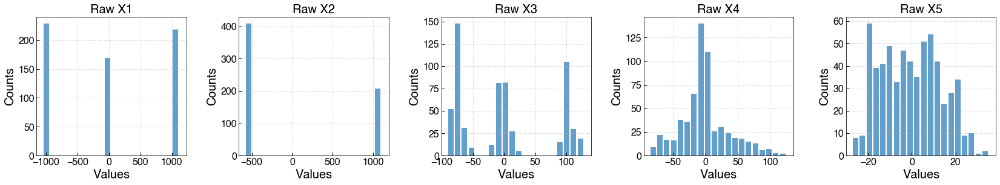

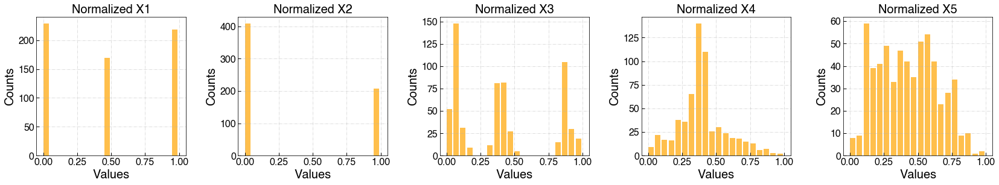

In [24]:
import matplotlib.pyplot as plt
n_plots = 5
fs = 20
# set the font name for a font family
plt.rcParams.update({'font.sans-serif':'Helvetica'})
fig, axes = plt.subplots(1, n_plots, figsize=(5.5*n_plots, 4))

for i in np.arange(n_plots):
    axes[i].hist(np.array(x_pca[:,i]), bins =20,                                                #画hist是为了查看X某个维度(20个里面找一个）的数据分布情况
                 width = 0.04*(np.max(np.array(x_pca[:,i]))-np.min(np.array(x_pca[:,i]))),          #x_pca
                 alpha = 0.7)
    axes[i].tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
    axes[i].grid(True, linestyle='-.')
    axes[i].set_xlabel('Values', fontsize = fs)
    axes[i].set_ylabel('Counts', fontsize = fs)
    axes[i].set_title('Raw X'+str(i+1), fontsize = fs)
# set the spacing between subplots
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.35, 
                    hspace=0.35)
plt.show()

fig, axes = plt.subplots(1, n_plots, figsize=(5.5*n_plots, 4))
fs = 20

for i in np.arange(n_plots):
    axes[i].hist(X_norm[:,i], bins =20, 
                 width = 0.04*(np.max(np.array(X_norm[:,i]))-np.min(np.array(X_norm[:,i]))),        #X_norm
                 alpha = 0.7, color = 'orange')
    axes[i].tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
    axes[i].grid(True, linestyle='-.')
    axes[i].set_xlabel('Values', fontsize = fs)
    axes[i].set_ylabel('Counts', fontsize = fs)
    axes[i].set_title('Normalized X'+str(i+1), fontsize = fs)
# set the spacing between subplots
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.35, 
                    hspace=0.35)
plt.show()      #注意hist count的总和为616

In [25]:
np.random.seed(0)       #固定seed？
num_elements = np.array([len(df_pec.composition[ci]) for ci in np.arange(len(df_pec))]) #提取616行中compsition元素的个数
sel_indx_2elem = (num_elements==2)      
sel_indx_3elem = (num_elements==3)
sel_indx_4elem = (num_elements==4)
X_inp_list = [X_norm[sel_indx_2elem], X_norm[sel_indx_3elem], X_norm[sel_indx_4elem]]
y_outp_list = [y[sel_indx_2elem], y[sel_indx_3elem], y[sel_indx_4elem]]
elem3_indx_random = [np.random.randint(len(X_norm[sel_indx_3elem])) for i in np.arange(20)]
#elem4_indx_random = [np.random.randint(len(X_norm[sel_indx_4elem])) for i in np.arange(20)]
#print('num of samples:', np.sum(sel_indx))


X_train, X_test, y_train, y_test = train_test_split(X_inp_list[1][elem3_indx_random],   #只对num_elements==3的数据进行训练(并且只用其中随机抽取的20个元素)
                                                    y_outp_list[1][elem3_indx_random],  #
                                                    test_size = 0.2)#, random_state=1)

In [ ]:
X_train, X_test  #[16, 20]  [4, 20]


In [ ]:
import GPy 
from GPy.models import GPRegression
## 
ker = GPy.kern.Matern52(input_dim = len(X_train[0]), ARD =True)     #Matern52有啥讲究吗？
ker.lengthscale.constrain_bounded(1e-2, 10)     #超参数？（好像是posterior 得到的）
ker.variance.constrain_bounded(1e-2, 100.0)

gpy_regr = GPRegression(X_train, y_train, ker)#
#gpy_regr.Gaussian_noise.variance = (0.01)**2       #这个一般需要怎么调整呢？（好像是posterior 得到的）
#gpy_regr.Gaussian_noise.variance.fix()

gpy_regr.randomize()
gpy_regr.optimize_restarts(num_restarts=10, verbose =True, messages=False)

# display(gpy_regr)
# GPy.plotting.show(m.plot(), filename='RBF_001')


In [ ]:
print(ker.lengthscale)
print(ker.variance)
print(gpy_regr.Gaussian_noise)

y_pred_train, y_uncer_train= gpy_regr.predict(X_train)
y_pred_test, y_uncer_test = gpy_regr.predict(X_test)

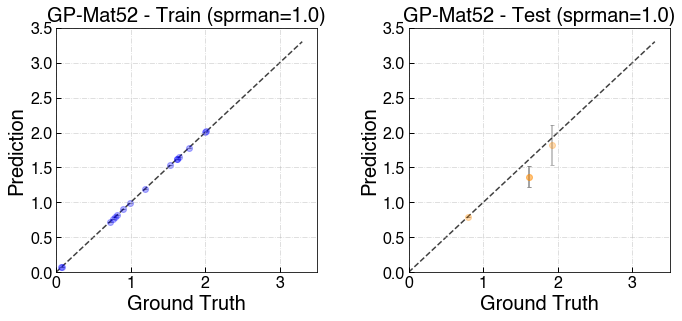

In [27]:
plt_true_vs_pred([y_train, y_test], 
                 [y_pred_train, y_pred_test],[y_uncer_train, y_uncer_test],
                 ['GP-Mat52 - Train','GP-Mat52 - Test'],
                 ['blue', 'darkorange'])

In [28]:
X_val = X_inp_list[2]## 4 Element Dataset
y_val = y_outp_list[2]## 4 Element Dateset

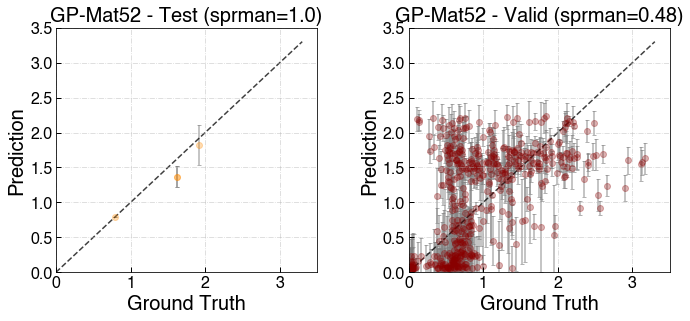

In [29]:
y_pred_val, y_uncer_val = gpy_regr.predict(X_val)
plt_true_vs_pred([y_test, y_val], 
                 [y_pred_test, y_pred_val], [y_uncer_test, y_uncer_val],
                 ['GP-Mat52 - Test','GP-Mat52 - Valid'],
                 ['darkorange', 'darkred'])

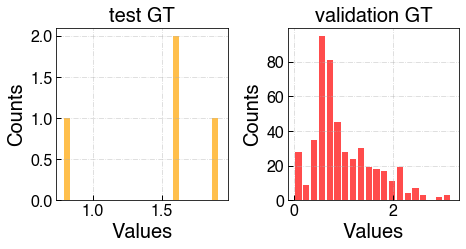

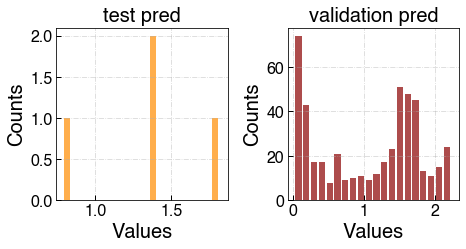

In [30]:
plt.rcParams.update({'font.sans-serif':'Helvetica'})
n_plots = 2
fig, axes = plt.subplots(1, n_plots, figsize=(3.5*n_plots, 3))
y_hist = [y_test, y_val]                                  ####这里是做了一个对比图：为了查看验证集和测试集中pred和ground truth数值的分布情况
color = ['orange', 'red']
hist_labels = ['test GT', 'validation GT']
for i in np.arange(n_plots):
    axes[i].hist(np.array(y_hist[i]), bins =20, 
                 width = 0.04*(np.max(np.array(y_hist[i]))-np.min(np.array(y_hist[i]))), 
                 alpha = 0.7, color = color[i])
    axes[i].tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
    axes[i].grid(True, linestyle='-.')
    axes[i].set_xlabel('Values', fontsize = fs)
    axes[i].set_ylabel('Counts', fontsize = fs)
    axes[i].set_title(hist_labels[i], fontsize = fs)
# set the spacing between subplots
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.35, 
                    hspace=0.35)
plt.show()

plt.rcParams.update({'font.sans-serif':'Helvetica'})
n_plots = 2
fig, axes = plt.subplots(1, n_plots, figsize=(3.5*n_plots, 3))
y_hist = [y_pred_test, y_pred_val]
color = ['darkorange', 'darkred']
hist_labels = ['test pred', 'validation pred']
for i in np.arange(n_plots):
    axes[i].hist(np.array(y_hist[i]), bins =20, 
                 width = 0.04*(np.max(np.array(y_hist[i]))-np.min(np.array(y_hist[i]))), 
                 alpha = 0.7, color = color[i])
    axes[i].tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
    axes[i].grid(True, linestyle='-.')
    axes[i].set_xlabel('Values', fontsize = fs)
    axes[i].set_ylabel('Counts', fontsize = fs)
    axes[i].set_title(hist_labels[i], fontsize = fs)
# set the spacing between subplots
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.35, 
                    hspace=0.35)
plt.show()

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.402559638
Optimization restart 1/3, f = -2.3812688887901317
Optimization restart 2/3, f = -6.061609423757686
Optimization restart 3/3, f = -6.128596170291763
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999992  |   0.01,10.0   |        
  [1]    |                       0.74593425  |   0.01,10.0   |        
  [2]    |                       1.44332328  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                       9.99999874  |   0.01,10.0   |        
  [6]    |                       9.99999971  |   0.01,10.0   |        
  [7]    |                       0.29372388  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       1.15357959  |   0.01,10.0   |        
  [10]   |                      10.0

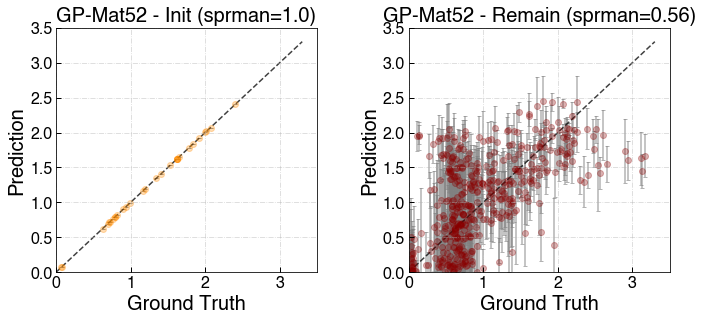

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.402559638
Optimization restart 1/3, f = 18.177696358871646
Optimization restart 2/3, f = 18.177696303775615
Optimization restart 3/3, f = 18.177696293742283
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999962  |   0.01,10.0   |        
  [1]    |                       0.72233730  |   0.01,10.0   |        
  [2]    |                       0.99015877  |   0.01,10.0   |        
  [3]    |                       1.99824997  |   0.01,10.0   |        
  [4]    |                       9.99999994  |   0.01,10.0   |        
  [5]    |                       9.99999974  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       1.14874421  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999998  |   0.01,10.0   |        
  [10]   |                       2.49

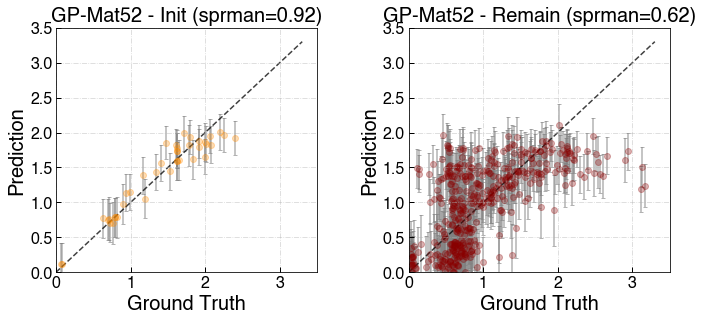

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.47069758
Optimization restart 1/3, f = 31.03844588063282
Optimization restart 2/3, f = 5.540982338073956
Optimization restart 3/3, f = 31.03995277677849
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.03423127  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       9.99999872  |   0.01,10.0   |        
  [4]    |                       9.99999432  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99999913  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.666032

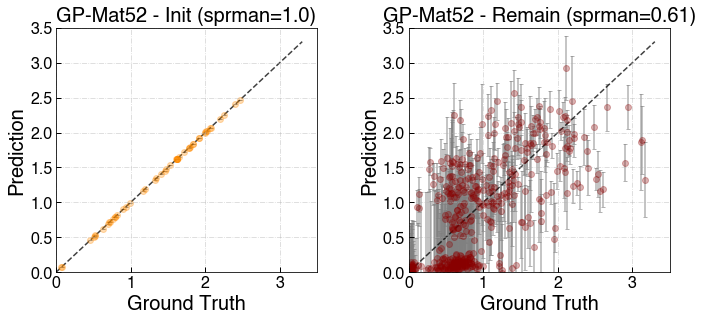

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.659221731
Optimization restart 1/3, f = 38.25506933576935
Optimization restart 2/3, f = 37.3443549235689
Optimization restart 3/3, f = 43.43485871793101
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.62170513  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.33632169  |   0.01,10.0   |        
  [4]    |                       0.48311970  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.14404419  |   0.01,10.0   |        
  [7]    |                       9.99999999  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10.000000

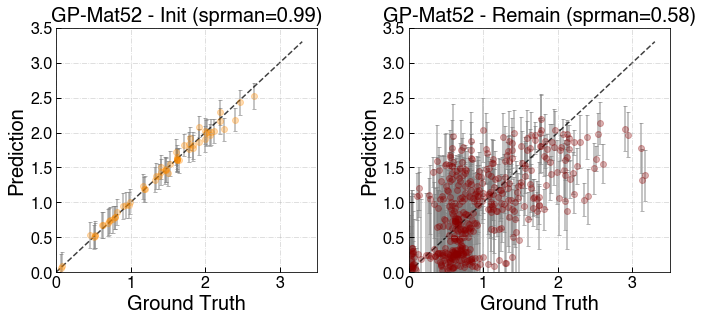

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.901818968
Optimization restart 1/3, f = 46.77006214544361
Optimization restart 2/3, f = 41.05560605240155
Optimization restart 3/3, f = 46.7701827218061
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999302  |   0.01,10.0   |        
  [1]    |                       0.60838231  |   0.01,10.0   |        
  [2]    |                       1.49329888  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99897797  |   0.01,10.0   |        
  [5]    |                       9.99863034  |   0.01,10.0   |        
  [6]    |                       0.39906432  |   0.01,10.0   |        
  [7]    |                       9.99063231  |   0.01,10.0   |        
  [8]    |                       9.99932450  |   0.01,10.0   |        
  [9]    |                       9.99816971  |   0.01,10.0   |        
  [10]   |                       0.381598

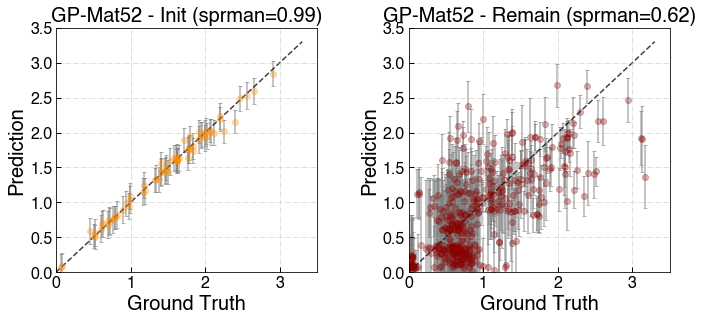

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.943118342
Optimization restart 1/3, f = 63.2604283099789
Optimization restart 2/3, f = 61.83609128089426
Optimization restart 3/3, f = 60.481759685081904
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.60285892  |   0.01,10.0   |        
  [2]    |                       9.99999399  |   0.01,10.0   |        
  [3]    |                       1.00505508  |   0.01,10.0   |        
  [4]    |                       0.43698595  |   0.01,10.0   |        
  [5]    |                       1.84992739  |   0.01,10.0   |        
  [6]    |                       0.14941800  |   0.01,10.0   |        
  [7]    |                       9.99959274  |   0.01,10.0   |        
  [8]    |                       9.99979896  |   0.01,10.0   |        
  [9]    |                       9.99999995  |   0.01,10.0   |        
  [10]   |                       1.27801

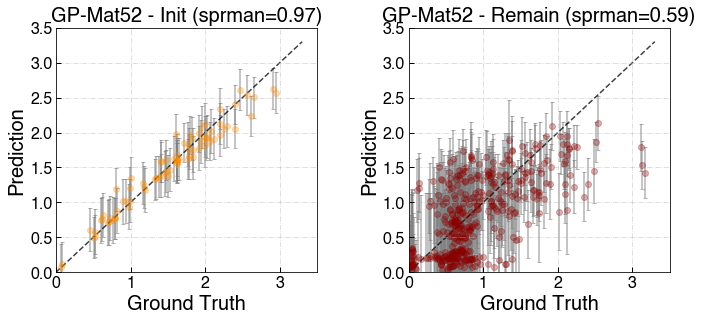

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.943118342
Optimization restart 1/3, f = 59.23618596760013
Optimization restart 2/3, f = 63.29995894640556
Optimization restart 3/3, f = 60.957159226255044
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999249  |   0.01,10.0   |        
  [1]    |                       0.51192775  |   0.01,10.0   |        
  [2]    |                       3.45504455  |   0.01,10.0   |        
  [3]    |                       9.99878672  |   0.01,10.0   |        
  [4]    |                       9.99999843  |   0.01,10.0   |        
  [5]    |                       9.99998340  |   0.01,10.0   |        
  [6]    |                       0.96423285  |   0.01,10.0   |        
  [7]    |                       9.99998172  |   0.01,10.0   |        
  [8]    |                       0.88641873  |   0.01,10.0   |        
  [9]    |                       9.99999733  |   0.01,10.0   |        
  [10]   |                       0.3237

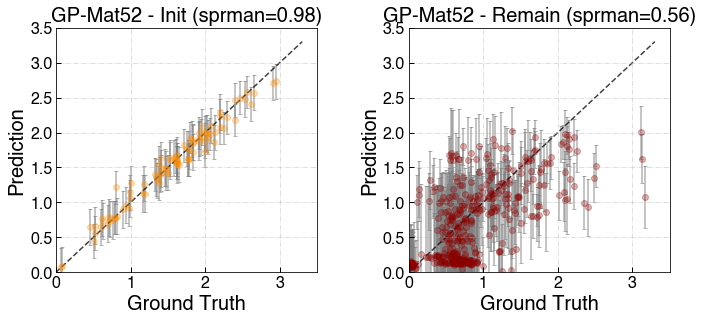

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.112154836
Optimization restart 1/3, f = 69.9962013846584
Optimization restart 2/3, f = 69.9961642165647
Optimization restart 3/3, f = 71.03682296449577
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.65921617  |   0.01,10.0   |        
  [2]    |                       1.84222426  |   0.01,10.0   |        
  [3]    |                       9.99975002  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.67637696  |   0.01,10.0   |        
  [6]    |                       0.41955458  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.98450590  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.1909614

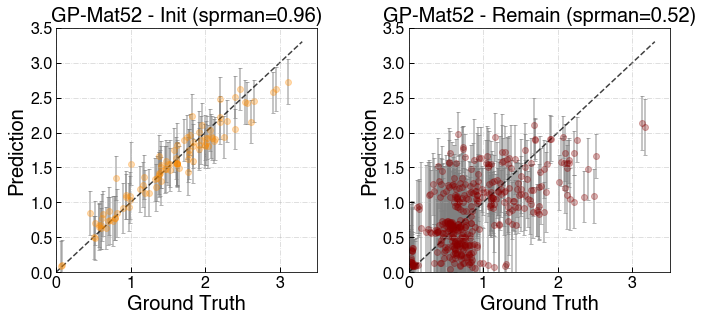

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 81.06459125854332
Optimization restart 2/3, f = 81.92526552799302
Optimization restart 3/3, f = 81.23458900746678
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.68651689  |   0.01,10.0   |        
  [2]    |                       0.95996683  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       1.17352404  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.59147022  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.90115848  |   0.01,10.0   |        
  [10]   |                       0.65328

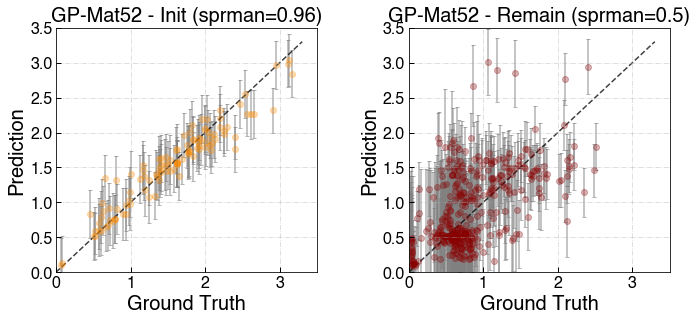

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 88.01211509550261
Optimization restart 2/3, f = 88.01181644375595
Optimization restart 3/3, f = 88.8282708908695
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99992123  |   0.01,10.0   |        
  [1]    |                       0.76695262  |   0.01,10.0   |        
  [2]    |                       1.47437542  |   0.01,10.0   |        
  [3]    |                       2.16130458  |   0.01,10.0   |        
  [4]    |                       9.95141055  |   0.01,10.0   |        
  [5]    |                       9.87116010  |   0.01,10.0   |        
  [6]    |                       0.22822482  |   0.01,10.0   |        
  [7]    |                       4.46294603  |   0.01,10.0   |        
  [8]    |                       9.99168745  |   0.01,10.0   |        
  [9]    |                       2.14325110  |   0.01,10.0   |        
  [10]   |                       0.231160

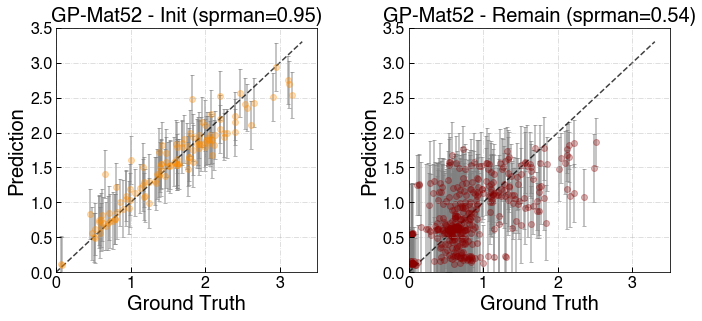

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 96.60024413448092
Optimization restart 2/3, f = 95.48118052511863
Optimization restart 3/3, f = 96.09730496786057
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.60836595  |   0.01,10.0   |        
  [2]    |                       0.78192679  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.47143213  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99986656  |   0.01,10.0   |        
  [9]    |                       1.07760266  |   0.01,10.0   |        
  [10]   |                       0.34061

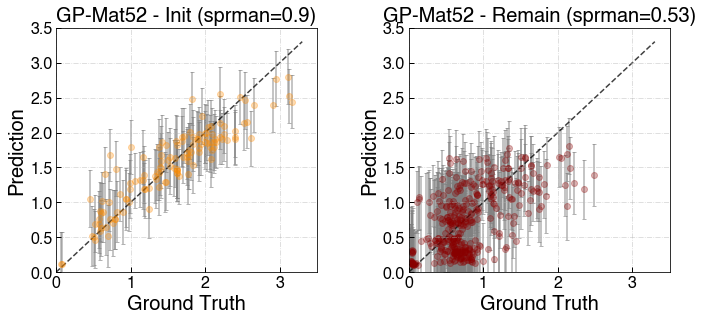

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 101.51959727408176
Optimization restart 2/3, f = 101.51959004509348
Optimization restart 3/3, f = 101.38206358642917
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.63649052  |   0.01,10.0   |        
  [2]    |                       0.81015720  |   0.01,10.0   |        
  [3]    |                       1.70619468  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.38531558  |   0.01,10.0   |        
  [7]    |                       9.99999978  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       1.35458172  |   0.01,10.0   |        
  [10]   |                       0.35

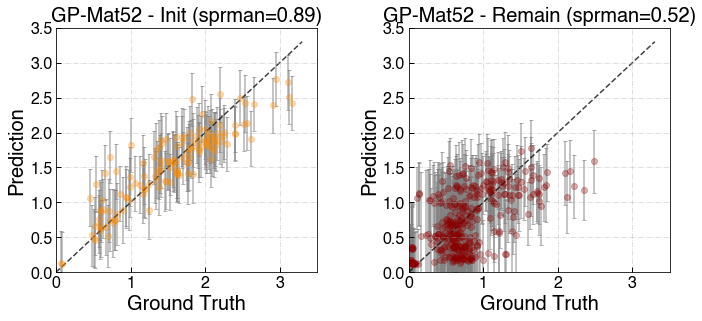

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 105.04104672160469
Optimization restart 2/3, f = 106.73299659443208
Optimization restart 3/3, f = 104.87717846655976
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99815929  |   0.01,10.0   |        
  [1]    |                       0.54624481  |   0.01,10.0   |        
  [2]    |                       1.22673200  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99921326  |   0.01,10.0   |        
  [5]    |                       0.25298502  |   0.01,10.0   |        
  [6]    |                       0.97311562  |   0.01,10.0   |        
  [7]    |                       9.96753092  |   0.01,10.0   |        
  [8]    |                       2.71498941  |   0.01,10.0   |        
  [9]    |                       0.87333838  |   0.01,10.0   |        
  [10]   |                       0.51

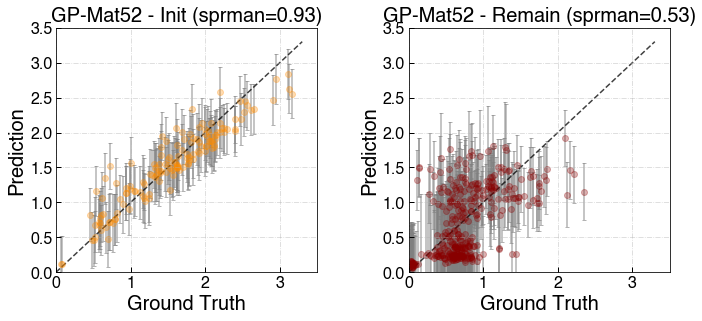

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 113.5405602044359
Optimization restart 2/3, f = 113.81363482770527
Optimization restart 3/3, f = 111.62177531076675
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99998907  |   0.01,10.0   |        
  [1]    |                       0.52396851  |   0.01,10.0   |        
  [2]    |                       0.94996594  |   0.01,10.0   |        
  [3]    |                       9.98561797  |   0.01,10.0   |        
  [4]    |                       9.99240246  |   0.01,10.0   |        
  [5]    |                       0.40312256  |   0.01,10.0   |        
  [6]    |                       9.99497378  |   0.01,10.0   |        
  [7]    |                       9.97659072  |   0.01,10.0   |        
  [8]    |                       1.34648974  |   0.01,10.0   |        
  [9]    |                       0.99451708  |   0.01,10.0   |        
  [10]   |                       1.812

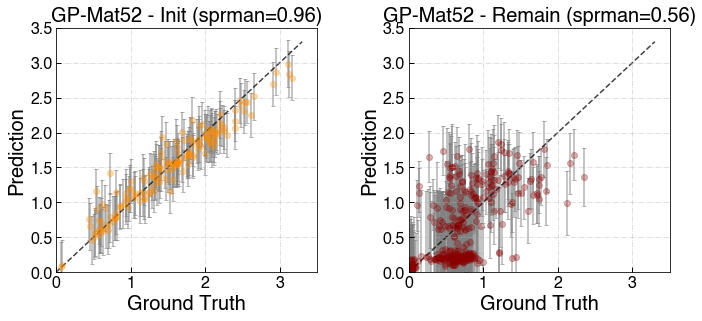

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 115.65717070722252
Optimization restart 2/3, f = 115.65717130342006
Optimization restart 3/3, f = 115.65717083556552
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.55768957  |   0.01,10.0   |        
  [2]    |                       0.87382918  |   0.01,10.0   |        
  [3]    |                       1.08255893  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.57136415  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.19395315  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.45

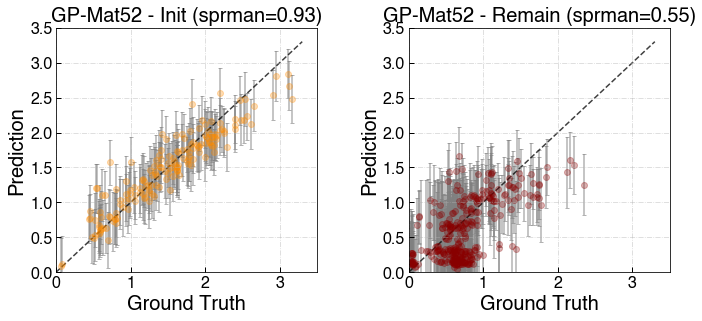

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 127.43348323930257
Optimization restart 2/3, f = 128.5159569326176
Optimization restart 3/3, f = 129.82092943623013
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.52867400  |   0.01,10.0   |        
  [2]    |                       0.73962145  |   0.01,10.0   |        
  [3]    |                       1.43761982  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.76637292  |   0.01,10.0   |        
  [7]    |                       5.54877032  |   0.01,10.0   |        
  [8]    |                       1.27731679  |   0.01,10.0   |        
  [9]    |                       2.17992468  |   0.01,10.0   |        
  [10]   |                       0.580

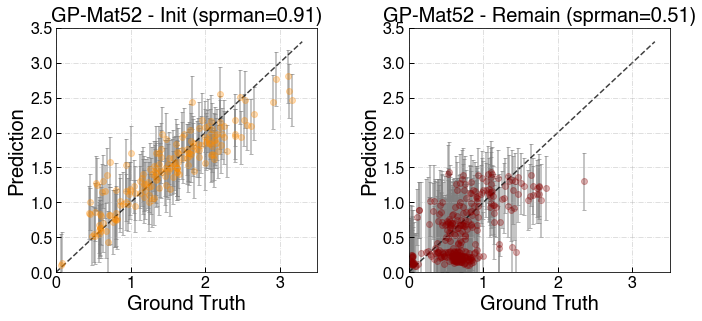

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 133.14994106556227
Optimization restart 2/3, f = 133.14990567074793
Optimization restart 3/3, f = 140.18739435271158
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.52317697  |   0.01,10.0   |        
  [2]    |                       1.13506304  |   0.01,10.0   |        
  [3]    |                       1.20232698  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999998  |   0.01,10.0   |        
  [6]    |                       0.78299563  |   0.01,10.0   |        
  [7]    |                       9.99999991  |   0.01,10.0   |        
  [8]    |                       0.68778620  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.53

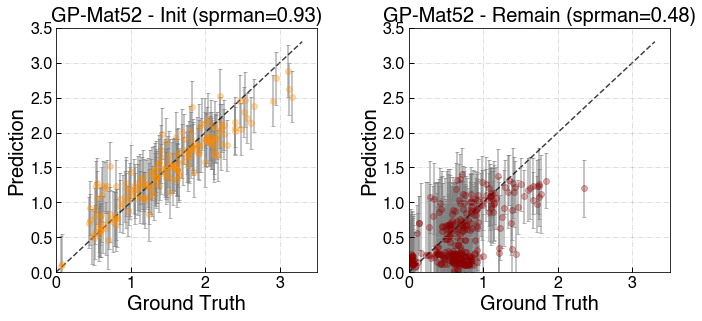

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 142.70203735581055
Optimization restart 2/3, f = 142.70260181309897
Optimization restart 3/3, f = 142.9104019775575
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.40657107  |   0.01,10.0   |        
  [1]    |                       0.75248440  |   0.01,10.0   |        
  [2]    |                       1.04822659  |   0.01,10.0   |        
  [3]    |                       1.28034698  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.98899374  |   0.01,10.0   |        
  [6]    |                       9.99829457  |   0.01,10.0   |        
  [7]    |                       0.64727840  |   0.01,10.0   |        
  [8]    |                       0.61531169  |   0.01,10.0   |        
  [9]    |                       0.39752630  |   0.01,10.0   |        
  [10]   |                       9.849

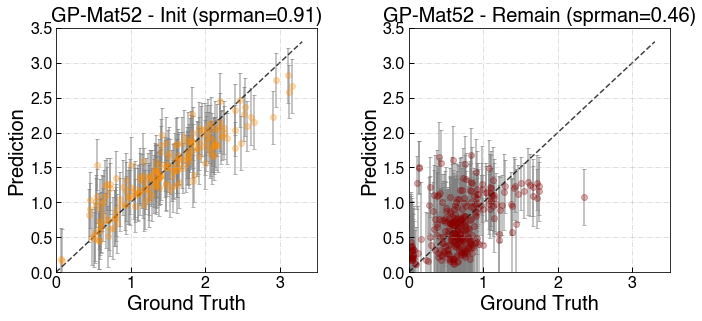

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 141.8395161171018
Optimization restart 2/3, f = 141.83952244101891
Optimization restart 3/3, f = 141.8395192393664
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999986  |   0.01,10.0   |        
  [1]    |                       0.46667887  |   0.01,10.0   |        
  [2]    |                       1.30247061  |   0.01,10.0   |        
  [3]    |                       0.74396402  |   0.01,10.0   |        
  [4]    |                       9.99999824  |   0.01,10.0   |        
  [5]    |                       9.99999984  |   0.01,10.0   |        
  [6]    |                       1.24079411  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99999961  |   0.01,10.0   |        
  [9]    |                       0.39843286  |   0.01,10.0   |        
  [10]   |                       0.5166

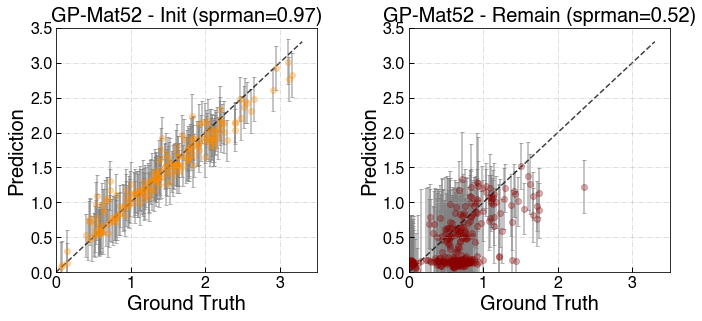

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  3.168620841
Optimization restart 1/3, f = 149.74956592073343
Optimization restart 2/3, f = 149.05020603880052
Optimization restart 3/3, f = 148.17120282067214
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.47361524  |   0.01,10.0   |        
  [2]    |                       1.48777843  |   0.01,10.0   |        
  [3]    |                       0.77338806  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99876092  |   0.01,10.0   |        
  [6]    |                       1.12666743  |   0.01,10.0   |        
  [7]    |                       9.99997959  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.43904631  |   0.01,10.0   |        
  [10]   |                       0.51

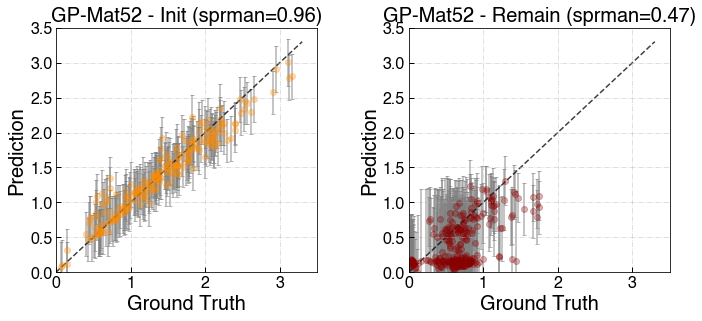

In [31]:
elem4_indx_random = [np.random.randint(len(X_val)) for i in np.arange(10)]
X_val_init = X_val[elem4_indx_random]
y_val_init = y_val[elem4_indx_random]
X_init = np.concatenate([X_train, X_test, X_val_init])      #从elem4中挑选一部分（10个）数据参与model训练
y_init = np.concatenate([y_train, y_test, y_val_init])
X_remain = np.delete(X_val,elem4_indx_random, 0)
y_remain = np.delete(y_val,elem4_indx_random, 0)
len(y_remain)

for it in np.arange(20):
    print("highest power so far: ", np.max(y_init))

    ker = GPy.kern.Matern52(input_dim = len(X_init[0]), ARD =True)#
    ker.lengthscale.constrain_bounded(1e-2, 10)
    ker.variance.constrain_bounded(1e-2, 100.0)

    gpy_regr = GPRegression(X_init, y_init, ker)#
    #gpy_regr.Gaussian_noise.variance = (0.01)**2
    #gpy_regr.Gaussian_noise.variance.fix()
    gpy_regr.randomize()
    gpy_regr.optimize_restarts(num_restarts=3,verbose =True, messages=False)
    print(ker.lengthscale)
    print(ker.variance)
    print(gpy_regr.Gaussian_noise)


    y_pred_init, y_uncer_init= gpy_regr.predict(X_init)
    y_pred_remain, y_uncer_remain = gpy_regr.predict(X_remain)          #测试剩余的elem4元素的预测情况
    plt_true_vs_pred([y_init, y_remain], 
                     [y_pred_init, y_pred_remain], [y_uncer_init, y_uncer_remain],
                     ['GP-Mat52 - Init','GP-Mat52 - Remain'],
                     ['darkorange', 'darkred'])
    ucb = np.sqrt(y_uncer_remain)+y_pred_remain             ##
    top_ucb_indx = np.argsort(ucb[:,-1])[-10:]
    X_new = X_remain[top_ucb_indx]
    y_new = y_remain[top_ucb_indx]

    X_init = np.concatenate([X_init, X_new])
    y_init = np.concatenate([y_init, y_new])
    X_remain = np.delete(X_remain,top_ucb_indx, 0)
    y_remain = np.delete(y_remain,top_ucb_indx, 0)


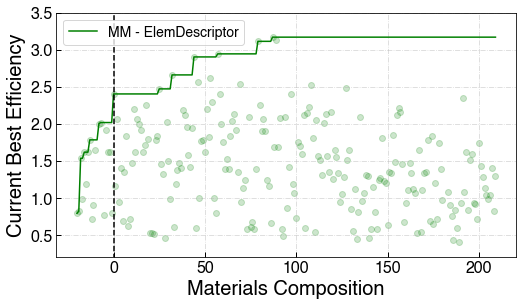

In [32]:
fig, axes = plt.subplots(1, 1, figsize=(5.5*1.5, 4.5), sharey = False)
fs = 20
ax = axes
ax.plot(np.arange(len(y_init))-len(np.concatenate([X_train, X_test])),
        np.maximum.accumulate(y_init), c = 'green', label = 'MM - ElemDescriptor')
ax.scatter(np.arange(len(y_init))-len(np.concatenate([X_train, X_test])),y_init, c = 'green',alpha = 0.2)

ax.plot(np.zeros(10),np.arange(10)/2-1, '--',c = 'black')
ax.set_ylabel('Current Best Efficiency', fontsize = 20)
ax.set_xlabel('Materials Composition', fontsize = 20)

ax.set_ylim(0.2, 3.5)
#axes[0].set_xlim(-1, 105)
#axes[0].set_xticks(np.arange(0,105,10))
ax.legend(fontsize = fs*0.7)
ax.tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
ax.grid(True, linestyle='-.')

plt.show()

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


highest power so far:  2.143900577
Optimization restart 1/3, f = -13.144071449460585
Optimization restart 2/3, f = -12.370943814877185
Optimization restart 3/3, f = -11.345015066626969
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.01134265  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       0.85531158  |   0.01,10.0   |        
  [5]    |                       1.38609109  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.95978237  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10

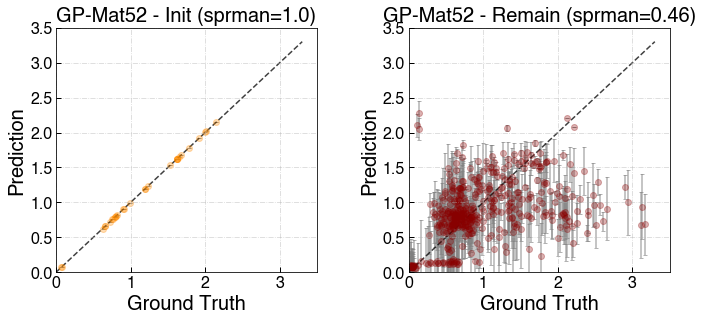

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  2.21988867
Optimization restart 1/3, f = 20.237080581787055
Optimization restart 2/3, f = 4.248523473826896
Optimization restart 3/3, f = 4.166704890478101
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.02015959  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       9.99992494  |   0.01,10.0   |        
  [4]    |                       0.28427057  |   0.01,10.0   |        
  [5]    |                       9.99993342  |   0.01,10.0   |        
  [6]    |                       9.99984195  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.18749419  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       9.99

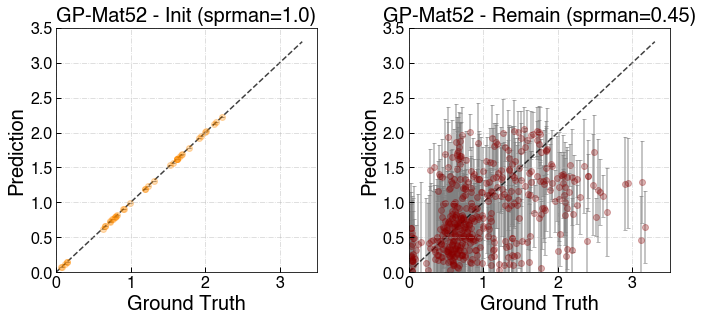

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  2.21988867
Optimization restart 1/3, f = 28.692211369487428
Optimization restart 2/3, f = 28.692211288474578
Optimization restart 3/3, f = 6.904915290605732
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.60211093  |   0.01,10.0   |        
  [1]    |                      10.00000000  |   0.01,10.0   |        
  [2]    |                       2.18463025  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.96580870  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       9.9

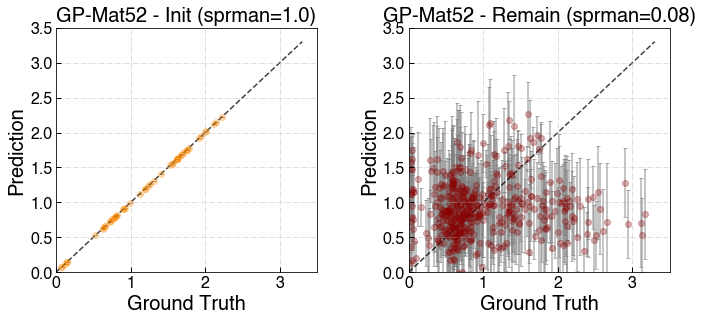

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  2.21988867
Optimization restart 1/3, f = 35.10549491830299
Optimization restart 2/3, f = 35.105494994568915
Optimization restart 3/3, f = 26.611884396894194
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.52795121  |   0.01,10.0   |        
  [1]    |                      10.00000000  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       0.10844135  |   0.01,10.0   |        
  [5]    |                       0.83210800  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.52967634  |   0.01,10.0   |        
  [9]    |                       0.58948558  |   0.01,10.0   |        
  [10]   |                      10.0

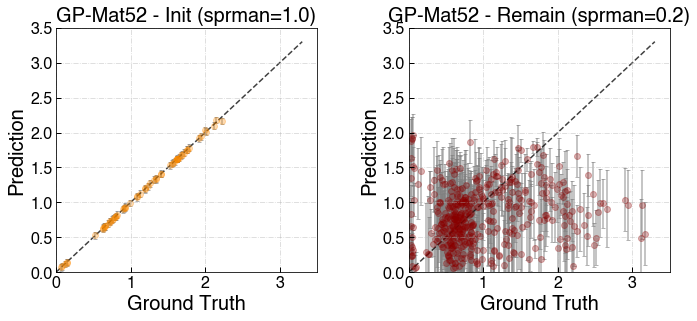

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  2.256901448
Optimization restart 1/3, f = 40.93883179145105
Optimization restart 2/3, f = 39.134082403162566
Optimization restart 3/3, f = 40.94463670669157
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.85024734  |   0.01,10.0   |        
  [2]    |                       2.78656081  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.73614589  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.22615949  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.2

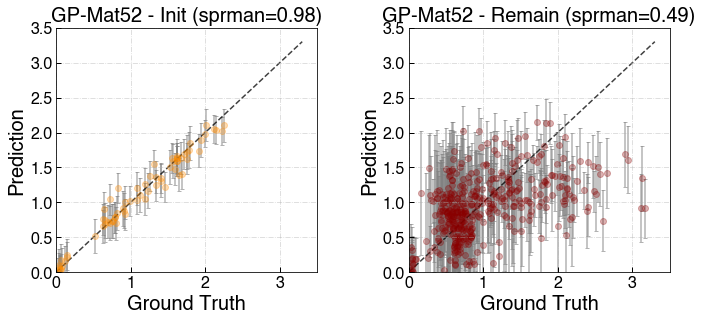

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  2.256901448
Optimization restart 1/3, f = 43.73774033256109
Optimization restart 2/3, f = 49.12002672624226
Optimization restart 3/3, f = 50.169386527500706
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.67052391  |   0.01,10.0   |        
  [2]    |                       2.31062298  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99975866  |   0.01,10.0   |        
  [7]    |                       9.99999929  |   0.01,10.0   |        
  [8]    |                       9.99997307  |   0.01,10.0   |        
  [9]    |                       0.27445569  |   0.01,10.0   |        
  [10]   |                       0.3

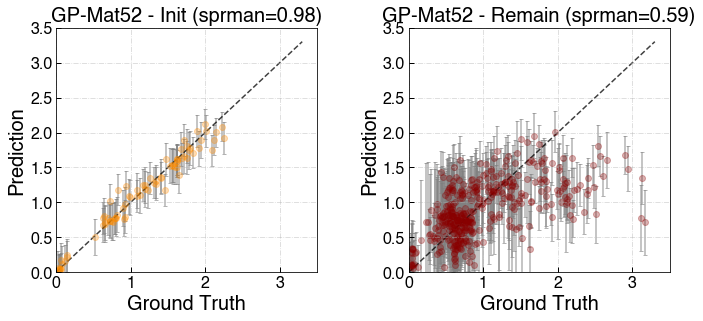

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  2.659221731
Optimization restart 1/3, f = 50.089389975536996
Optimization restart 2/3, f = 50.11514678633044
Optimization restart 3/3, f = 53.877334908567285
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.64274904  |   0.01,10.0   |        
  [2]    |                       2.91209486  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99996891  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       2.19907408  |   0.01,10.0   |        
  [7]    |                       9.99991559  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.

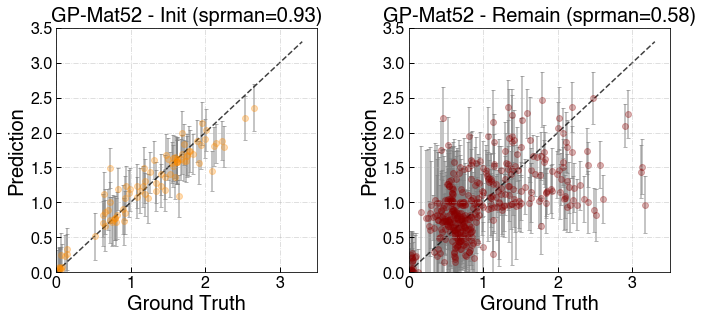

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  2.659221731
Optimization restart 1/3, f = 58.00253790904416
Optimization restart 2/3, f = 66.83462167055713
Optimization restart 3/3, f = 58.00252760074591
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.88880184  |   0.01,10.0   |        
  [2]    |                       5.04242215  |   0.01,10.0   |        
  [3]    |                       9.99997496  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99898688  |   0.01,10.0   |        
  [6]    |                       0.80240174  |   0.01,10.0   |        
  [7]    |                       2.28070400  |   0.01,10.0   |        
  [8]    |                       2.20284305  |   0.01,10.0   |        
  [9]    |                       9.99999656  |   0.01,10.0   |        
  [10]   |                       0.4

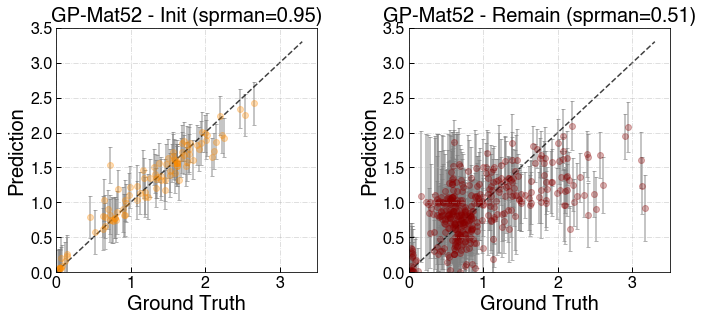

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  2.943118342
Optimization restart 1/3, f = 64.67621578340805
Optimization restart 2/3, f = 64.67731552546078
Optimization restart 3/3, f = 72.9229105711475
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.53646031  |   0.01,10.0   |        
  [2]    |                       9.99928507  |   0.01,10.0   |        
  [3]    |                       1.64421566  |   0.01,10.0   |        
  [4]    |                       9.99999334  |   0.01,10.0   |        
  [5]    |                       9.99967486  |   0.01,10.0   |        
  [6]    |                       9.99222434  |   0.01,10.0   |        
  [7]    |                       9.99937562  |   0.01,10.0   |        
  [8]    |                       9.99855587  |   0.01,10.0   |        
  [9]    |                       0.36848824  |   0.01,10.0   |        
  [10]   |                       0.31

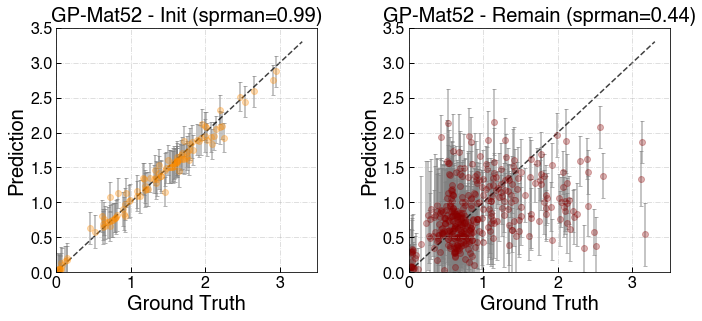

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  2.943118342
Optimization restart 1/3, f = 49.631362464341464
Optimization restart 2/3, f = 75.10595425465225
Optimization restart 3/3, f = 77.68017425608176
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.46501856  |   0.01,10.0   |        
  [1]    |                       0.53598042  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       9.97943534  |   0.01,10.0   |        
  [4]    |                       9.99999563  |   0.01,10.0   |        
  [5]    |                       9.87219013  |   0.01,10.0   |        
  [6]    |                       1.29498102  |   0.01,10.0   |        
  [7]    |                       9.93603791  |   0.01,10.0   |        
  [8]    |                       0.26866991  |   0.01,10.0   |        
  [9]    |                       9.78891888  |   0.01,10.0   |        
  [10]   |                       0.

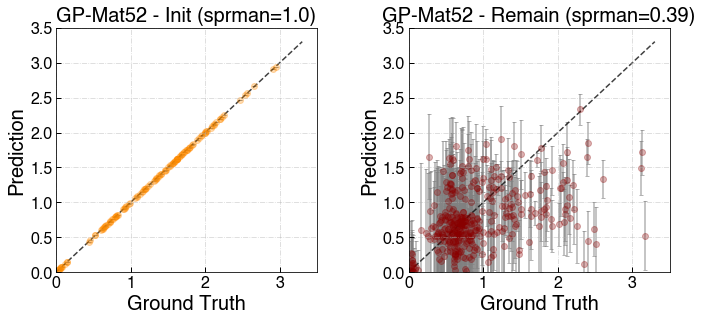

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  2.943118342
Optimization restart 1/3, f = 76.85609323870528
Optimization restart 2/3, f = 76.58327574542707
Optimization restart 3/3, f = 75.99817376019753
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999833  |   0.01,10.0   |        
  [1]    |                       0.91077205  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       9.99726981  |   0.01,10.0   |        
  [4]    |                       0.14320121  |   0.01,10.0   |        
  [5]    |                       0.76365498  |   0.01,10.0   |        
  [6]    |                       9.98930858  |   0.01,10.0   |        
  [7]    |                       0.44713151  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.95226767  |   0.01,10.0   |        
  [10]   |                       1.4

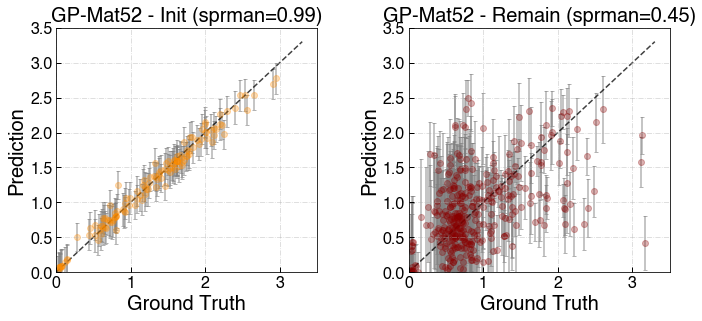

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  2.943118342
Optimization restart 1/3, f = 85.70415040931567
Optimization restart 2/3, f = 82.62313320647353
Optimization restart 3/3, f = 88.39416523601994
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.91663002  |   0.01,10.0   |        
  [1]    |                       0.61080386  |   0.01,10.0   |        
  [2]    |                       1.67144372  |   0.01,10.0   |        
  [3]    |                       9.99025867  |   0.01,10.0   |        
  [4]    |                       9.98479170  |   0.01,10.0   |        
  [5]    |                       9.84001793  |   0.01,10.0   |        
  [6]    |                       0.60594760  |   0.01,10.0   |        
  [7]    |                       9.87343358  |   0.01,10.0   |        
  [8]    |                       9.99521686  |   0.01,10.0   |        
  [9]    |                       0.30111200  |   0.01,10.0   |        
  [10]   |                       0.3

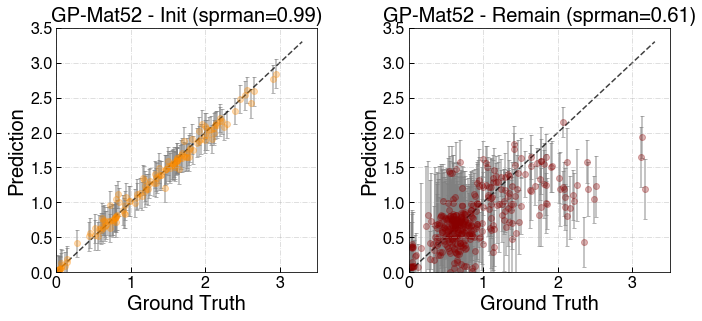

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.128147799
Optimization restart 1/3, f = 76.49682289961282
Optimization restart 2/3, f = 95.50004046624363
Optimization restart 3/3, f = 95.1001514594525
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999498  |   0.01,10.0   |        
  [1]    |                       0.60487581  |   0.01,10.0   |        
  [2]    |                       1.10071077  |   0.01,10.0   |        
  [3]    |                       0.79562846  |   0.01,10.0   |        
  [4]    |                       9.99768290  |   0.01,10.0   |        
  [5]    |                       9.99739208  |   0.01,10.0   |        
  [6]    |                       0.54234050  |   0.01,10.0   |        
  [7]    |                       9.93834116  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.25952871  |   0.01,10.0   |        
  [10]   |                       0.24

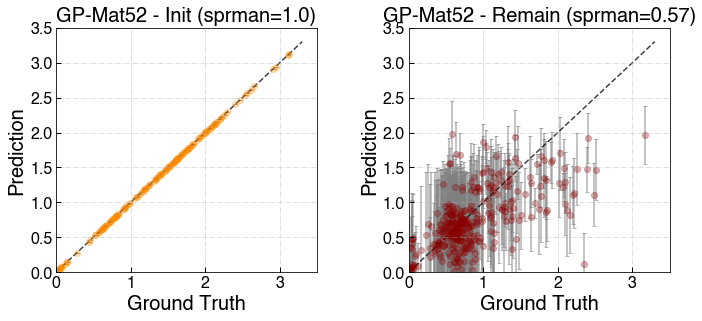

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 117.81548459605337
Optimization restart 2/3, f = 108.55235988990546
Optimization restart 3/3, f = 112.60578273764995
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99354043  |   0.01,10.0   |        
  [1]    |                       0.67944521  |   0.01,10.0   |        
  [2]    |                       1.42546294  |   0.01,10.0   |        
  [3]    |                       9.99935280  |   0.01,10.0   |        
  [4]    |                       9.99753872  |   0.01,10.0   |        
  [5]    |                       9.99861272  |   0.01,10.0   |        
  [6]    |                       0.79739174  |   0.01,10.0   |        
  [7]    |                       9.99659561  |   0.01,10.0   |        
  [8]    |                       9.99990448  |   0.01,10.0   |        
  [9]    |                       0.35992740  |   0.01,10.0   |        
  [10]   |                       

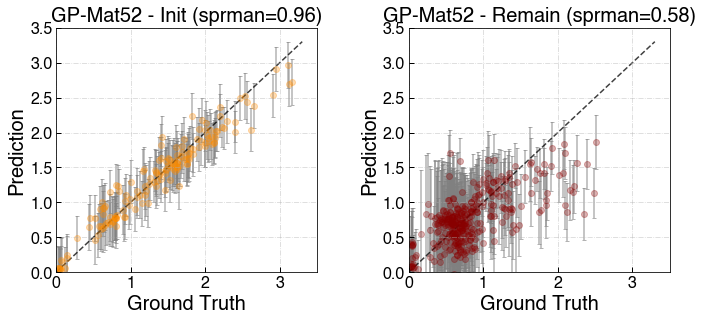

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 125.26938882181487
Optimization restart 2/3, f = 118.67696006703048
Optimization restart 3/3, f = 123.19200037058175
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.73499567  |   0.01,10.0   |        
  [2]    |                       1.34178835  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.62513978  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.87776506  |   0.01,10.0   |        
  [10]   |                       

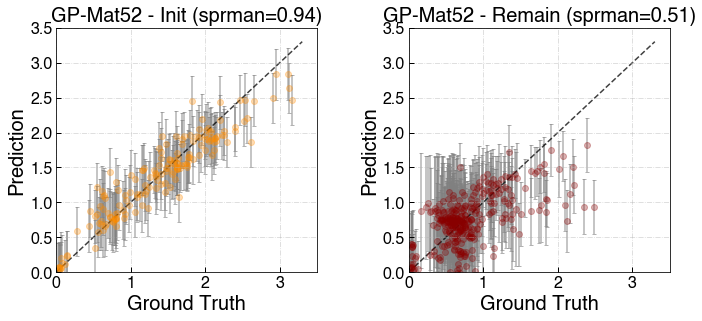

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 125.02494712086926
Optimization restart 2/3, f = 124.66702426547499
Optimization restart 3/3, f = 124.66709514794692
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999988  |   0.01,10.0   |        
  [1]    |                       0.74830383  |   0.01,10.0   |        
  [2]    |                       1.31559488  |   0.01,10.0   |        
  [3]    |                       1.08843062  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99989363  |   0.01,10.0   |        
  [6]    |                       0.58162133  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.30327076  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

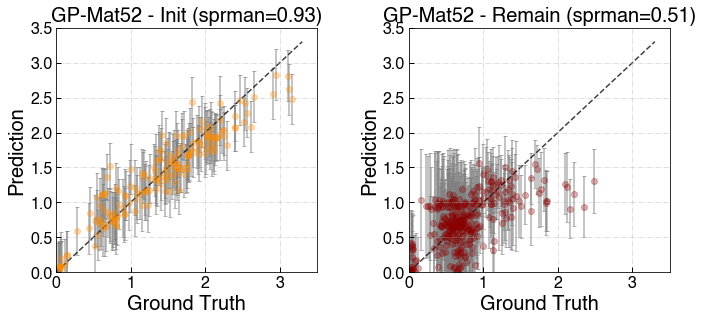

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 128.24784219666014
Optimization restart 2/3, f = 128.24784203135803
Optimization restart 3/3, f = 135.10478009734848
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.82665470  |   0.01,10.0   |        
  [2]    |                       1.28222158  |   0.01,10.0   |        
  [3]    |                       9.99893952  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.63910608  |   0.01,10.0   |        
  [6]    |                       0.48520489  |   0.01,10.0   |        
  [7]    |                       9.99911965  |   0.01,10.0   |        
  [8]    |                       1.43795968  |   0.01,10.0   |        
  [9]    |                       9.99999989  |   0.01,10.0   |        
  [10]   |                       

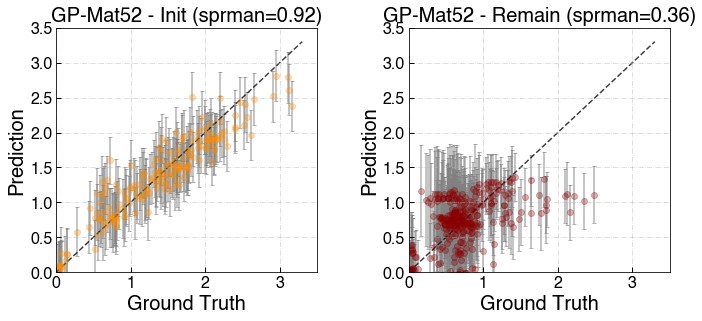

200
highest power so far:  3.168620841


reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


Optimization restart 1/3, f = 132.22716798193218
Optimization restart 2/3, f = 132.2283528671901
Optimization restart 3/3, f = 136.42574310095324
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.70175297  |   0.01,10.0   |        
  [2]    |                       1.24409433  |   0.01,10.0   |        
  [3]    |                       9.99739456  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.59733083  |   0.01,10.0   |        
  [6]    |                       0.49387533  |   0.01,10.0   |        
  [7]    |                       9.99936374  |   0.01,10.0   |        
  [8]    |                       1.41584206  |   0.01,10.0   |        
  [9]    |                       9.80086130  |   0.01,10.0   |        
  [10]   |                       0.37433997  |   0.01,10.0   |        
  

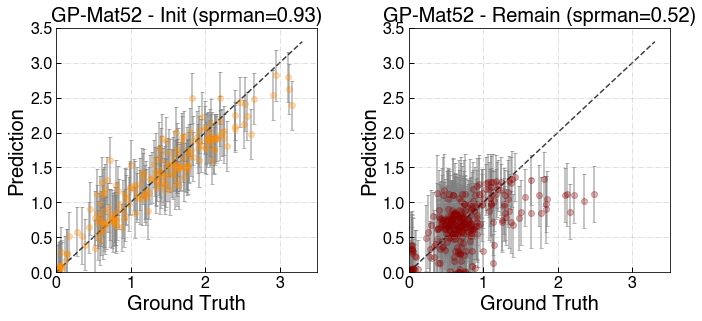

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 138.03004825822168
Optimization restart 2/3, f = 134.52846223467887
Optimization restart 3/3, f = 134.52787670869623
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.87775450  |   0.01,10.0   |        
  [2]    |                       1.33630832  |   0.01,10.0   |        
  [3]    |                       1.43103453  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99855150  |   0.01,10.0   |        
  [6]    |                       0.56365277  |   0.01,10.0   |        
  [7]    |                       9.99957575  |   0.01,10.0   |        
  [8]    |                       1.36364258  |   0.01,10.0   |        
  [9]    |                       9.99693382  |   0.01,10.0   |        
  [10]   |                       

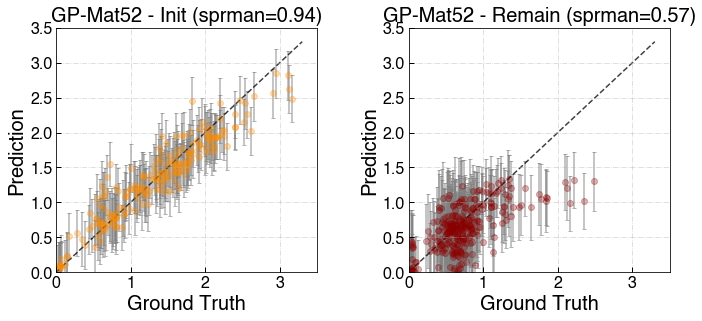

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 141.28050625457436
Optimization restart 2/3, f = 141.28051886679125
Optimization restart 3/3, f = 141.24070390578035
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999968  |   0.01,10.0   |        
  [1]    |                       0.85196202  |   0.01,10.0   |        
  [2]    |                       1.09975747  |   0.01,10.0   |        
  [3]    |                       0.73996775  |   0.01,10.0   |        
  [4]    |                       9.99999998  |   0.01,10.0   |        
  [5]    |                       1.96563362  |   0.01,10.0   |        
  [6]    |                       0.72534565  |   0.01,10.0   |        
  [7]    |                       9.98374054  |   0.01,10.0   |        
  [8]    |                       1.71772493  |   0.01,10.0   |        
  [9]    |                       1.18717869  |   0.01,10.0   |        
  [10]   |                       

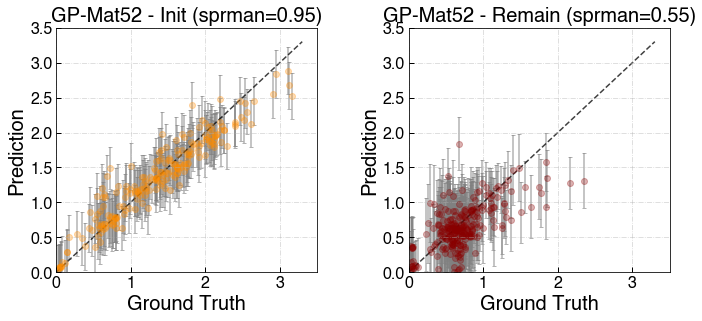

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.016576623
Optimization restart 1/3, f = -11.425652928308118
Optimization restart 2/3, f = -11.747326004491402
Optimization restart 3/3, f = -11.531678630439028
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999984  |   0.01,10.0   |        
  [1]    |                       0.78792859  |   0.01,10.0   |        
  [2]    |                       9.99973654  |   0.01,10.0   |        
  [3]    |                       9.99943981  |   0.01,10.0   |        
  [4]    |                       9.99976281  |   0.01,10.0   |        
  [5]    |                       9.99995022  |   0.01,10.0   |        
  [6]    |                       9.99998285  |   0.01,10.0   |        
  [7]    |                       1.27011443  |   0.01,10.0   |        
  [8]    |                       9.97447168  |   0.01,10.0   |        
  [9]    |                       2.74769080  |   0.01,10.0   |        
  [10]   |                    

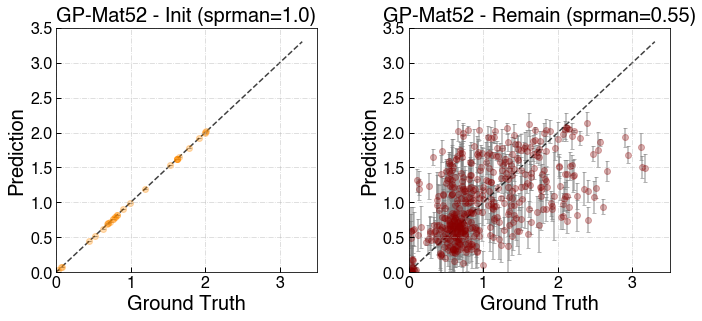

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  2.396775316
Optimization restart 1/3, f = 26.5844517199494
Optimization restart 2/3, f = 26.584451682013032
Optimization restart 3/3, f = 26.584452060805916
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.73306642  |   0.01,10.0   |        
  [1]    |                       0.46247919  |   0.01,10.0   |        
  [2]    |                       9.99999997  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99997975  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       9.99995543  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999999  |   0.01,10.0   |        
  [10]   |                       2.3

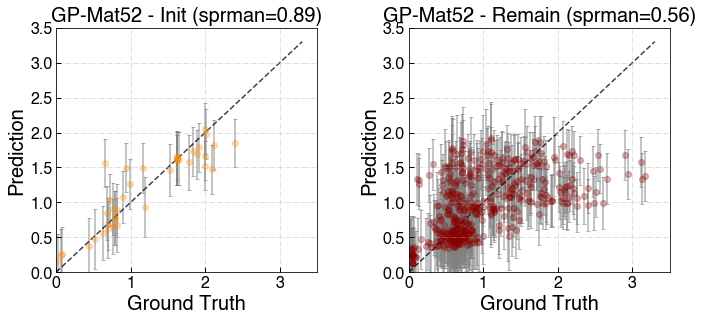

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  2.396775316
Optimization restart 1/3, f = 29.010555373655485
Optimization restart 2/3, f = 29.89806043989363
Optimization restart 3/3, f = 29.01063443802819
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.54026429  |   0.01,10.0   |        
  [1]    |                       0.45724295  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       2.04610502  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99940161  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       2.88642482  |   0.01,10.0   |        
  [9]    |                       2.86272245  |   0.01,10.0   |        
  [10]   |                       1.8

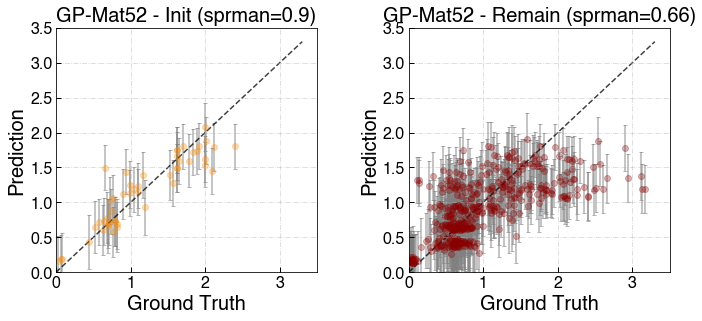

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  2.901818968
Optimization restart 1/3, f = 35.39960907661285
Optimization restart 2/3, f = 35.39960929537004
Optimization restart 3/3, f = 36.096402262622654
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.93056547  |   0.01,10.0   |        
  [1]    |                       0.69235986  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.50606498  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       1.18115713  |   0.01,10.0   |        
  [8]    |                       3.30758390  |   0.01,10.0   |        
  [9]    |                       9.99998915  |   0.01,10.0   |        
  [10]   |                       1.3

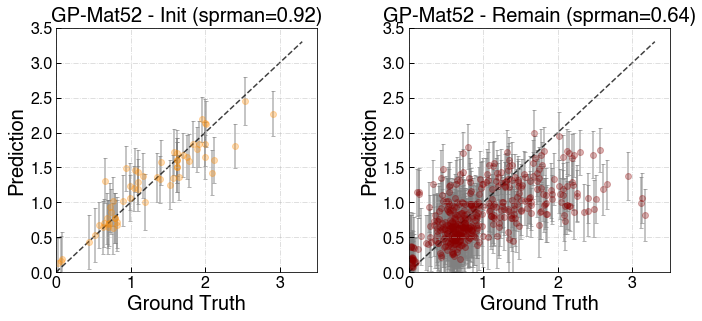

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  2.901818968
Optimization restart 1/3, f = 47.22229148293361
Optimization restart 2/3, f = 47.22811130535776
Optimization restart 3/3, f = 47.21058669804672
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.37660355  |   0.01,10.0   |        
  [1]    |                       0.56715207  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.72131410  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                       9.99999991  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       1.68273951  |   0.01,10.0   |        
  [8]    |                       2.20260445  |   0.01,10.0   |        
  [9]    |                       9.99999997  |   0.01,10.0   |        
  [10]   |                       1.29

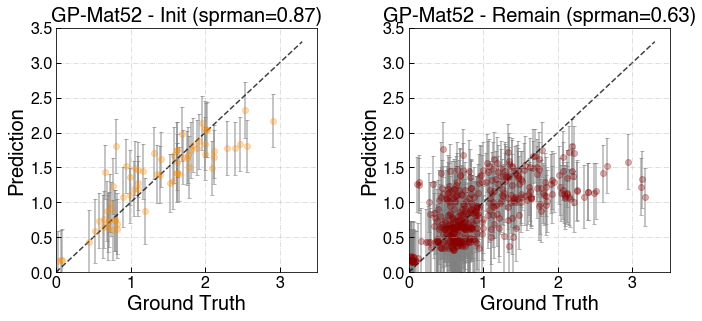

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  2.901818968
Optimization restart 1/3, f = 58.22945035821406
Optimization restart 2/3, f = 58.22065676410754
Optimization restart 3/3, f = 58.220656890215
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.11625876  |   0.01,10.0   |        
  [1]    |                       0.60734834  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.50055818  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       1.48196830  |   0.01,10.0   |        
  [8]    |                       2.29294269  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.4030

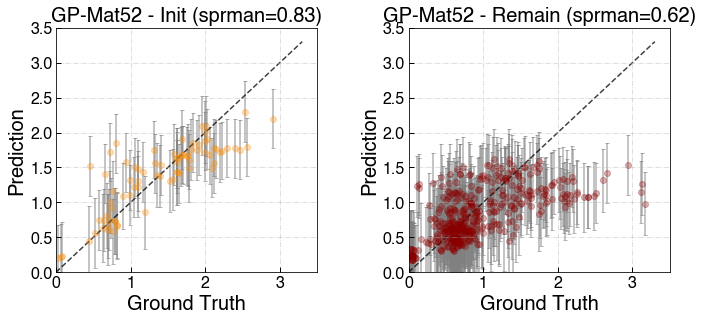

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  2.943118342
Optimization restart 1/3, f = 62.111884918856
Optimization restart 2/3, f = 61.24897770706055
Optimization restart 3/3, f = 61.88312486757952
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999812  |   0.01,10.0   |        
  [1]    |                       0.73183243  |   0.01,10.0   |        
  [2]    |                       0.91521253  |   0.01,10.0   |        
  [3]    |                       1.55128421  |   0.01,10.0   |        
  [4]    |                       9.99999990  |   0.01,10.0   |        
  [5]    |                       9.99998734  |   0.01,10.0   |        
  [6]    |                       9.99999999  |   0.01,10.0   |        
  [7]    |                       0.63895451  |   0.01,10.0   |        
  [8]    |                       2.54648961  |   0.01,10.0   |        
  [9]    |                       9.99999973  |   0.01,10.0   |        
  [10]   |                       1.1580

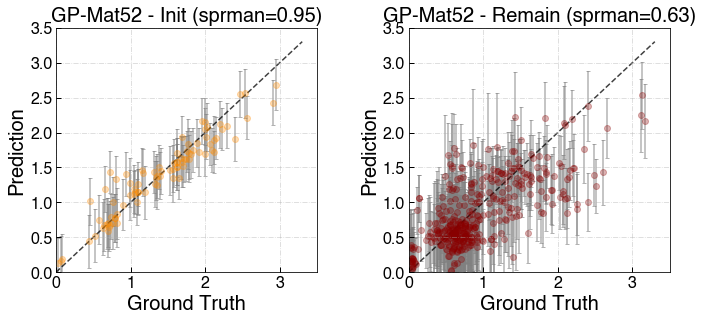

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.168620841
Optimization restart 1/3, f = 73.27060401166732
Optimization restart 2/3, f = 74.35282323380893
Optimization restart 3/3, f = 73.397398198189
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.93663152  |   0.01,10.0   |        
  [1]    |                       0.76231881  |   0.01,10.0   |        
  [2]    |                       9.99034481  |   0.01,10.0   |        
  [3]    |                       1.15842076  |   0.01,10.0   |        
  [4]    |                       9.99999134  |   0.01,10.0   |        
  [5]    |                       9.96630546  |   0.01,10.0   |        
  [6]    |                       9.95880622  |   0.01,10.0   |        
  [7]    |                       0.48551267  |   0.01,10.0   |        
  [8]    |                       1.56647085  |   0.01,10.0   |        
  [9]    |                       9.98099014  |   0.01,10.0   |        
  [10]   |                       1.320

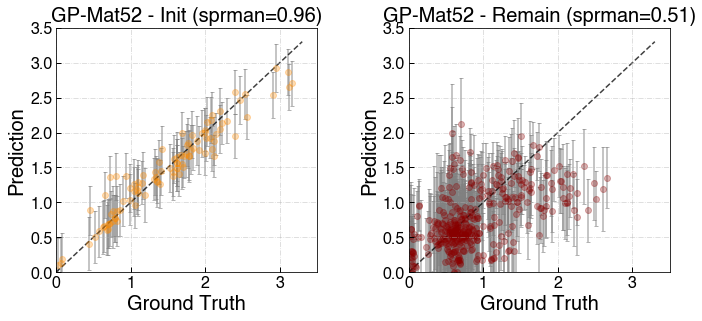

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 79.07851876172559
Optimization restart 2/3, f = 79.1592352543245
Optimization restart 3/3, f = 78.20735991594023
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.10462341  |   0.01,10.0   |        
  [1]    |                       0.73686784  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.08996909  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       1.11803386  |   0.01,10.0   |        
  [7]    |                       0.49298489  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.17

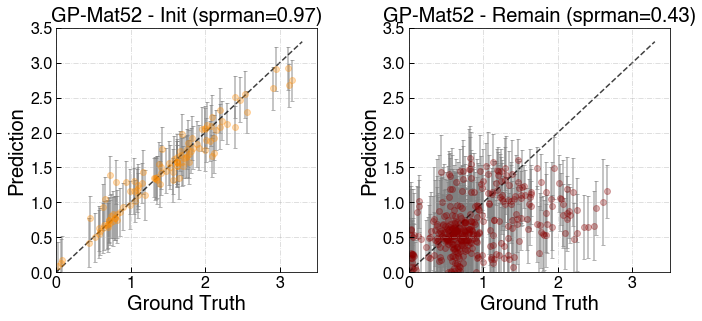

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 84.99255684302263
Optimization restart 2/3, f = 84.99255549897893
Optimization restart 3/3, f = 83.8538410680031
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.58821964  |   0.01,10.0   |        
  [2]    |                       1.40400167  |   0.01,10.0   |        
  [3]    |                       1.70920508  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.44037016  |   0.01,10.0   |        
  [6]    |                       0.48048703  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.90622477  |   0.01,10.0   |        
  [10]   |                       0.37

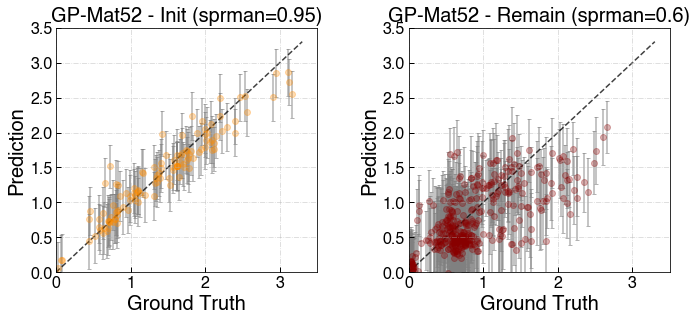

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 96.56736053639537
Optimization restart 2/3, f = 97.0690816604021
Optimization restart 3/3, f = 96.2980319079687
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.88401291  |   0.01,10.0   |        
  [1]    |                       0.51419965  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.22790124  |   0.01,10.0   |        
  [4]    |                       9.99970960  |   0.01,10.0   |        
  [5]    |                       9.99999879  |   0.01,10.0   |        
  [6]    |                       1.11486538  |   0.01,10.0   |        
  [7]    |                       1.59669953  |   0.01,10.0   |        
  [8]    |                       9.99999773  |   0.01,10.0   |        
  [9]    |                       0.85610270  |   0.01,10.0   |        
  [10]   |                       0.727

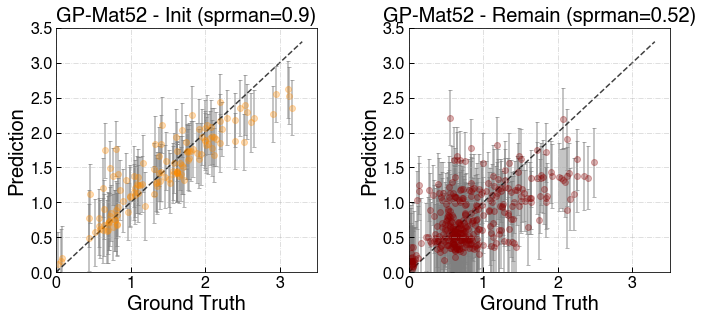

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 103.21415245808552
Optimization restart 2/3, f = 103.2141525986764
Optimization restart 3/3, f = 104.44786727037526
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.51597993  |   0.01,10.0   |        
  [2]    |                       0.78046639  |   0.01,10.0   |        
  [3]    |                       0.60126386  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.71372343  |   0.01,10.0   |        
  [6]    |                       0.62594523  |   0.01,10.0   |        
  [7]    |                       9.99985834  |   0.01,10.0   |        
  [8]    |                       1.27321932  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

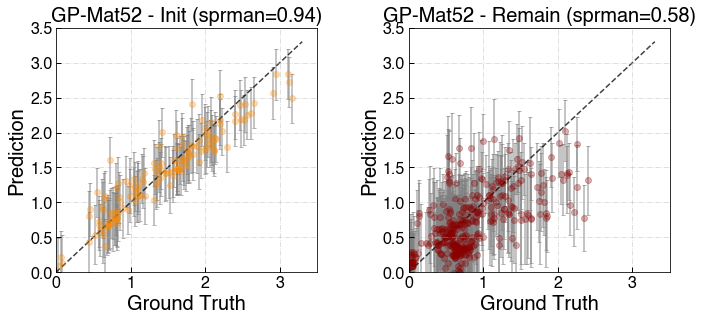

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 111.97818094212178
Optimization restart 2/3, f = 113.82500502157711
Optimization restart 3/3, f = 115.51346791193787
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999944  |   0.01,10.0   |        
  [1]    |                       0.70978754  |   0.01,10.0   |        
  [2]    |                       0.78707142  |   0.01,10.0   |        
  [3]    |                       0.99372014  |   0.01,10.0   |        
  [4]    |                       9.99993379  |   0.01,10.0   |        
  [5]    |                       0.70946166  |   0.01,10.0   |        
  [6]    |                       1.27159191  |   0.01,10.0   |        
  [7]    |                       9.99423516  |   0.01,10.0   |        
  [8]    |                       1.07645771  |   0.01,10.0   |        
  [9]    |                       1.43262269  |   0.01,10.0   |        
  [10]   |                       

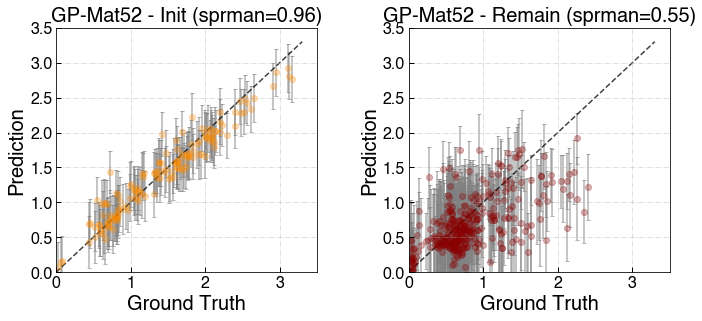

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 118.2049660524219
Optimization restart 2/3, f = 119.51977175591762
Optimization restart 3/3, f = 117.93417981423447
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99989204  |   0.01,10.0   |        
  [1]    |                       0.64853061  |   0.01,10.0   |        
  [2]    |                       0.81967567  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99596516  |   0.01,10.0   |        
  [5]    |                       0.43679630  |   0.01,10.0   |        
  [6]    |                       2.15704896  |   0.01,10.0   |        
  [7]    |                       9.99998142  |   0.01,10.0   |        
  [8]    |                       9.99987464  |   0.01,10.0   |        
  [9]    |                       0.78638665  |   0.01,10.0   |        
  [10]   |                       0

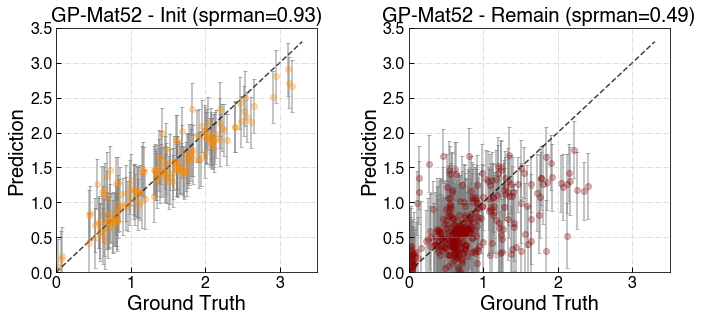

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 122.44679623169394
Optimization restart 2/3, f = 122.4112677312442
Optimization restart 3/3, f = 122.41107454722167
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.98807395  |   0.01,10.0   |        
  [1]    |                       0.56707249  |   0.01,10.0   |        
  [2]    |                       0.70672832  |   0.01,10.0   |        
  [3]    |                       1.32303271  |   0.01,10.0   |        
  [4]    |                       9.99798294  |   0.01,10.0   |        
  [5]    |                       1.84641143  |   0.01,10.0   |        
  [6]    |                       2.32245692  |   0.01,10.0   |        
  [7]    |                       9.91144915  |   0.01,10.0   |        
  [8]    |                       9.96985256  |   0.01,10.0   |        
  [9]    |                       0.93838842  |   0.01,10.0   |        
  [10]   |                       0

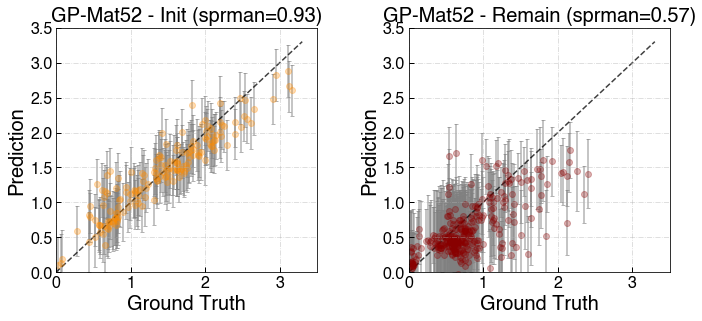

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 132.55495962331037
Optimization restart 2/3, f = 130.3081743545073
Optimization restart 3/3, f = 130.30817422456468
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.51648155  |   0.01,10.0   |        
  [2]    |                       0.91583436  |   0.01,10.0   |        
  [3]    |                       0.77638084  |   0.01,10.0   |        
  [4]    |                       9.99999997  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.39688419  |   0.01,10.0   |        
  [7]    |                       9.99975873  |   0.01,10.0   |        
  [8]    |                       9.99999239  |   0.01,10.0   |        
  [9]    |                       0.75796777  |   0.01,10.0   |        
  [10]   |                       0

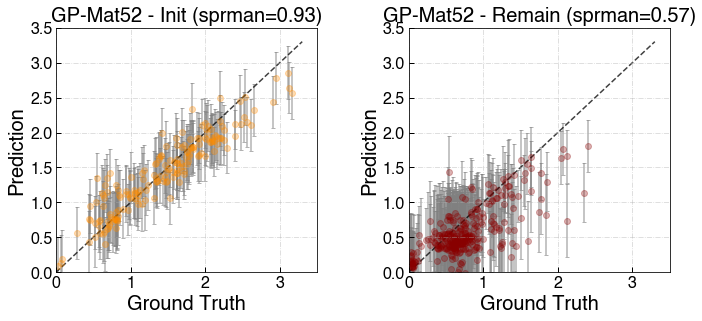

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 134.49990030523682
Optimization restart 2/3, f = 134.49989913647502
Optimization restart 3/3, f = 134.4998989146622
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999875  |   0.01,10.0   |        
  [1]    |                       0.58158813  |   0.01,10.0   |        
  [2]    |                       1.09299848  |   0.01,10.0   |        
  [3]    |                       1.03588035  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99974643  |   0.01,10.0   |        
  [6]    |                       1.25923424  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.82137951  |   0.01,10.0   |        
  [9]    |                       9.99999947  |   0.01,10.0   |        
  [10]   |                       0

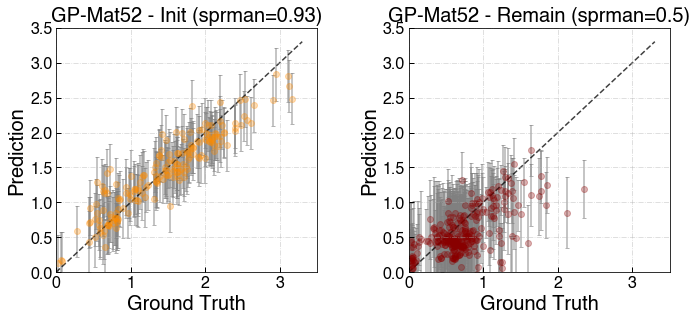

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 137.14056970988838
Optimization restart 2/3, f = 137.13026359835726
Optimization restart 3/3, f = 137.13026318084695
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999973  |   0.01,10.0   |        
  [1]    |                       0.02705455  |   0.01,10.0   |        
  [2]    |                       1.09081617  |   0.01,10.0   |        
  [3]    |                       1.03590431  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.31696477  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.71564307  |   0.01,10.0   |        
  [10]   |                       

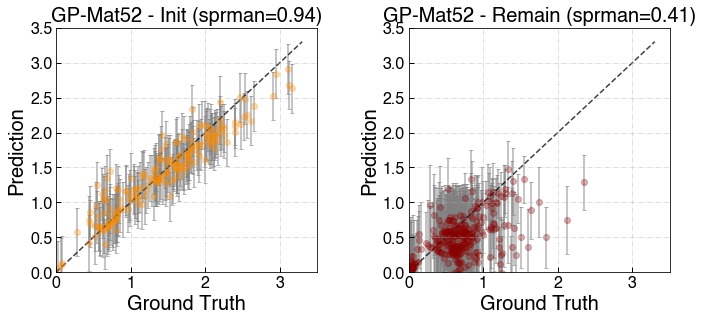

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 143.74877525429562
Optimization restart 2/3, f = 143.95245067541498
Optimization restart 3/3, f = 143.74876246936333
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.57537230  |   0.01,10.0   |        
  [2]    |                       1.41463486  |   0.01,10.0   |        
  [3]    |                       1.01333903  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.83040976  |   0.01,10.0   |        
  [6]    |                       1.13692371  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.96055876  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

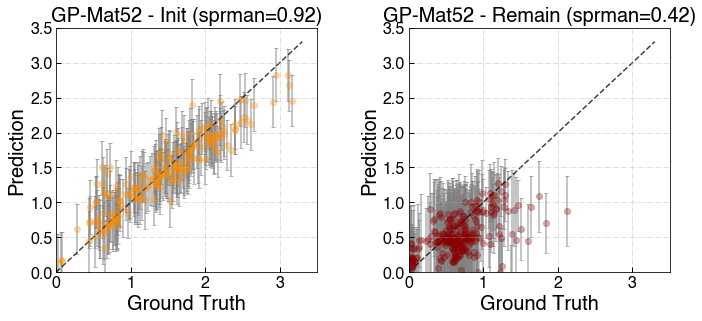

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 145.73245376996528
Optimization restart 2/3, f = 145.72745732650492
Optimization restart 3/3, f = 145.73240659260387
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.56163339  |   0.01,10.0   |        
  [2]    |                       1.40147152  |   0.01,10.0   |        
  [3]    |                       1.02979009  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99952134  |   0.01,10.0   |        
  [6]    |                       1.08568421  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.97729896  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

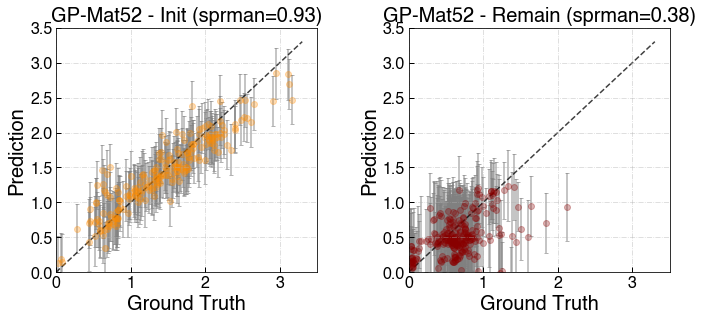

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.090292303
Optimization restart 1/3, f = -7.459291806775912
Optimization restart 2/3, f = -6.762786710281221
Optimization restart 3/3, f = -6.762809892155067
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999998  |   0.01,10.0   |        
  [1]    |                       0.45024877  |   0.01,10.0   |        
  [2]    |                       1.76262969  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       1.37307897  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99997669  |   0.01,10.0   |        
  [7]    |                       9.99973127  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999999  |   0.01,10.0   |        
  [10]   |                      1

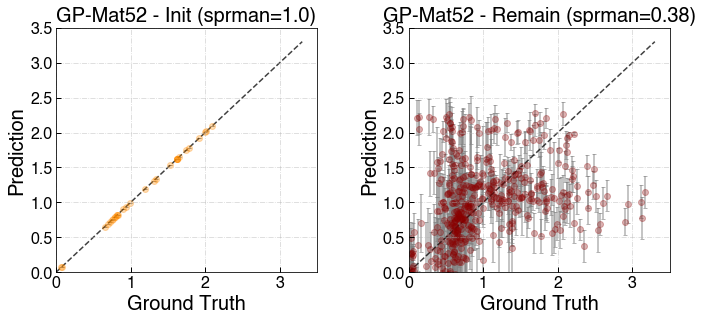

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  2.090292303
Optimization restart 1/3, f = 17.4896490300962
Optimization restart 2/3, f = 17.645657322149788
Optimization restart 3/3, f = 17.645657274596545
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.48787696  |   0.01,10.0   |        
  [1]    |                       1.04596289  |   0.01,10.0   |        
  [2]    |                       2.65733672  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       2.20515184  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99995689  |   0.01,10.0   |        
  [9]    |                       2.95849662  |   0.01,10.0   |        
  [10]   |                       0.2

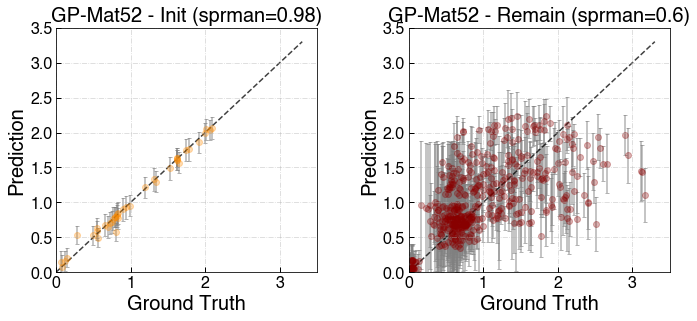

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  2.126151659
Optimization restart 1/3, f = 18.67013844369621
Optimization restart 2/3, f = 18.663966742439882
Optimization restart 3/3, f = 18.663939754718626
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.56297975  |   0.01,10.0   |        
  [1]    |                       1.04164708  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       9.99999509  |   0.01,10.0   |        
  [4]    |                       1.04890142  |   0.01,10.0   |        
  [5]    |                       9.99994188  |   0.01,10.0   |        
  [6]    |                       9.99999663  |   0.01,10.0   |        
  [7]    |                       9.99999939  |   0.01,10.0   |        
  [8]    |                       1.64685579  |   0.01,10.0   |        
  [9]    |                       4.69830261  |   0.01,10.0   |        
  [10]   |                       0.

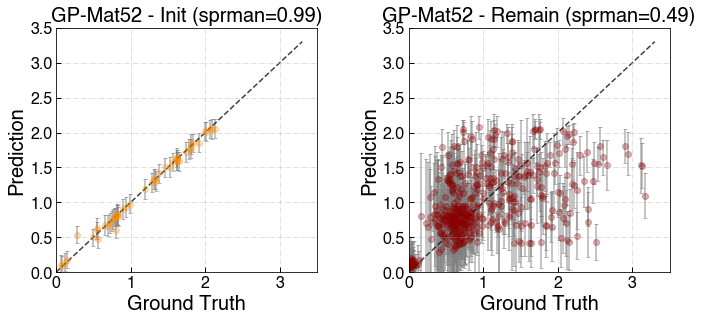

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  2.126151659
Optimization restart 1/3, f = 29.29175482206339
Optimization restart 2/3, f = 29.29175472109942
Optimization restart 3/3, f = 29.291755299887324
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.77915526  |   0.01,10.0   |        
  [2]    |                       1.42986470  |   0.01,10.0   |        
  [3]    |                       9.99988856  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       4.43080818  |   0.01,10.0   |        
  [7]    |                       9.99999913  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.5

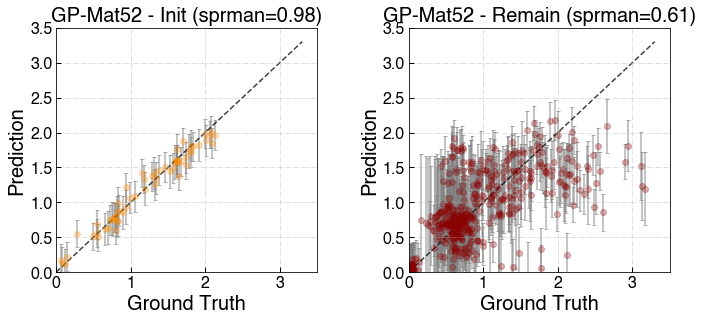

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  2.943118342
Optimization restart 1/3, f = 38.216450951893904
Optimization restart 2/3, f = 37.959643659092784
Optimization restart 3/3, f = 37.95358176683099
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99998973  |   0.01,10.0   |        
  [1]    |                       0.65010707  |   0.01,10.0   |        
  [2]    |                       0.89096320  |   0.01,10.0   |        
  [3]    |                       9.99999741  |   0.01,10.0   |        
  [4]    |                       9.99986123  |   0.01,10.0   |        
  [5]    |                       9.99467858  |   0.01,10.0   |        
  [6]    |                       9.96865560  |   0.01,10.0   |        
  [7]    |                       9.99997754  |   0.01,10.0   |        
  [8]    |                       5.51398780  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.

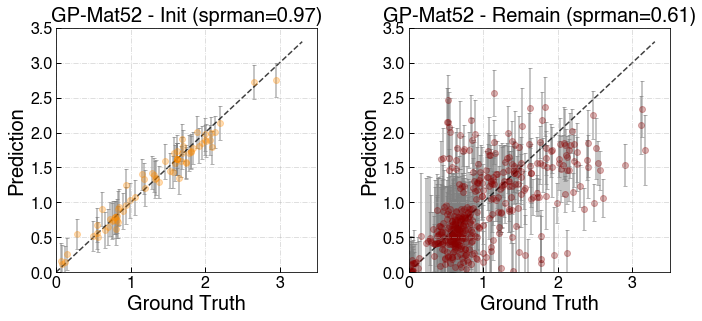

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  3.128147799
Optimization restart 1/3, f = 50.219041312406056
Optimization restart 2/3, f = 49.950774251783535
Optimization restart 3/3, f = 50.126567132748576
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.75746669  |   0.01,10.0   |        
  [2]    |                       0.97295572  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999945  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.92342651  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       6.26044491  |   0.01,10.0   |        
  [9]    |                       9.99986981  |   0.01,10.0   |        
  [10]   |                       0

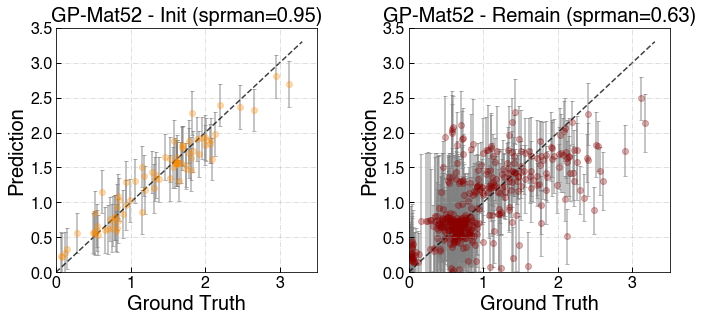

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  3.168620841
Optimization restart 1/3, f = 62.05624929333292
Optimization restart 2/3, f = 63.31645316447192
Optimization restart 3/3, f = 62.05623759541268
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.76730532  |   0.01,10.0   |        
  [2]    |                       1.19007327  |   0.01,10.0   |        
  [3]    |                       9.99859613  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999997  |   0.01,10.0   |        
  [6]    |                       0.45600522  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999996  |   0.01,10.0   |        
  [10]   |                       0.42

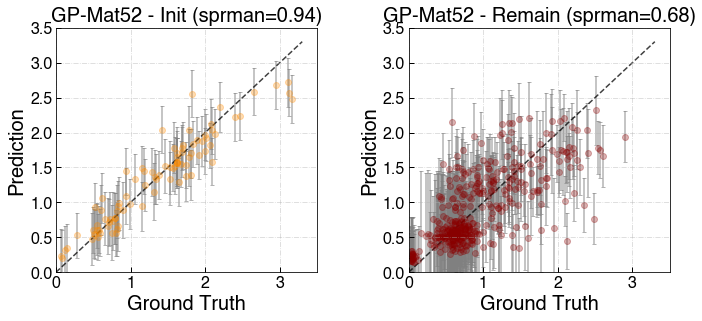

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.168620841
Optimization restart 1/3, f = 67.17249476062563
Optimization restart 2/3, f = 67.29381000504358
Optimization restart 3/3, f = 67.29376482821486
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.79640151  |   0.01,10.0   |        
  [2]    |                       1.11952488  |   0.01,10.0   |        
  [3]    |                       9.99999996  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.51351997  |   0.01,10.0   |        
  [6]    |                       1.13932481  |   0.01,10.0   |        
  [7]    |                       9.99999825  |   0.01,10.0   |        
  [8]    |                       9.99998251  |   0.01,10.0   |        
  [9]    |                       0.66729345  |   0.01,10.0   |        
  [10]   |                       0.3

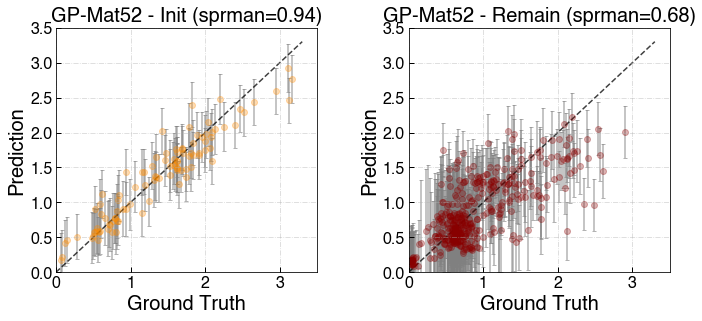

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 72.91923791160511
Optimization restart 2/3, f = 72.63234582701503
Optimization restart 3/3, f = 72.91919680545452
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.82645184  |   0.01,10.0   |        
  [2]    |                       1.63984234  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.56995240  |   0.01,10.0   |        
  [6]    |                       0.87740929  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.67306991  |   0.01,10.0   |        
  [10]   |                       0.3

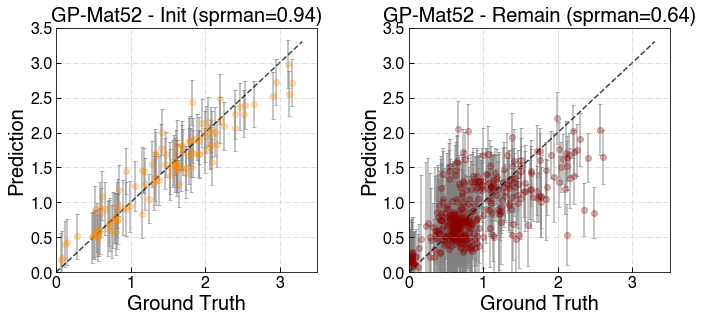

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 84.84676882798693
Optimization restart 2/3, f = 84.84676860155943
Optimization restart 3/3, f = 84.84676854144588
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.74071323  |   0.01,10.0   |        
  [2]    |                       0.93197552  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.84127190  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.99277837  |   0.01,10.0   |        
  [10]   |                       0.4

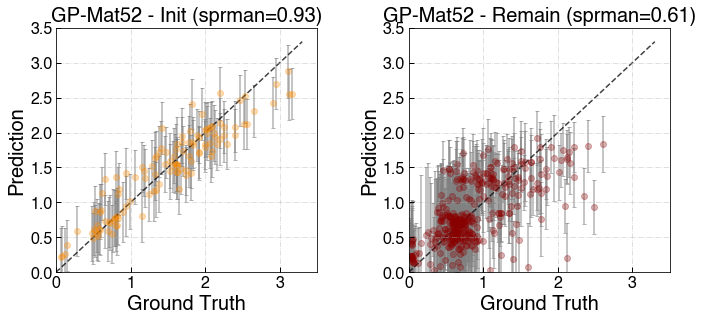

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 89.93889042826099
Optimization restart 2/3, f = 90.434893828713
Optimization restart 3/3, f = 90.11293169895565
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.74335084  |   0.01,10.0   |        
  [2]    |                       0.84615222  |   0.01,10.0   |        
  [3]    |                       9.99985032  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.76039160  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99999987  |   0.01,10.0   |        
  [9]    |                       1.00975781  |   0.01,10.0   |        
  [10]   |                       0.399

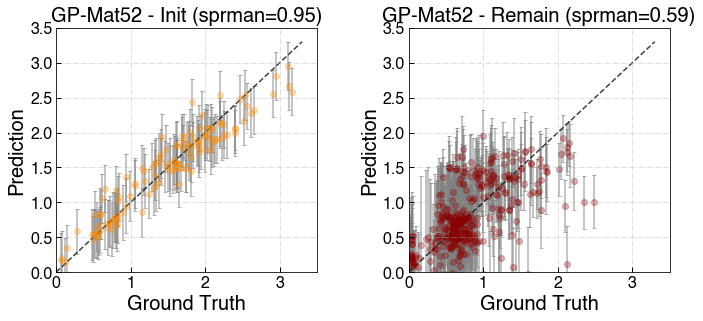

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 95.94600965158418
Optimization restart 2/3, f = 95.943329719434
Optimization restart 3/3, f = 96.42956611857849
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.74755386  |   0.01,10.0   |        
  [2]    |                       1.10828999  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99972739  |   0.01,10.0   |        
  [5]    |                       9.99901492  |   0.01,10.0   |        
  [6]    |                       0.94198638  |   0.01,10.0   |        
  [7]    |                       9.94062705  |   0.01,10.0   |        
  [8]    |                       9.97041967  |   0.01,10.0   |        
  [9]    |                       0.96255338  |   0.01,10.0   |        
  [10]   |                       0.403

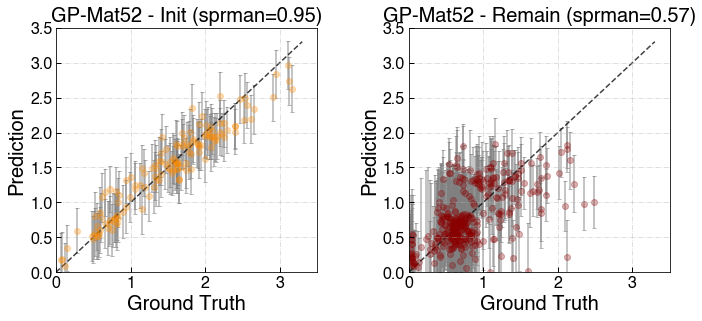

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 104.56220285366
Optimization restart 2/3, f = 104.56220941903364
Optimization restart 3/3, f = 105.29531095521524
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999965  |   0.01,10.0   |        
  [1]    |                       0.68559843  |   0.01,10.0   |        
  [2]    |                       0.96509487  |   0.01,10.0   |        
  [3]    |                       2.31205280  |   0.01,10.0   |        
  [4]    |                       9.99999676  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.87641066  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.97113499  |   0.01,10.0   |        
  [10]   |                       0.4

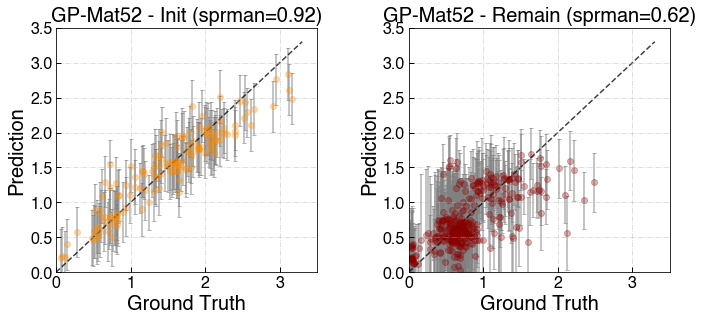

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 114.0824497835018
Optimization restart 2/3, f = 114.08248499536637
Optimization restart 3/3, f = 115.60434780080547
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.68562639  |   0.01,10.0   |        
  [2]    |                       0.86410145  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.24678345  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       1.07804938  |   0.01,10.0   |        
  [10]   |                       0

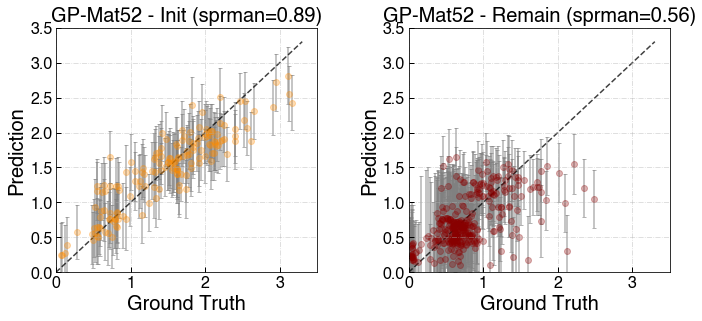

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 123.01075878109961
Optimization restart 2/3, f = 122.96441601835679
Optimization restart 3/3, f = 125.52726343299474
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.86127602  |   0.01,10.0   |        
  [2]    |                       1.28412850  |   0.01,10.0   |        
  [3]    |                       1.09530762  |   0.01,10.0   |        
  [4]    |                       9.99999996  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.89739433  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.37252867  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

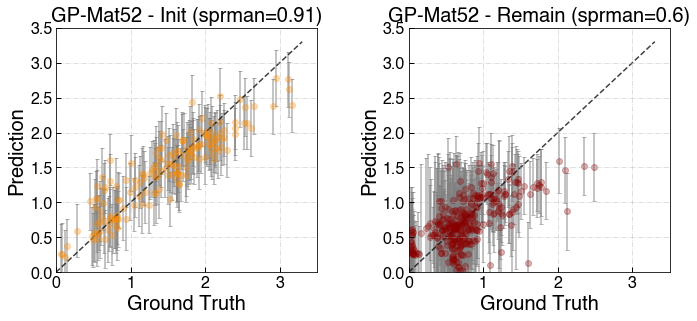

180
highest power so far:  3.168620841


reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


Optimization restart 1/3, f = 134.96054843704087
Optimization restart 2/3, f = 135.0082190361718
Optimization restart 3/3, f = 138.26425106218957
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999995  |   0.01,10.0   |        
  [1]    |                       0.72086230  |   0.01,10.0   |        
  [2]    |                       1.22787034  |   0.01,10.0   |        
  [3]    |                       0.83087935  |   0.01,10.0   |        
  [4]    |                       9.99999997  |   0.01,10.0   |        
  [5]    |                       9.99999992  |   0.01,10.0   |        
  [6]    |                       1.08334898  |   0.01,10.0   |        
  [7]    |                       9.99999999  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.97084641  |   0.01,10.0   |        
  [10]   |                       0.49704864  |   0.01,10.0   |        
  

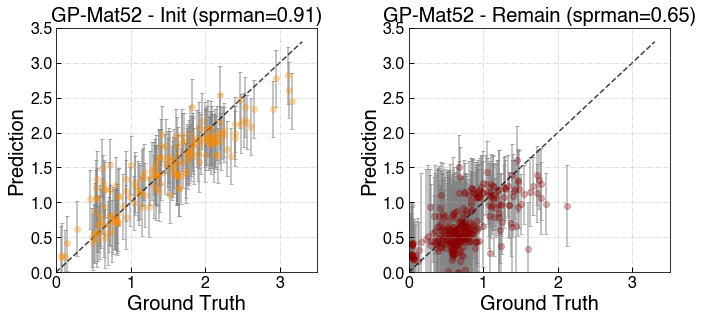

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 143.20738286071975
Optimization restart 2/3, f = 142.0049225816163
Optimization restart 3/3, f = 143.67611623324183
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.16680692  |   0.01,10.0   |        
  [2]    |                       1.44841290  |   0.01,10.0   |        
  [3]    |                       1.15305631  |   0.01,10.0   |        
  [4]    |                       9.99999950  |   0.01,10.0   |        
  [5]    |                       9.99999476  |   0.01,10.0   |        
  [6]    |                       0.95488383  |   0.01,10.0   |        
  [7]    |                       9.99993720  |   0.01,10.0   |        
  [8]    |                       1.27874321  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

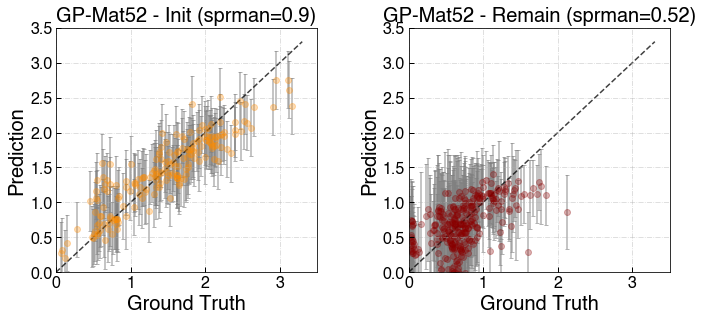

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 147.09263181308603
Optimization restart 2/3, f = 147.09260277311364
Optimization restart 3/3, f = 147.09260491698734
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999994  |   0.01,10.0   |        
  [1]    |                       1.00552995  |   0.01,10.0   |        
  [2]    |                       1.54096706  |   0.01,10.0   |        
  [3]    |                       1.13719769  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99990216  |   0.01,10.0   |        
  [6]    |                       0.95551586  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.24665762  |   0.01,10.0   |        
  [9]    |                       9.99999887  |   0.01,10.0   |        
  [10]   |                       

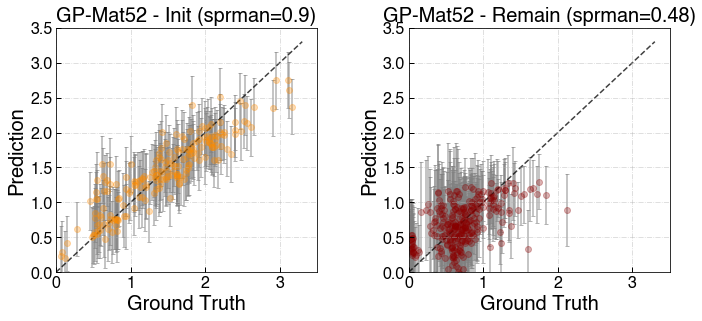

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 149.28860036177133
Optimization restart 2/3, f = 149.28824932997043
Optimization restart 3/3, f = 149.28824126226786
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.01128578  |   0.01,10.0   |        
  [2]    |                       1.49842299  |   0.01,10.0   |        
  [3]    |                       0.94376916  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       0.99389914  |   0.01,10.0   |        
  [7]    |                       9.99999995  |   0.01,10.0   |        
  [8]    |                       1.98967700  |   0.01,10.0   |        
  [9]    |                       1.43588845  |   0.01,10.0   |        
  [10]   |                       

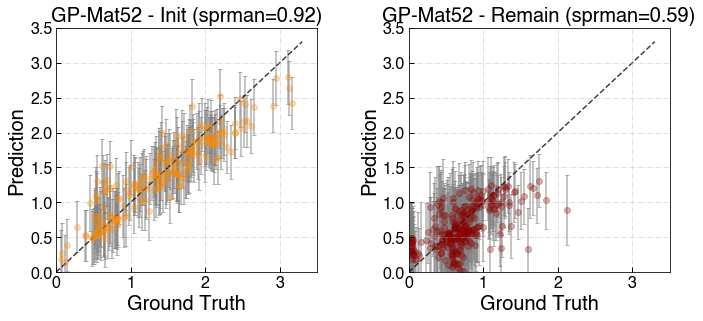

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 152.12995303169316
Optimization restart 2/3, f = 152.1299536206466
Optimization restart 3/3, f = 152.12995192239458
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.00417290  |   0.01,10.0   |        
  [2]    |                       1.49991596  |   0.01,10.0   |        
  [3]    |                       0.89584942  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999197  |   0.01,10.0   |        
  [6]    |                       1.04235858  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.84110903  |   0.01,10.0   |        
  [9]    |                       1.51212829  |   0.01,10.0   |        
  [10]   |                       0

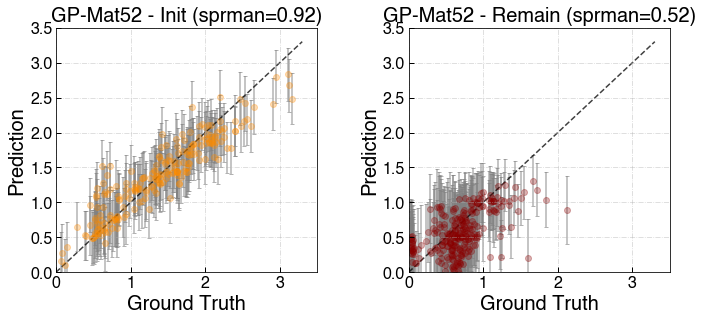

230
highest power so far:  2.943118342


reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


Optimization restart 1/3, f = -3.7387894326095257
Optimization restart 2/3, f = -3.2113396896553077
Optimization restart 3/3, f = -2.462093690176033
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.06075455  |   0.01,10.0   |        
  [2]    |                       1.35523760  |   0.01,10.0   |        
  [3]    |                       2.23177204  |   0.01,10.0   |        
  [4]    |                       9.99999963  |   0.01,10.0   |        
  [5]    |                       9.99999988  |   0.01,10.0   |        
  [6]    |                       9.99999999  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.20828219  |   0.01,10.0   |        
  [9]    |                       9.99999999  |   0.01,10.0   |        
  [10]   |                       0.39097869  |   0.01,10.0   |        

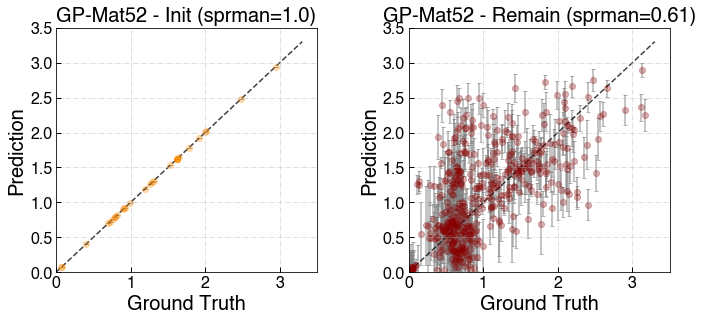

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  3.128147799
Optimization restart 1/3, f = 32.92267106229649
Optimization restart 2/3, f = 32.94342741647539
Optimization restart 3/3, f = 32.93216767316899
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.42758387  |   0.01,10.0   |        
  [2]    |                       2.46280280  |   0.01,10.0   |        
  [3]    |                       2.11166679  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       2.13439312  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.46

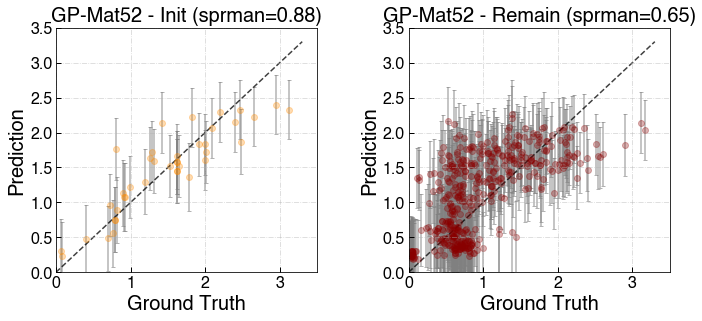

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  3.128147799
Optimization restart 1/3, f = 45.245497361453005
Optimization restart 2/3, f = 45.245497451183155
Optimization restart 3/3, f = 45.245497295902084
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.54574496  |   0.01,10.0   |        
  [2]    |                       5.69447906  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999888  |   0.01,10.0   |        
  [7]    |                       9.99999641  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1

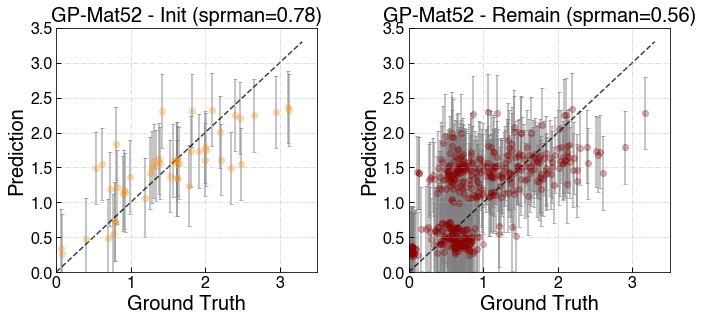

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  3.168620841
Optimization restart 1/3, f = 53.68079832785911
Optimization restart 2/3, f = 55.551904287557065
Optimization restart 3/3, f = 55.55190341362248
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.61123930  |   0.01,10.0   |        
  [2]    |                       0.99626156  |   0.01,10.0   |        
  [3]    |                       9.99692495  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99971350  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.49424601  |   0.01,10.0   |        
  [8]    |                       9.99997020  |   0.01,10.0   |        
  [9]    |                       9.99999963  |   0.01,10.0   |        
  [10]   |                       9.5

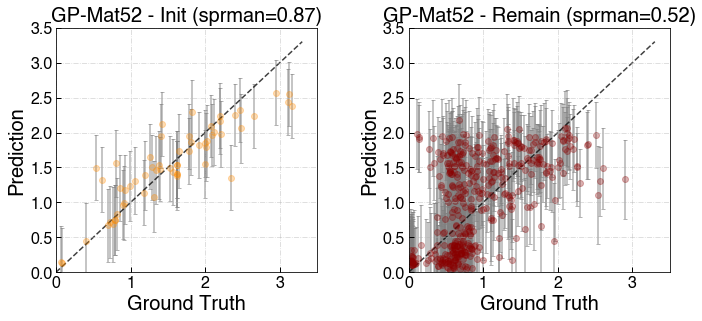

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  3.168620841
Optimization restart 1/3, f = 64.84115349753691
Optimization restart 2/3, f = 64.193993596405
Optimization restart 3/3, f = 64.84115330554076
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.96485142  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999871  |   0.01,10.0   |        
  [7]    |                       9.99992370  |   0.01,10.0   |        
  [8]    |                       9.99999979  |   0.01,10.0   |        
  [9]    |                       9.99999999  |   0.01,10.0   |        
  [10]   |                       9.9999

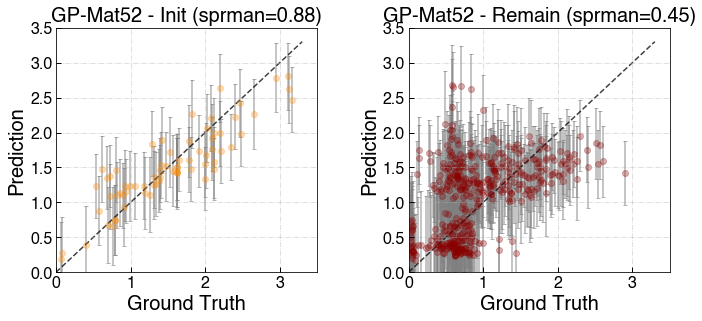

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  3.168620841
Optimization restart 1/3, f = 70.15091218452919
Optimization restart 2/3, f = 72.541241736566
Optimization restart 3/3, f = 70.15091249992854
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.55055242  |   0.01,10.0   |        
  [2]    |                       1.55824761  |   0.01,10.0   |        
  [3]    |                       0.38510166  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.29971374  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.8433

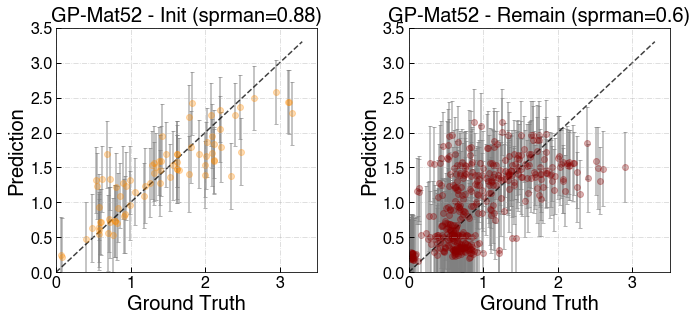

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  3.168620841
Optimization restart 1/3, f = 74.38242430640574
Optimization restart 2/3, f = 74.38217862614167
Optimization restart 3/3, f = 76.40336781244105
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99967860  |   0.01,10.0   |        
  [1]    |                       0.64541227  |   0.01,10.0   |        
  [2]    |                       1.41671509  |   0.01,10.0   |        
  [3]    |                       0.39488738  |   0.01,10.0   |        
  [4]    |                       9.99936554  |   0.01,10.0   |        
  [5]    |                       9.99495831  |   0.01,10.0   |        
  [6]    |                       9.99984018  |   0.01,10.0   |        
  [7]    |                       9.99995991  |   0.01,10.0   |        
  [8]    |                       9.99997291  |   0.01,10.0   |        
  [9]    |                       8.55792539  |   0.01,10.0   |        
  [10]   |                       0.88

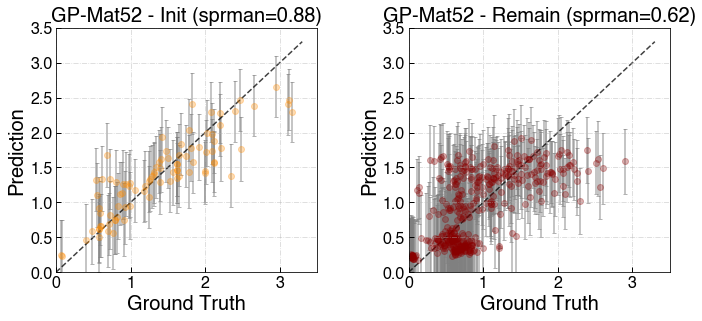

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.168620841
Optimization restart 1/3, f = 79.78527293241973
Optimization restart 2/3, f = 81.99044852356474
Optimization restart 3/3, f = 79.78527262243198
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.59274362  |   0.01,10.0   |        
  [2]    |                       1.34846281  |   0.01,10.0   |        
  [3]    |                       0.45788826  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       9.99997453  |   0.01,10.0   |        
  [8]    |                       9.99992774  |   0.01,10.0   |        
  [9]    |                       9.99999979  |   0.01,10.0   |        
  [10]   |                       0.8

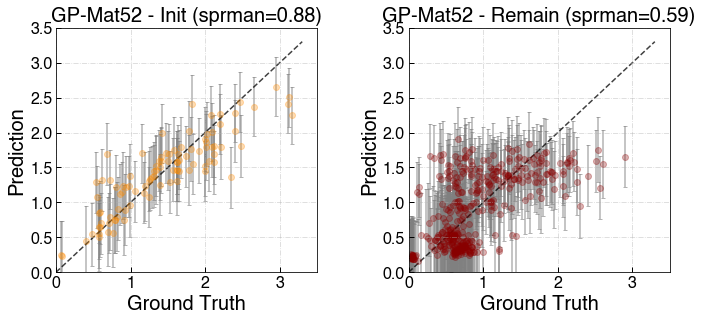

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 89.90225540799855
Optimization restart 2/3, f = 89.90593607680302
Optimization restart 3/3, f = 89.5646909756487
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       6.41747170  |   0.01,10.0   |        
  [1]    |                       0.53541859  |   0.01,10.0   |        
  [2]    |                       0.74594565  |   0.01,10.0   |        
  [3]    |                       0.65477638  |   0.01,10.0   |        
  [4]    |                       9.99999846  |   0.01,10.0   |        
  [5]    |                       9.99999844  |   0.01,10.0   |        
  [6]    |                       9.99999638  |   0.01,10.0   |        
  [7]    |                       0.98447509  |   0.01,10.0   |        
  [8]    |                       9.99999969  |   0.01,10.0   |        
  [9]    |                       9.99994213  |   0.01,10.0   |        
  [10]   |                       1.00

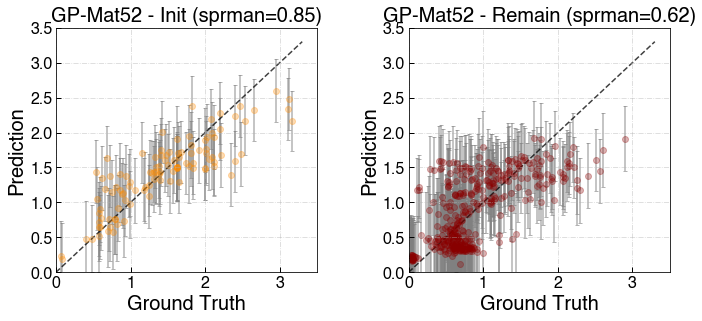

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 100.10191994075933
Optimization restart 2/3, f = 99.51004509987214
Optimization restart 3/3, f = 99.51004451989002
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.53660450  |   0.01,10.0   |        
  [2]    |                       0.74105320  |   0.01,10.0   |        
  [3]    |                       0.88413776  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.84733939  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.

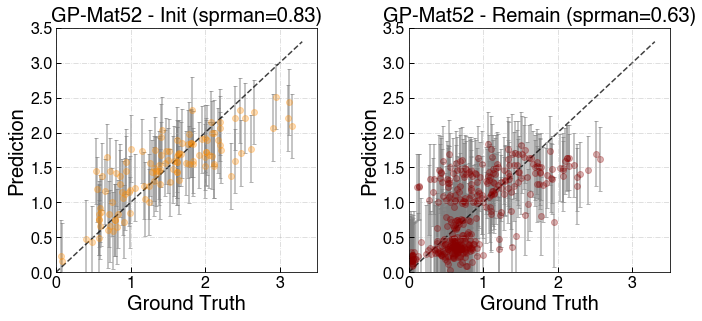

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 103.90288846614904
Optimization restart 2/3, f = 104.29227305460942
Optimization restart 3/3, f = 104.29227342630979
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999714  |   0.01,10.0   |        
  [1]    |                       0.62140792  |   0.01,10.0   |        
  [2]    |                       0.74396038  |   0.01,10.0   |        
  [3]    |                       0.93447914  |   0.01,10.0   |        
  [4]    |                       9.99946316  |   0.01,10.0   |        
  [5]    |                       9.99192456  |   0.01,10.0   |        
  [6]    |                       9.99321496  |   0.01,10.0   |        
  [7]    |                       0.84791509  |   0.01,10.0   |        
  [8]    |                       9.99999526  |   0.01,10.0   |        
  [9]    |                       9.99903972  |   0.01,10.0   |        
  [10]   |                       

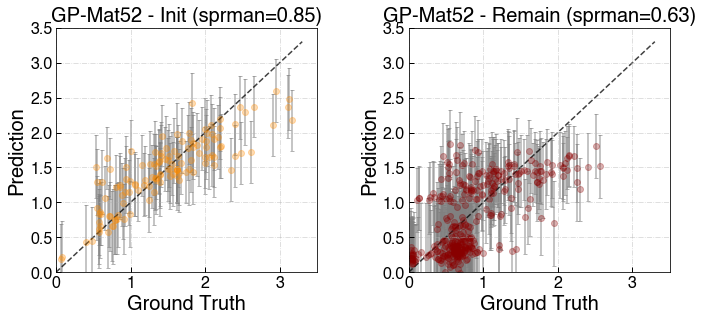

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 114.7011265402021
Optimization restart 2/3, f = 115.98519752419772
Optimization restart 3/3, f = 114.75624344076289
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99819681  |   0.01,10.0   |        
  [1]    |                       0.52935064  |   0.01,10.0   |        
  [2]    |                       0.85120995  |   0.01,10.0   |        
  [3]    |                       0.75207675  |   0.01,10.0   |        
  [4]    |                       9.99993991  |   0.01,10.0   |        
  [5]    |                       9.96629765  |   0.01,10.0   |        
  [6]    |                       0.71275334  |   0.01,10.0   |        
  [7]    |                       1.80241875  |   0.01,10.0   |        
  [8]    |                       9.94403901  |   0.01,10.0   |        
  [9]    |                       9.89843983  |   0.01,10.0   |        
  [10]   |                       0

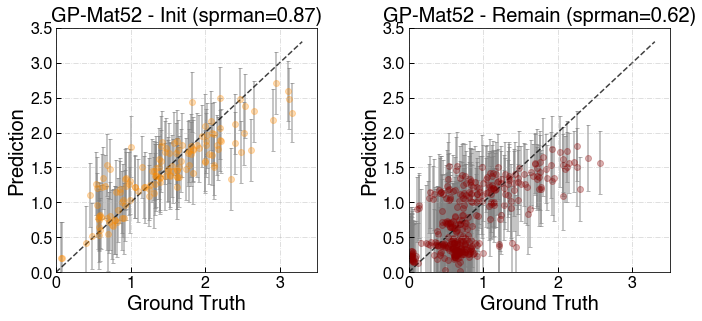

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 119.86094775424465
Optimization restart 2/3, f = 122.25670001737147
Optimization restart 3/3, f = 113.65886899651326
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99452999  |   0.01,10.0   |        
  [1]    |                       0.56400126  |   0.01,10.0   |        
  [2]    |                       0.63672903  |   0.01,10.0   |        
  [3]    |                       1.90725791  |   0.01,10.0   |        
  [4]    |                       9.99921471  |   0.01,10.0   |        
  [5]    |                       1.08716288  |   0.01,10.0   |        
  [6]    |                       9.99999967  |   0.01,10.0   |        
  [7]    |                       9.80872602  |   0.01,10.0   |        
  [8]    |                       5.16673510  |   0.01,10.0   |        
  [9]    |                       0.55474071  |   0.01,10.0   |        
  [10]   |                       

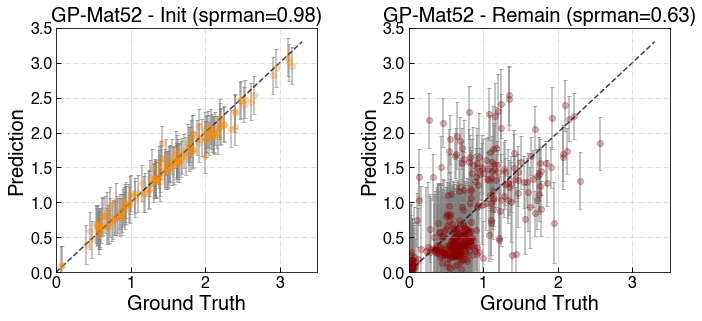

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 120.84357435010979
Optimization restart 2/3, f = 124.10215869593978
Optimization restart 3/3, f = 124.15832729713745
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99998961  |   0.01,10.0   |        
  [1]    |                       0.48217228  |   0.01,10.0   |        
  [2]    |                       1.44735286  |   0.01,10.0   |        
  [3]    |                       0.77611072  |   0.01,10.0   |        
  [4]    |                       0.68479763  |   0.01,10.0   |        
  [5]    |                       9.99999987  |   0.01,10.0   |        
  [6]    |                       1.23289323  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       8.06533833  |   0.01,10.0   |        
  [10]   |                       

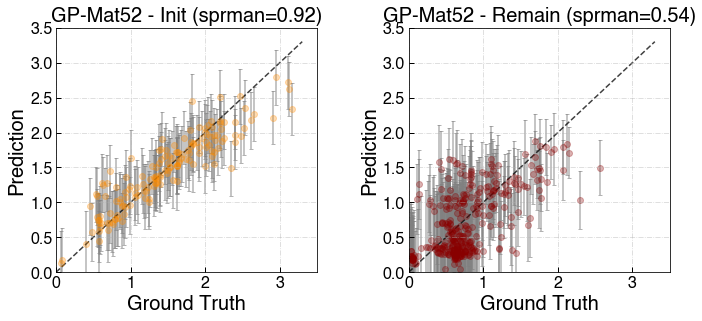

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 123.83600550945324
Optimization restart 2/3, f = 123.8360060849551
Optimization restart 3/3, f = 126.52213302193184
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.50754415  |   0.01,10.0   |        
  [2]    |                       1.13593801  |   0.01,10.0   |        
  [3]    |                       0.66357890  |   0.01,10.0   |        
  [4]    |                       0.62511715  |   0.01,10.0   |        
  [5]    |                       9.99998782  |   0.01,10.0   |        
  [6]    |                       1.37200678  |   0.01,10.0   |        
  [7]    |                       9.99999765  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       2.46441195  |   0.01,10.0   |        
  [10]   |                       0

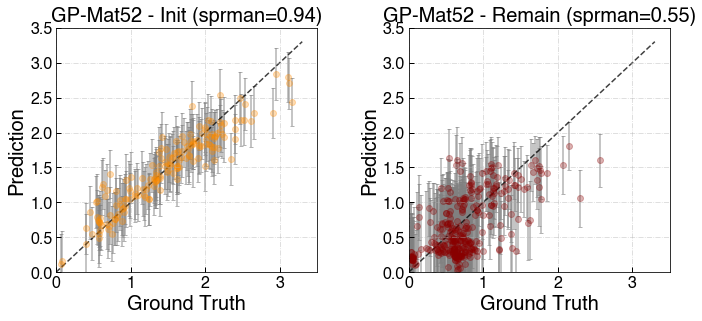

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 135.28517843925763
Optimization restart 2/3, f = 138.91843967548175
Optimization restart 3/3, f = 134.75471820739753
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.55521566  |   0.01,10.0   |        
  [2]    |                       1.27690560  |   0.01,10.0   |        
  [3]    |                       0.92710463  |   0.01,10.0   |        
  [4]    |                       1.01374229  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.10413844  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.98328887  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

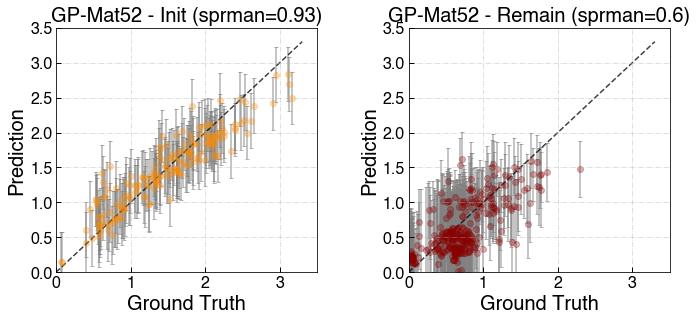

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 142.55563885603547
Optimization restart 2/3, f = 143.41074997778605
Optimization restart 3/3, f = 141.24962572512175
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.48870654  |   0.01,10.0   |        
  [2]    |                       1.06997339  |   0.01,10.0   |        
  [3]    |                       0.87926240  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.89708224  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.32709637  |   0.01,10.0   |        
  [10]   |                       

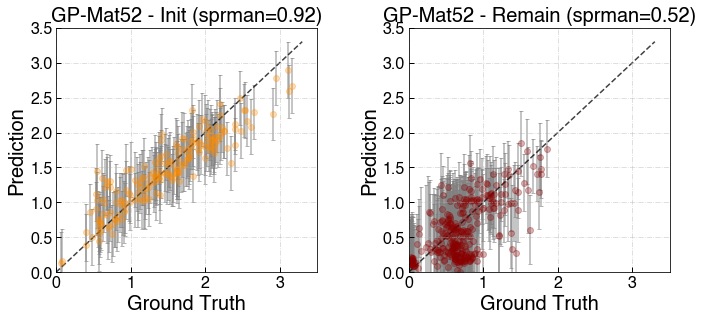

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 146.0428445450953
Optimization restart 2/3, f = 144.73961424899625
Optimization restart 3/3, f = 145.5392014239509
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999479  |   0.01,10.0   |        
  [1]    |                       0.48186156  |   0.01,10.0   |        
  [2]    |                       1.07589501  |   0.01,10.0   |        
  [3]    |                       0.84925542  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.72798939  |   0.01,10.0   |        
  [7]    |                       9.99986809  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.34174667  |   0.01,10.0   |        
  [10]   |                       0.

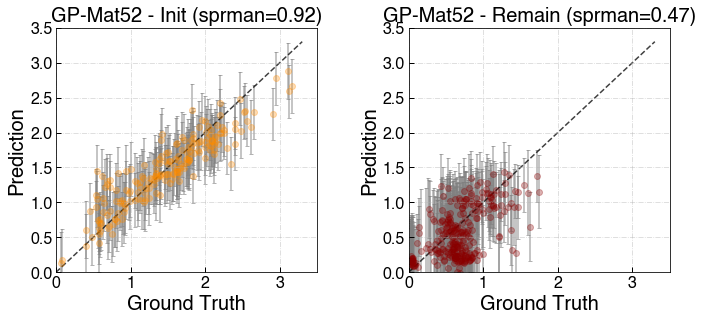

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 148.84969441465105
Optimization restart 2/3, f = 150.68752925947695
Optimization restart 3/3, f = 148.85148184221748
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.75465940  |   0.01,10.0   |        
  [1]    |                       0.57708925  |   0.01,10.0   |        
  [2]    |                       1.11845135  |   0.01,10.0   |        
  [3]    |                       1.02062724  |   0.01,10.0   |        
  [4]    |                       0.62048067  |   0.01,10.0   |        
  [5]    |                       9.99994283  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       9.99920992  |   0.01,10.0   |        
  [8]    |                       9.99855181  |   0.01,10.0   |        
  [9]    |                       1.18809899  |   0.01,10.0   |        
  [10]   |                       

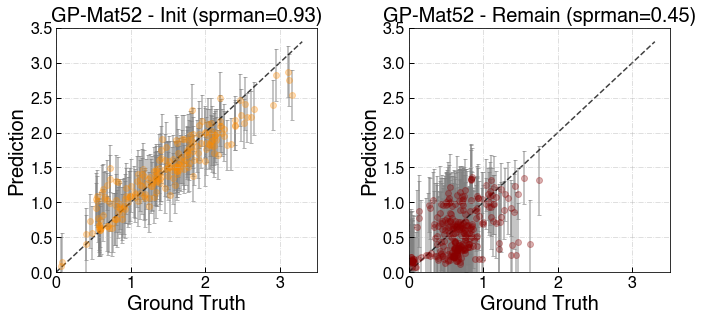

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 150.59347958114077
Optimization restart 2/3, f = 150.61154897772906
Optimization restart 3/3, f = 150.61154888401387
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.50332602  |   0.01,10.0   |        
  [2]    |                       1.23607257  |   0.01,10.0   |        
  [3]    |                       0.87817118  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999729  |   0.01,10.0   |        
  [6]    |                       1.67845306  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99999644  |   0.01,10.0   |        
  [9]    |                       0.35275941  |   0.01,10.0   |        
  [10]   |                       

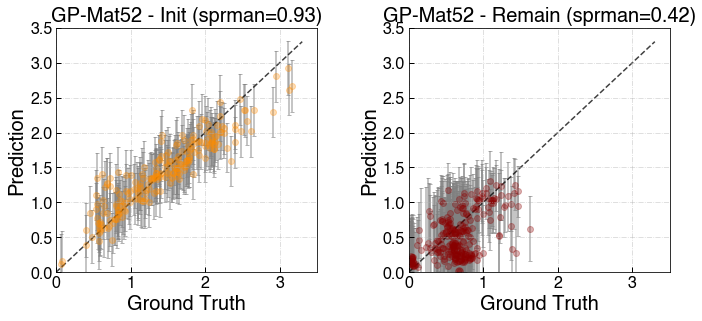

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.213983841
Optimization restart 1/3, f = -10.449167057380578
Optimization restart 2/3, f = -10.70155078603367
Optimization restart 3/3, f = -10.701633674010896
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                      10.00000000  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.06441975  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.96017002  |   0.01,10.0   |        
  [7]    |                       1.52669291  |   0.01,10.0   |        
  [8]    |                       0.67497454  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                     

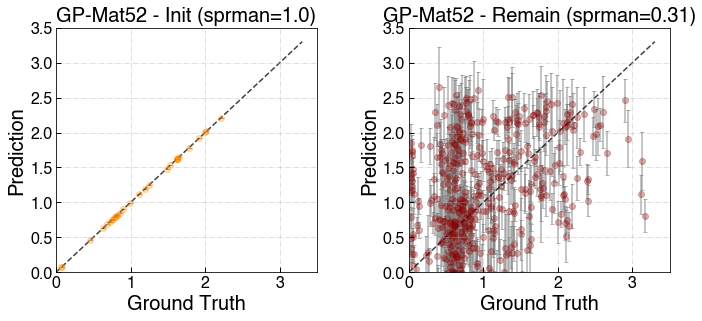

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  2.213983841
Optimization restart 1/3, f = 0.6612780550305217
Optimization restart 2/3, f = 25.13187403498544
Optimization restart 3/3, f = 0.26163867061085
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.64996772  |   0.01,10.0   |        
  [1]    |                      10.00000000  |   0.01,10.0   |        
  [2]    |                       0.27076726  |   0.01,10.0   |        
  [3]    |                       9.99999999  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99922213  |   0.01,10.0   |        
  [7]    |                       0.53510837  |   0.01,10.0   |        
  [8]    |                       0.79379978  |   0.01,10.0   |        
  [9]    |                       1.28968249  |   0.01,10.0   |        
  [10]   |                      10.00

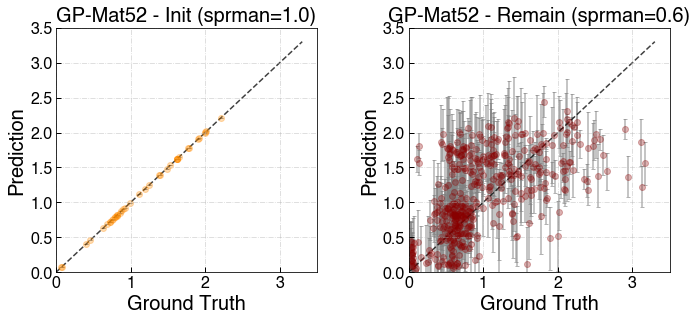

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  2.213983841
Optimization restart 1/3, f = 29.933574341809578
Optimization restart 2/3, f = 29.933574154798677
Optimization restart 3/3, f = 29.926323161186275
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       1.18864239  |   0.01,10.0   |        
  [2]    |                       2.18366363  |   0.01,10.0   |        
  [3]    |                       6.07613998  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       1.18918249  |   0.01,10.0   |        
  [8]    |                       9.99998530  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       7

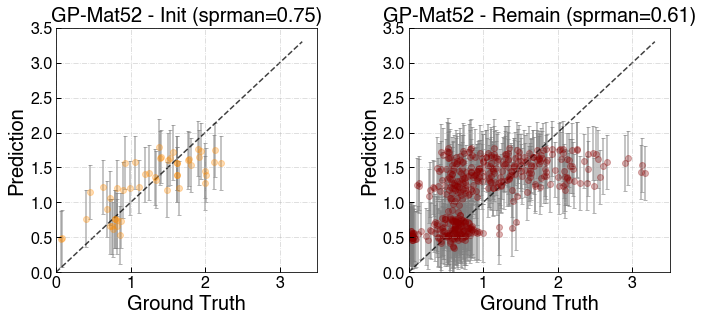

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  2.213983841
Optimization restart 1/3, f = 33.816485802743415
Optimization restart 2/3, f = 9.048093259276836
Optimization restart 3/3, f = 33.816485728458055
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                      10.00000000  |   0.01,10.0   |        
  [2]    |                       0.25386593  |   0.01,10.0   |        
  [3]    |                       9.99977130  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99998354  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.59262098  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10.

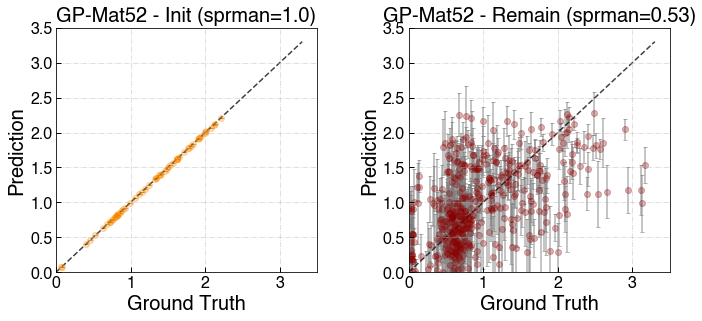

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  2.482180148
Optimization restart 1/3, f = 43.088605151613436
Optimization restart 2/3, f = 46.704865831435384
Optimization restart 3/3, f = 43.08860511078812
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.34548080  |   0.01,10.0   |        
  [1]    |                       0.67019058  |   0.01,10.0   |        
  [2]    |                       9.99999984  |   0.01,10.0   |        
  [3]    |                       2.93173407  |   0.01,10.0   |        
  [4]    |                       9.99999724  |   0.01,10.0   |        
  [5]    |                       9.99999986  |   0.01,10.0   |        
  [6]    |                       9.99999812  |   0.01,10.0   |        
  [7]    |                       1.29167437  |   0.01,10.0   |        
  [8]    |                       1.47532684  |   0.01,10.0   |        
  [9]    |                       0.62431024  |   0.01,10.0   |        
  [10]   |                       1.

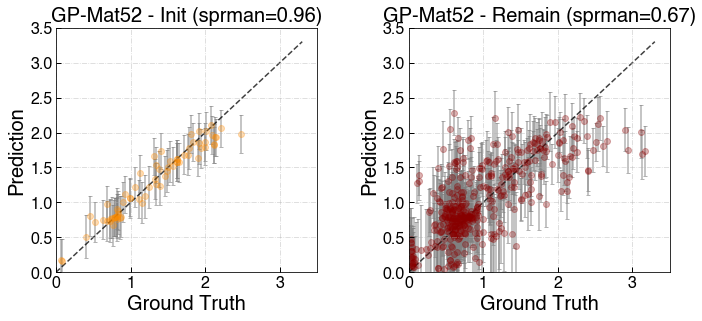

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  2.56088825
Optimization restart 1/3, f = 57.539491685844666
Optimization restart 2/3, f = 57.53949165983224
Optimization restart 3/3, f = 57.53949149935351
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.90892926  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       2.12596118  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       2.23476105  |   0.01,10.0   |        
  [7]    |                       1.34368491  |   0.01,10.0   |        
  [8]    |                       2.27663279  |   0.01,10.0   |        
  [9]    |                       1.75092084  |   0.01,10.0   |        
  [10]   |                       1.52

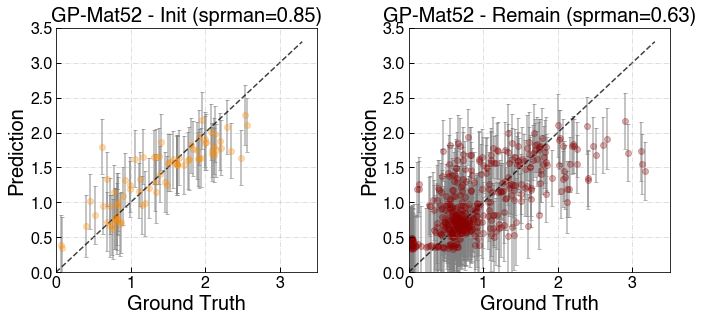

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  2.901818968
Optimization restart 1/3, f = 67.90203785139488
Optimization restart 2/3, f = 67.90203794796203
Optimization restart 3/3, f = 67.90203806932372
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.81842320  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       2.23702693  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       2.12490881  |   0.01,10.0   |        
  [7]    |                       1.52802727  |   0.01,10.0   |        
  [8]    |                       2.97305594  |   0.01,10.0   |        
  [9]    |                       1.77534687  |   0.01,10.0   |        
  [10]   |                       1.64

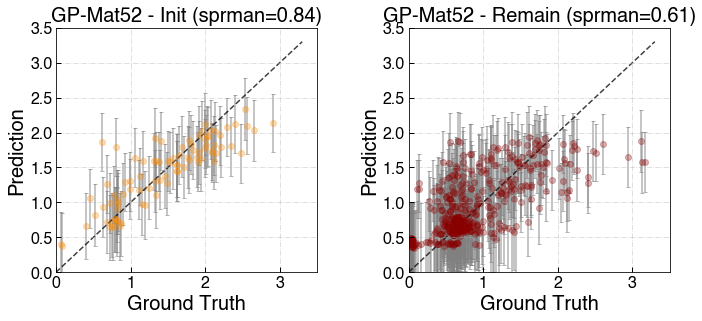

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.112154836
Optimization restart 1/3, f = 84.2561552566106
Optimization restart 2/3, f = 84.23844939797829
Optimization restart 3/3, f = 82.5455485294977
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99857664  |   0.01,10.0   |        
  [1]    |                       1.19894550  |   0.01,10.0   |        
  [2]    |                       1.36667351  |   0.01,10.0   |        
  [3]    |                       3.28112311  |   0.01,10.0   |        
  [4]    |                       9.99993224  |   0.01,10.0   |        
  [5]    |                       9.99999813  |   0.01,10.0   |        
  [6]    |                       1.49611543  |   0.01,10.0   |        
  [7]    |                       9.99854469  |   0.01,10.0   |        
  [8]    |                       2.45438046  |   0.01,10.0   |        
  [9]    |                       4.61017525  |   0.01,10.0   |        
  [10]   |                       0.684

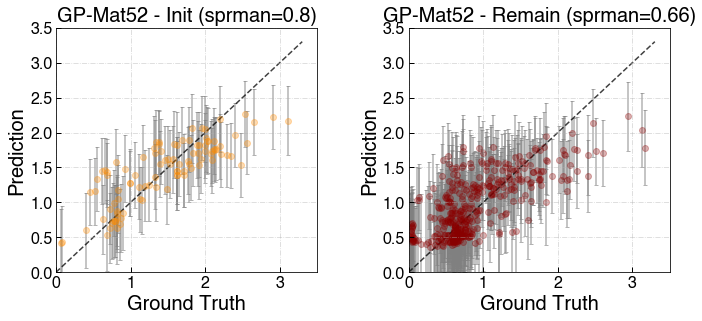

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 94.94727106790995
Optimization restart 2/3, f = 91.76355082210628
Optimization restart 3/3, f = 93.91682468866304
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99998636  |   0.01,10.0   |        
  [1]    |                       1.25694148  |   0.01,10.0   |        
  [2]    |                       0.85839321  |   0.01,10.0   |        
  [3]    |                       2.31649512  |   0.01,10.0   |        
  [4]    |                       9.99998408  |   0.01,10.0   |        
  [5]    |                       9.99983173  |   0.01,10.0   |        
  [6]    |                       1.63671182  |   0.01,10.0   |        
  [7]    |                       9.99999952  |   0.01,10.0   |        
  [8]    |                       3.23431554  |   0.01,10.0   |        
  [9]    |                       1.61355499  |   0.01,10.0   |        
  [10]   |                       0.7

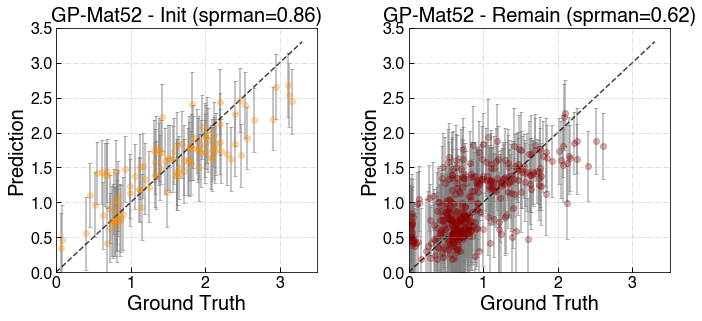

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 102.10460888986148
Optimization restart 2/3, f = 96.0545186951916
Optimization restart 3/3, f = 97.87701296834445
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.12363467  |   0.01,10.0   |        
  [2]    |                       0.71460349  |   0.01,10.0   |        
  [3]    |                       1.98266419  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.30208787  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       1.28615688  |   0.01,10.0   |        
  [10]   |                       0.6

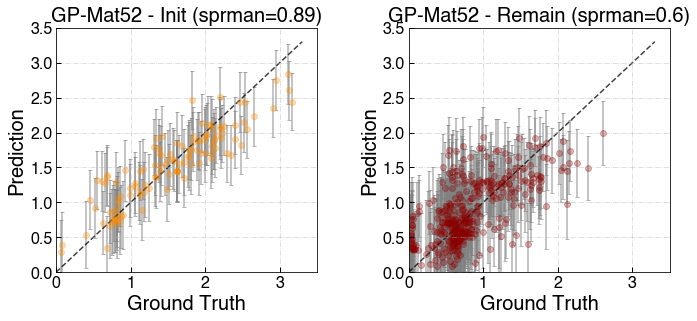

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 105.59028698828196
Optimization restart 2/3, f = 109.21310696394919
Optimization restart 3/3, f = 105.59028954938658
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.83499298  |   0.01,10.0   |        
  [2]    |                       0.96407944  |   0.01,10.0   |        
  [3]    |                       1.78745626  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.47337851  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.56723470  |   0.01,10.0   |        
  [9]    |                       2.66844725  |   0.01,10.0   |        
  [10]   |                       

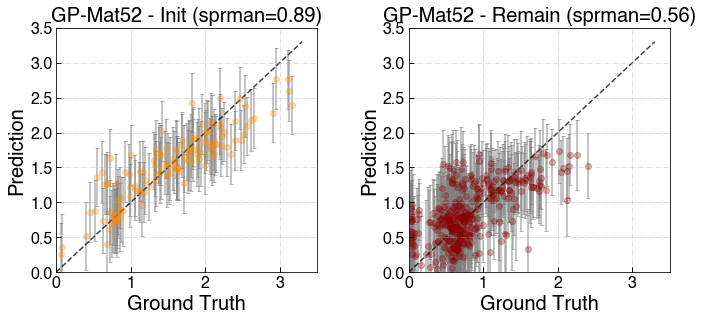

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 115.95042599303957
Optimization restart 2/3, f = 115.95042641010127
Optimization restart 3/3, f = 115.39276566225665
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.26582271  |   0.01,10.0   |        
  [1]    |                       0.78856058  |   0.01,10.0   |        
  [2]    |                       1.83293246  |   0.01,10.0   |        
  [3]    |                       1.60823408  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99991068  |   0.01,10.0   |        
  [6]    |                       0.20180084  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

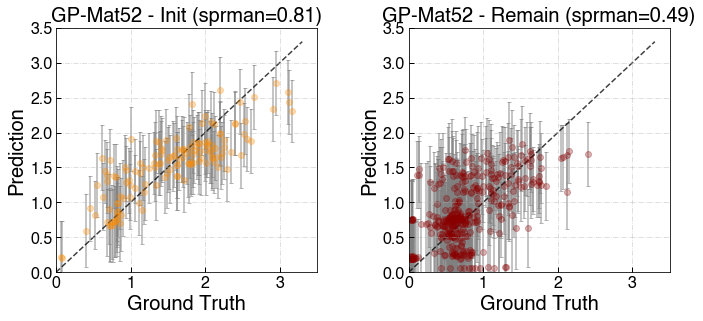

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 115.87754541559241
Optimization restart 2/3, f = 116.15041412093788
Optimization restart 3/3, f = 115.8775596564227
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999986  |   0.01,10.0   |        
  [1]    |                       1.79819827  |   0.01,10.0   |        
  [2]    |                       1.01020998  |   0.01,10.0   |        
  [3]    |                       1.62551110  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99918523  |   0.01,10.0   |        
  [6]    |                       1.37396310  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.67492441  |   0.01,10.0   |        
  [9]    |                       2.09047388  |   0.01,10.0   |        
  [10]   |                       0

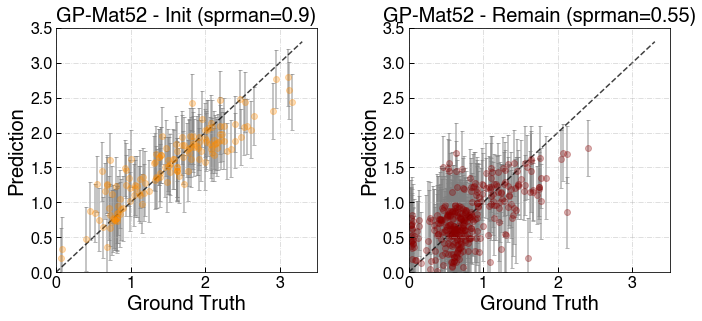

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 122.9752532198032
Optimization restart 2/3, f = 121.79140691184045
Optimization restart 3/3, f = 121.79140529110339
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.68581868  |   0.01,10.0   |        
  [2]    |                       1.00802653  |   0.01,10.0   |        
  [3]    |                       1.49628586  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99242384  |   0.01,10.0   |        
  [6]    |                       1.33424233  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.82330045  |   0.01,10.0   |        
  [9]    |                       1.87085782  |   0.01,10.0   |        
  [10]   |                       0

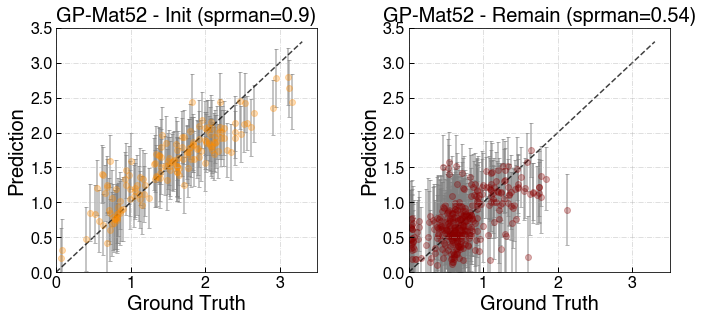

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 130.6344723640558
Optimization restart 2/3, f = 127.25299666333392
Optimization restart 3/3, f = 132.24416219541428
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.63153044  |   0.01,10.0   |        
  [1]    |                       0.78666345  |   0.01,10.0   |        
  [2]    |                       1.26240797  |   0.01,10.0   |        
  [3]    |                       1.98544672  |   0.01,10.0   |        
  [4]    |                       0.82561977  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999611  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.85301252  |   0.01,10.0   |        
  [9]    |                       1.43352438  |   0.01,10.0   |        
  [10]   |                      10

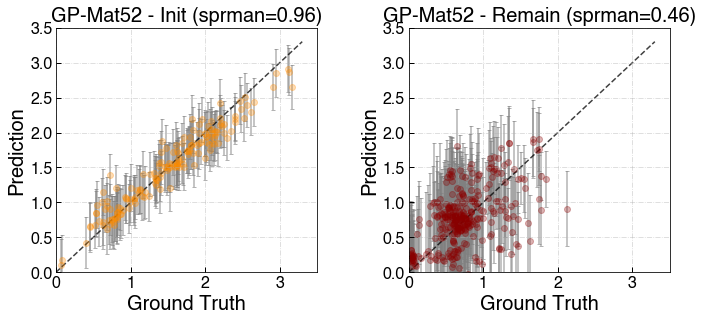

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 131.58197583161305
Optimization restart 2/3, f = 135.239605308542
Optimization restart 3/3, f = 136.19889410175983
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.63839266  |   0.01,10.0   |        
  [1]    |                       0.89091554  |   0.01,10.0   |        
  [2]    |                       1.34367127  |   0.01,10.0   |        
  [3]    |                       2.04726935  |   0.01,10.0   |        
  [4]    |                       0.81390404  |   0.01,10.0   |        
  [5]    |                       9.99999891  |   0.01,10.0   |        
  [6]    |                       9.99997576  |   0.01,10.0   |        
  [7]    |                       9.99611572  |   0.01,10.0   |        
  [8]    |                       1.83757725  |   0.01,10.0   |        
  [9]    |                       1.39416601  |   0.01,10.0   |        
  [10]   |                       9.

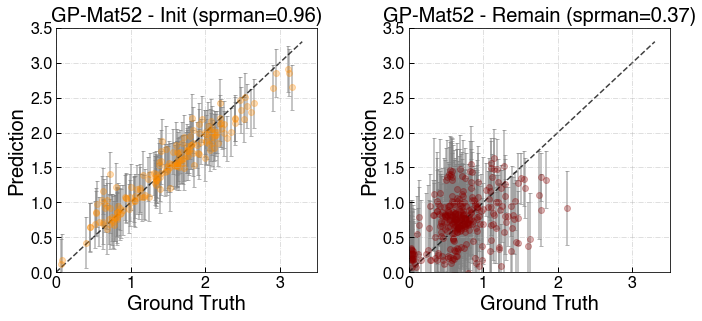

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 139.57253852981245
Optimization restart 2/3, f = 139.22039104892895
Optimization restart 3/3, f = 139.22023963073738
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.15543307  |   0.01,10.0   |        
  [2]    |                       1.24139062  |   0.01,10.0   |        
  [3]    |                       1.05702869  |   0.01,10.0   |        
  [4]    |                       9.99999703  |   0.01,10.0   |        
  [5]    |                       9.99716364  |   0.01,10.0   |        
  [6]    |                       0.95499592  |   0.01,10.0   |        
  [7]    |                       9.99978611  |   0.01,10.0   |        
  [8]    |                       1.14219354  |   0.01,10.0   |        
  [9]    |                       9.99970464  |   0.01,10.0   |        
  [10]   |                       

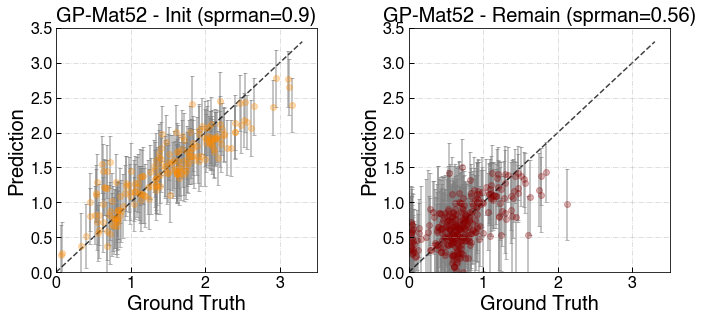

200
highest power so far:  3.168620841


reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


Optimization restart 1/3, f = 145.31252573337724
Optimization restart 2/3, f = 145.31252397685734
Optimization restart 3/3, f = 144.28603540606227
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.79452499  |   0.01,10.0   |        
  [1]    |                       0.61584511  |   0.01,10.0   |        
  [2]    |                       1.48915945  |   0.01,10.0   |        
  [3]    |                       0.90312658  |   0.01,10.0   |        
  [4]    |                       0.80440237  |   0.01,10.0   |        
  [5]    |                       9.97095895  |   0.01,10.0   |        
  [6]    |                       9.91400847  |   0.01,10.0   |        
  [7]    |                       9.98926505  |   0.01,10.0   |        
  [8]    |                       4.04553695  |   0.01,10.0   |        
  [9]    |                       2.14943702  |   0.01,10.0   |        
  [10]   |                       1.24681765  |   0.01,10.0   |        
 

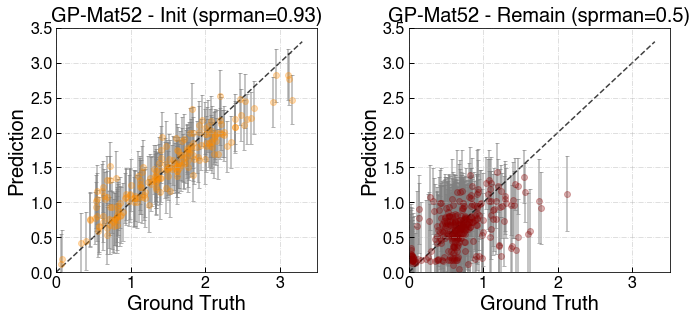

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 150.4463464835051
Optimization restart 2/3, f = 151.78381525319307
Optimization restart 3/3, f = 149.43716002496976
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.79824196  |   0.01,10.0   |        
  [1]    |                       0.64814273  |   0.01,10.0   |        
  [2]    |                       1.35368315  |   0.01,10.0   |        
  [3]    |                       1.11809487  |   0.01,10.0   |        
  [4]    |                       0.68440438  |   0.01,10.0   |        
  [5]    |                       9.99722197  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       9.99970033  |   0.01,10.0   |        
  [8]    |                       3.40217429  |   0.01,10.0   |        
  [9]    |                       1.91491655  |   0.01,10.0   |        
  [10]   |                       1

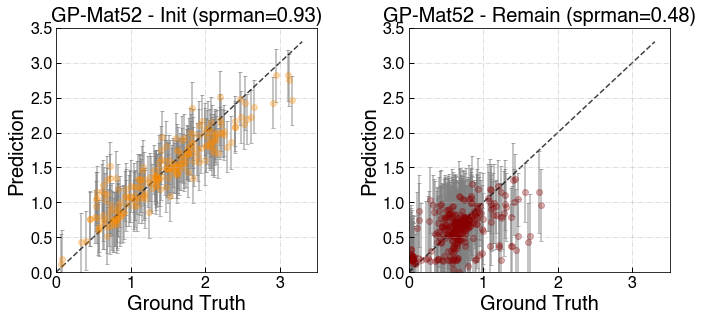

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 152.51332860803092
Optimization restart 2/3, f = 152.51333130406246
Optimization restart 3/3, f = 152.51332943442998
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.11065509  |   0.01,10.0   |        
  [2]    |                       1.34987967  |   0.01,10.0   |        
  [3]    |                       0.94975658  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.93572994  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.06666508  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

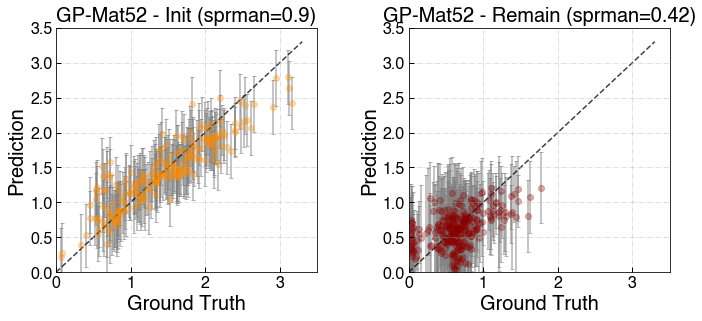

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.07111452
Optimization restart 1/3, f = -10.319447555286493
Optimization restart 2/3, f = -10.319447890000474
Optimization restart 3/3, f = -9.699736061838268
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.65736561  |   0.01,10.0   |        
  [1]    |                       0.33095629  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       9.99999999  |   0.01,10.0   |        
  [4]    |                       9.99999015  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       3.50398968  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.27316112  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      

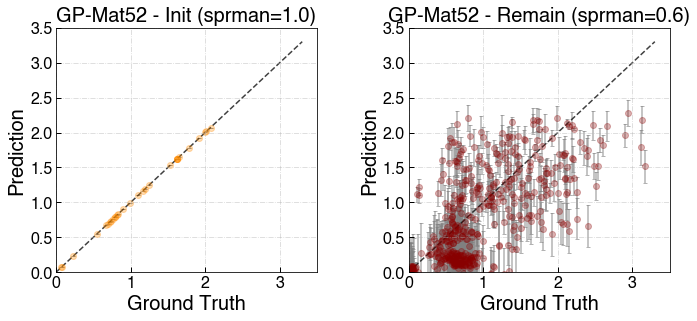

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  3.128147799
Optimization restart 1/3, f = 21.372113138180186
Optimization restart 2/3, f = 29.343420328874377
Optimization restart 3/3, f = 29.331483149307736
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.70169154  |   0.01,10.0   |        
  [2]    |                       0.66106651  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.35698514  |   0.01,10.0   |        
  [6]    |                       0.14907011  |   0.01,10.0   |        
  [7]    |                       1.09162712  |   0.01,10.0   |        
  [8]    |                       1.60543641  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10

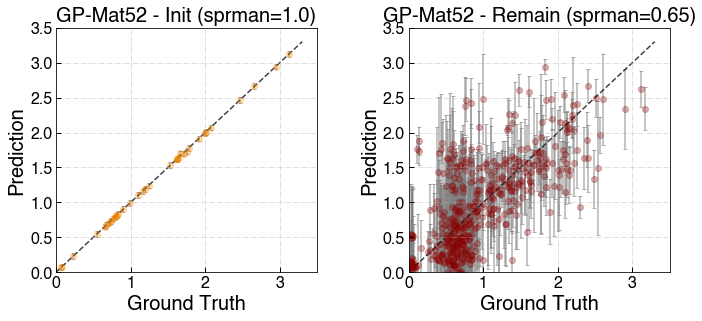

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  3.128147799
Optimization restart 1/3, f = 41.400396367467216
Optimization restart 2/3, f = 41.40066137613817
Optimization restart 3/3, f = 41.400165098425276
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.49792319  |   0.01,10.0   |        
  [2]    |                       4.73263831  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999852  |   0.01,10.0   |        
  [5]    |                       6.73248021  |   0.01,10.0   |        
  [6]    |                       1.07109195  |   0.01,10.0   |        
  [7]    |                       9.99999987  |   0.01,10.0   |        
  [8]    |                       9.99999890  |   0.01,10.0   |        
  [9]    |                       9.99999960  |   0.01,10.0   |        
  [10]   |                       0.

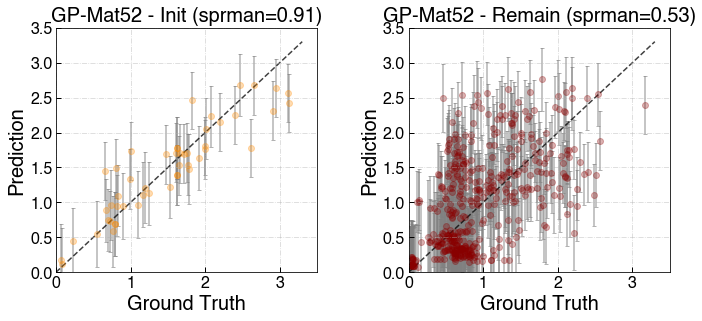

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  3.128147799
Optimization restart 1/3, f = 50.66188940782292
Optimization restart 2/3, f = 50.65817915666377
Optimization restart 3/3, f = 50.65817902165378
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.68923116  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.63258940  |   0.01,10.0   |        
  [4]    |                       1.67201092  |   0.01,10.0   |        
  [5]    |                       9.99998913  |   0.01,10.0   |        
  [6]    |                       2.04170723  |   0.01,10.0   |        
  [7]    |                       2.48510853  |   0.01,10.0   |        
  [8]    |                       9.99999906  |   0.01,10.0   |        
  [9]    |                       9.99999933  |   0.01,10.0   |        
  [10]   |                       0.76

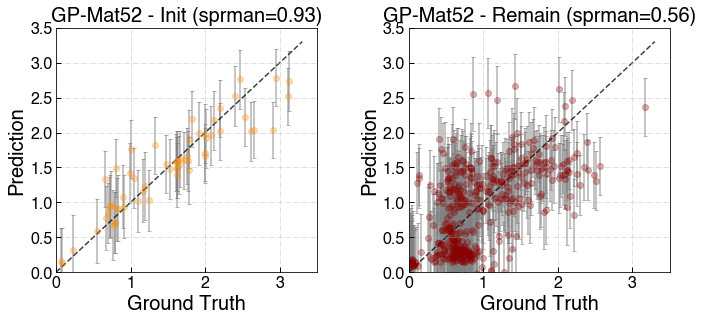

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  3.168620841
Optimization restart 1/3, f = 58.9419843110783
Optimization restart 2/3, f = 58.94198390012731
Optimization restart 3/3, f = 56.04854607685895
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999998  |   0.01,10.0   |        
  [1]    |                       0.70320873  |   0.01,10.0   |        
  [2]    |                       0.76333178  |   0.01,10.0   |        
  [3]    |                       0.24215608  |   0.01,10.0   |        
  [4]    |                       9.99999860  |   0.01,10.0   |        
  [5]    |                       9.99999959  |   0.01,10.0   |        
  [6]    |                       2.23403978  |   0.01,10.0   |        
  [7]    |                       1.38685141  |   0.01,10.0   |        
  [8]    |                       9.99999957  |   0.01,10.0   |        
  [9]    |                       9.99999998  |   0.01,10.0   |        
  [10]   |                       0.994

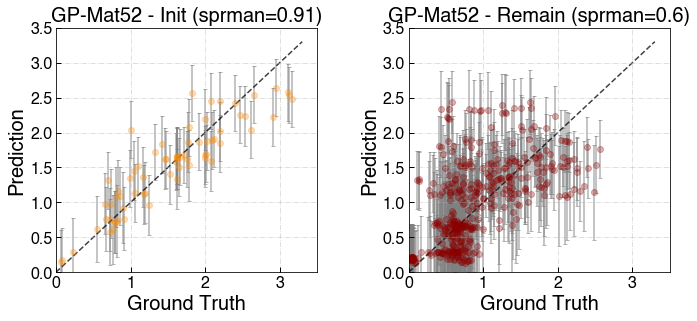

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  3.168620841
Optimization restart 1/3, f = 65.20907208343746
Optimization restart 2/3, f = 62.96335417388423
Optimization restart 3/3, f = 62.86745914272859
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.53057889  |   0.01,10.0   |        
  [2]    |                       1.10963293  |   0.01,10.0   |        
  [3]    |                       2.67080734  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.27265704  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99999491  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.64

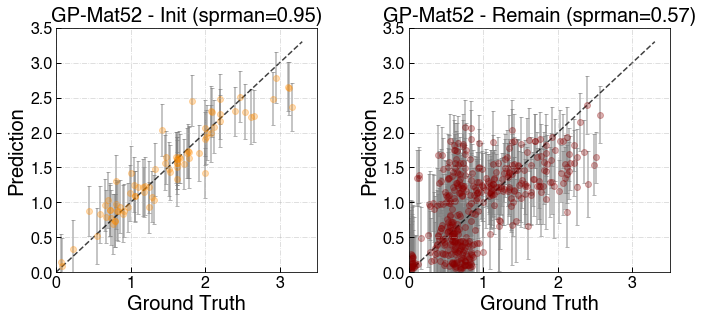

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  3.168620841
Optimization restart 1/3, f = 73.94839483395359
Optimization restart 2/3, f = 73.9483953231961
Optimization restart 3/3, f = 73.94839491240103
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.46618311  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       2.75541967  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                       9.99999917  |   0.01,10.0   |        
  [6]    |                       1.60079216  |   0.01,10.0   |        
  [7]    |                       1.54452683  |   0.01,10.0   |        
  [8]    |                       9.99999999  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.857

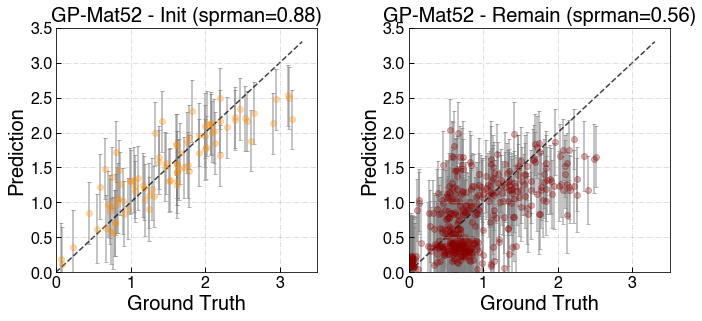

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.168620841
Optimization restart 1/3, f = 75.82941028989794
Optimization restart 2/3, f = 75.82941095040796
Optimization restart 3/3, f = 75.82947563878511
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.75294500  |   0.01,10.0   |        
  [2]    |                       0.75657363  |   0.01,10.0   |        
  [3]    |                       0.21554717  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.61492854  |   0.01,10.0   |        
  [7]    |                       0.40155199  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.7

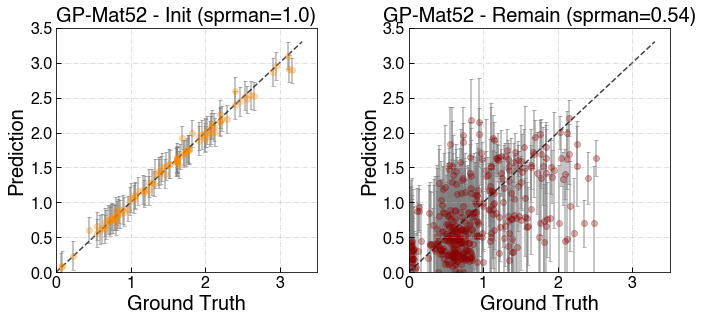

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 84.21970746596219
Optimization restart 2/3, f = 84.21963813445842
Optimization restart 3/3, f = 84.23164573445058
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.10411949  |   0.01,10.0   |        
  [1]    |                       0.60699669  |   0.01,10.0   |        
  [2]    |                       0.80220197  |   0.01,10.0   |        
  [3]    |                       0.26178438  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999428  |   0.01,10.0   |        
  [6]    |                       3.10744712  |   0.01,10.0   |        
  [7]    |                       0.53846298  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       1.40570937  |   0.01,10.0   |        
  [10]   |                       0.5

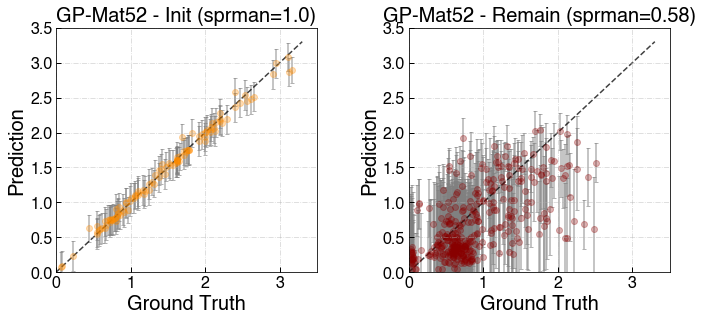

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 93.06580262598308
Optimization restart 2/3, f = 93.07638896178328
Optimization restart 3/3, f = 93.07479808664172
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.19280156  |   0.01,10.0   |        
  [1]    |                       0.51979889  |   0.01,10.0   |        
  [2]    |                       5.20318796  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999407  |   0.01,10.0   |        
  [5]    |                       1.26119697  |   0.01,10.0   |        
  [6]    |                       0.16399872  |   0.01,10.0   |        
  [7]    |                       9.96058049  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.0

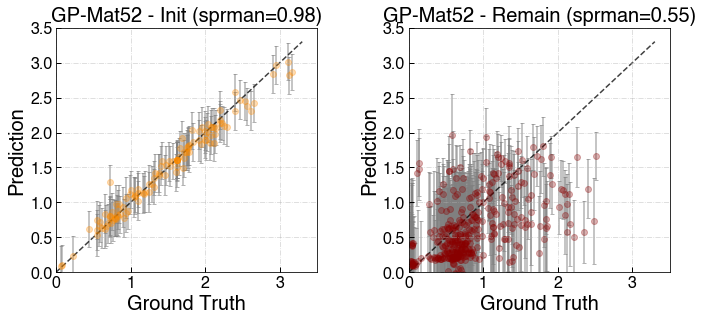

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 95.89215592877234
Optimization restart 2/3, f = 95.89147665028138
Optimization restart 3/3, f = 96.75350963237267
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.93371540  |   0.01,10.0   |        
  [1]    |                       0.62352030  |   0.01,10.0   |        
  [2]    |                       0.82354694  |   0.01,10.0   |        
  [3]    |                       0.29980759  |   0.01,10.0   |        
  [4]    |                       9.99937714  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.58792901  |   0.01,10.0   |        
  [8]    |                       9.99990215  |   0.01,10.0   |        
  [9]    |                       0.96036275  |   0.01,10.0   |        
  [10]   |                       1.1

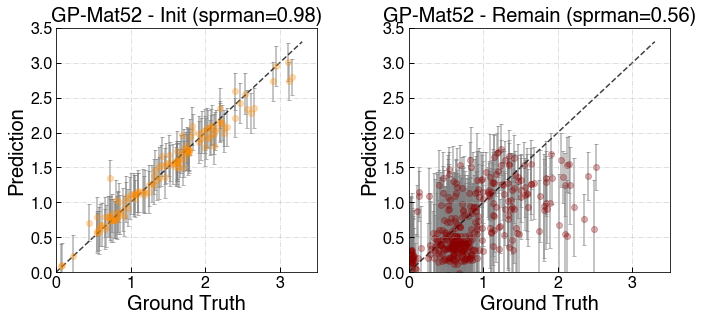

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 100.77024406593173
Optimization restart 2/3, f = 100.92546767439104
Optimization restart 3/3, f = 100.93221605000574
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.04460646  |   0.01,10.0   |        
  [1]    |                       0.60942749  |   0.01,10.0   |        
  [2]    |                       1.12879286  |   0.01,10.0   |        
  [3]    |                       0.30310735  |   0.01,10.0   |        
  [4]    |                       9.99998798  |   0.01,10.0   |        
  [5]    |                       9.99974479  |   0.01,10.0   |        
  [6]    |                       9.99999997  |   0.01,10.0   |        
  [7]    |                       0.61494599  |   0.01,10.0   |        
  [8]    |                       9.99993600  |   0.01,10.0   |        
  [9]    |                       1.09151524  |   0.01,10.0   |        
  [10]   |                       

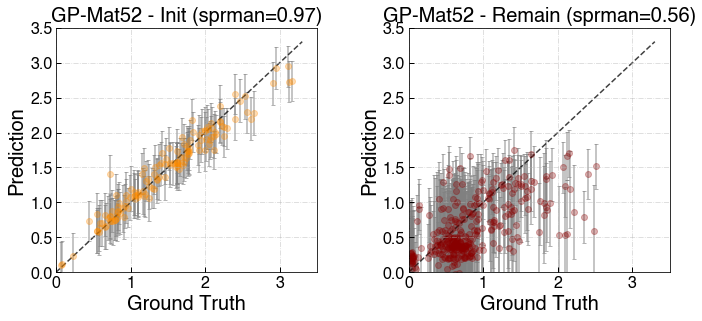

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 108.97904238923009
Optimization restart 2/3, f = 109.43940103686145
Optimization restart 3/3, f = 106.49802671610871
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.98312032  |   0.01,10.0   |        
  [1]    |                       0.50028566  |   0.01,10.0   |        
  [2]    |                       0.83393667  |   0.01,10.0   |        
  [3]    |                       9.99554726  |   0.01,10.0   |        
  [4]    |                       9.98560651  |   0.01,10.0   |        
  [5]    |                       9.99633761  |   0.01,10.0   |        
  [6]    |                       0.90983121  |   0.01,10.0   |        
  [7]    |                       9.99827578  |   0.01,10.0   |        
  [8]    |                       9.99932712  |   0.01,10.0   |        
  [9]    |                       1.25385488  |   0.01,10.0   |        
  [10]   |                       

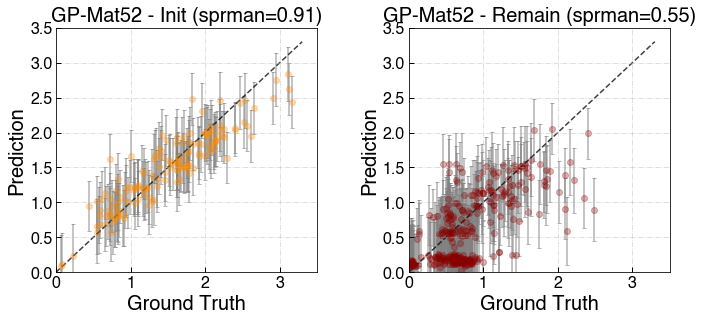

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 108.38381454330002
Optimization restart 2/3, f = 111.36015596124588
Optimization restart 3/3, f = 107.74184060878414
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999745  |   0.01,10.0   |        
  [1]    |                       0.51457419  |   0.01,10.0   |        
  [2]    |                       0.94640324  |   0.01,10.0   |        
  [3]    |                       0.67528960  |   0.01,10.0   |        
  [4]    |                       9.99538466  |   0.01,10.0   |        
  [5]    |                       9.95198938  |   0.01,10.0   |        
  [6]    |                       0.71962960  |   0.01,10.0   |        
  [7]    |                       2.23967046  |   0.01,10.0   |        
  [8]    |                       1.58776555  |   0.01,10.0   |        
  [9]    |                       1.62084742  |   0.01,10.0   |        
  [10]   |                       

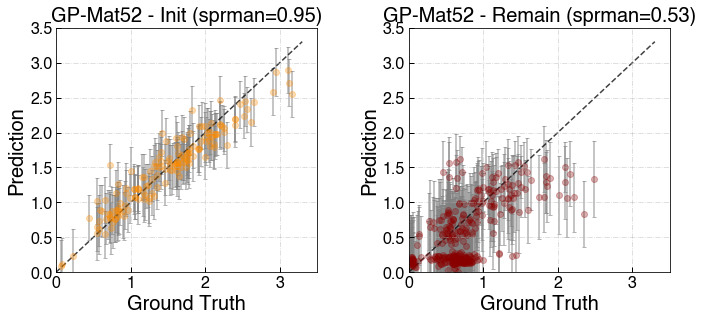

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 116.55158063817387
Optimization restart 2/3, f = 116.79071202886225
Optimization restart 3/3, f = 115.86686832402532
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999962  |   0.01,10.0   |        
  [1]    |                       0.52641951  |   0.01,10.0   |        
  [2]    |                       0.99860243  |   0.01,10.0   |        
  [3]    |                       0.74835295  |   0.01,10.0   |        
  [4]    |                       9.99999975  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.78795995  |   0.01,10.0   |        
  [7]    |                       9.99999933  |   0.01,10.0   |        
  [8]    |                       1.37244383  |   0.01,10.0   |        
  [9]    |                       9.99997737  |   0.01,10.0   |        
  [10]   |                       

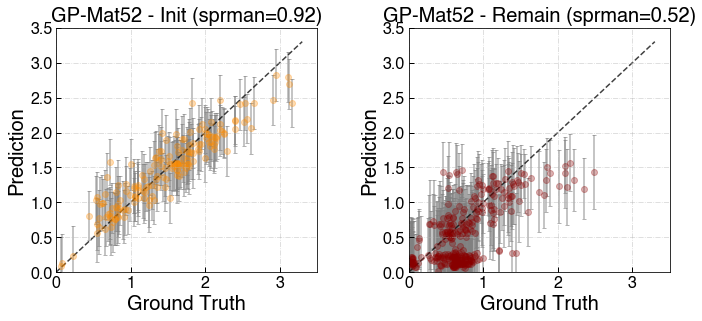

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 127.43747933259715
Optimization restart 2/3, f = 127.43790198336481
Optimization restart 3/3, f = 127.43790196969807
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.49014220  |   0.01,10.0   |        
  [2]    |                       0.94427249  |   0.01,10.0   |        
  [3]    |                       0.58127098  |   0.01,10.0   |        
  [4]    |                       9.91820724  |   0.01,10.0   |        
  [5]    |                       9.99992603  |   0.01,10.0   |        
  [6]    |                       1.13846421  |   0.01,10.0   |        
  [7]    |                       9.99116619  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.60984789  |   0.01,10.0   |        
  [10]   |                       

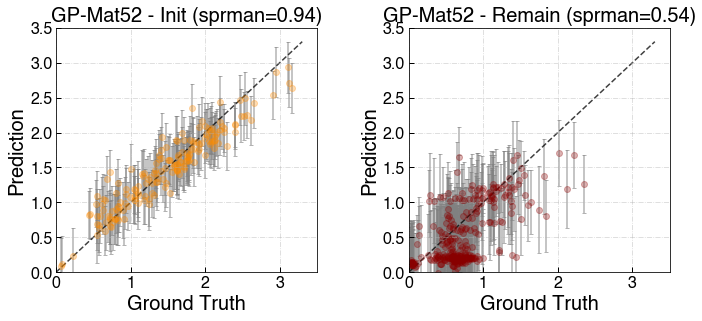

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 135.04002079070884
Optimization restart 2/3, f = 133.78635131005117
Optimization restart 3/3, f = 133.7864789094856
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.46143410  |   0.01,10.0   |        
  [2]    |                       0.91220217  |   0.01,10.0   |        
  [3]    |                       0.74662167  |   0.01,10.0   |        
  [4]    |                       9.99999925  |   0.01,10.0   |        
  [5]    |                       9.97003612  |   0.01,10.0   |        
  [6]    |                       1.71274854  |   0.01,10.0   |        
  [7]    |                       9.99999937  |   0.01,10.0   |        
  [8]    |                       9.99999999  |   0.01,10.0   |        
  [9]    |                       0.42391844  |   0.01,10.0   |        
  [10]   |                       0

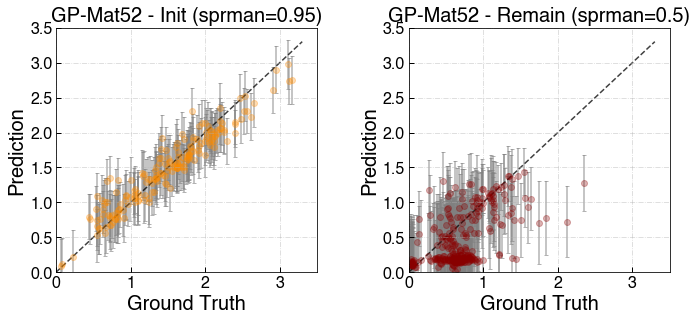

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 138.97270275376704
Optimization restart 2/3, f = 137.29707720617301
Optimization restart 3/3, f = 137.2970784287875
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.53062573  |   0.01,10.0   |        
  [2]    |                       1.08850442  |   0.01,10.0   |        
  [3]    |                       0.98614948  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99967014  |   0.01,10.0   |        
  [6]    |                       0.84755206  |   0.01,10.0   |        
  [7]    |                       9.99999884  |   0.01,10.0   |        
  [8]    |                       1.07901533  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

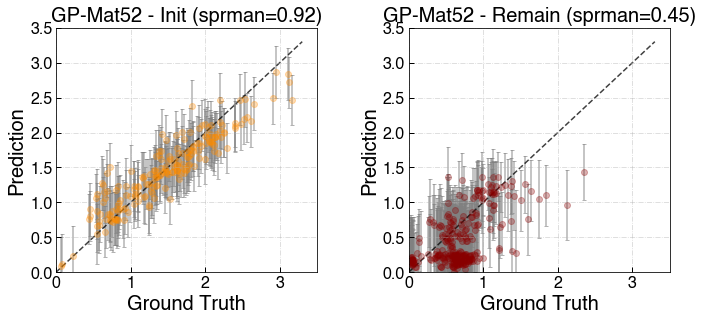

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 143.52150737374984
Optimization restart 2/3, f = 144.619403456707
Optimization restart 3/3, f = 143.65390929230392
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999861  |   0.01,10.0   |        
  [1]    |                       0.48033967  |   0.01,10.0   |        
  [2]    |                       1.22089454  |   0.01,10.0   |        
  [3]    |                       0.67701786  |   0.01,10.0   |        
  [4]    |                       9.99999445  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       1.11147147  |   0.01,10.0   |        
  [7]    |                       9.99987622  |   0.01,10.0   |        
  [8]    |                       9.99999982  |   0.01,10.0   |        
  [9]    |                       0.44594087  |   0.01,10.0   |        
  [10]   |                       0.

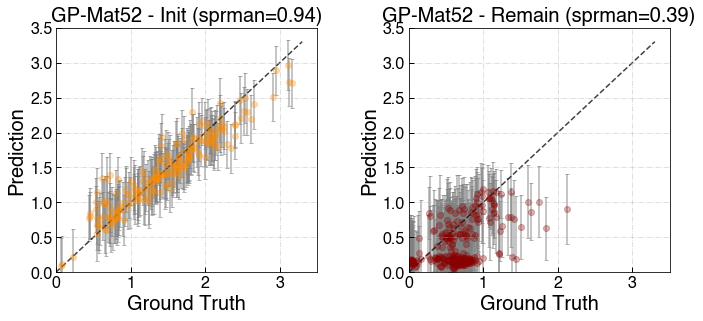

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 148.09779856175726
Optimization restart 2/3, f = 146.19257967136735
Optimization restart 3/3, f = 148.09714183138908
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999997  |   0.01,10.0   |        
  [1]    |                       0.48900249  |   0.01,10.0   |        
  [2]    |                       1.24499688  |   0.01,10.0   |        
  [3]    |                       0.62315411  |   0.01,10.0   |        
  [4]    |                       9.99999920  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.11676486  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.45151482  |   0.01,10.0   |        
  [10]   |                       

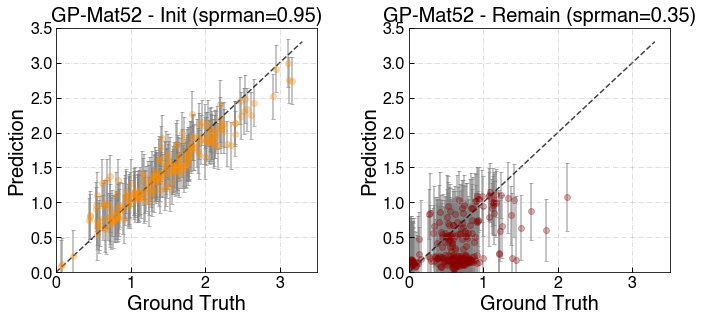

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.56088825
Optimization restart 1/3, f = -11.486788169339953
Optimization restart 2/3, f = -11.486788109716631
Optimization restart 3/3, f = -11.398859017923403
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.04436931  |   0.01,10.0   |        
  [2]    |                       3.91756378  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       1.55295319  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.68559228  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                     

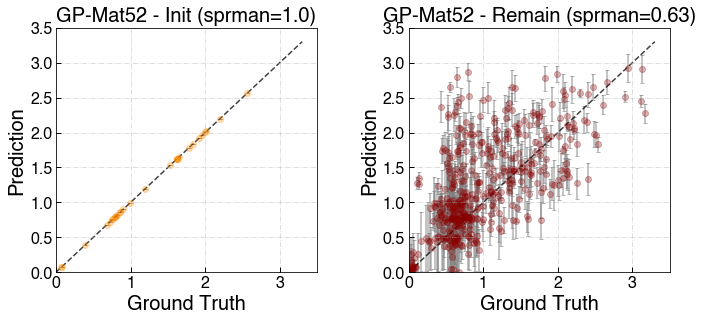

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  3.128147799
Optimization restart 1/3, f = 34.28634825220942
Optimization restart 2/3, f = 34.28634860683545
Optimization restart 3/3, f = 34.286347936903
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.28048436  |   0.01,10.0   |        
  [1]    |                       0.61144645  |   0.01,10.0   |        
  [2]    |                       0.82161578  |   0.01,10.0   |        
  [3]    |                       3.70295082  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999972  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.4189

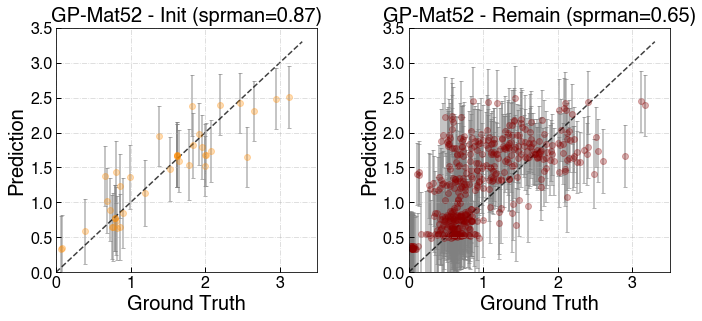

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  3.168620841
Optimization restart 1/3, f = 44.03180265832505
Optimization restart 2/3, f = 44.1050016469254
Optimization restart 3/3, f = 44.03180275384371
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.50314924  |   0.01,10.0   |        
  [2]    |                       1.86196694  |   0.01,10.0   |        
  [3]    |                       0.80194115  |   0.01,10.0   |        
  [4]    |                       9.99999987  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999999  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99999954  |   0.01,10.0   |        
  [9]    |                       9.99999836  |   0.01,10.0   |        
  [10]   |                       0.792

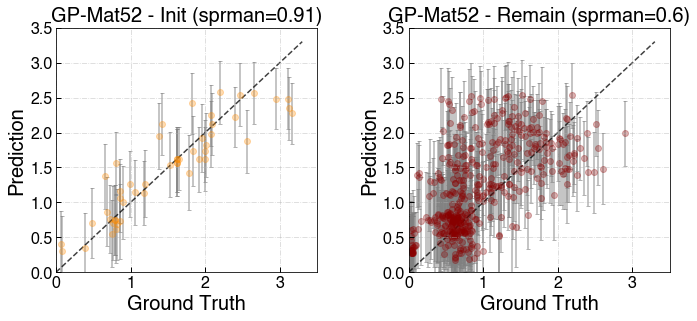

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  3.168620841
Optimization restart 1/3, f = 49.251745211214256
Optimization restart 2/3, f = 49.25174508600855
Optimization restart 3/3, f = 49.25174472501172
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.80993094  |   0.01,10.0   |        
  [1]    |                       1.11167688  |   0.01,10.0   |        
  [2]    |                       0.68825089  |   0.01,10.0   |        
  [3]    |                       0.25740138  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.69002778  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.5

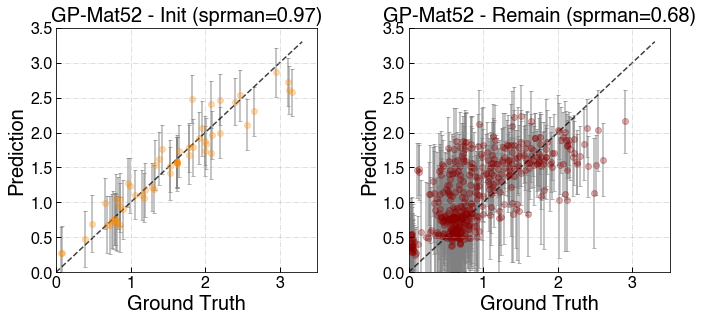

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  3.168620841
Optimization restart 1/3, f = 56.47529596071151
Optimization restart 2/3, f = 57.178245358447185
Optimization restart 3/3, f = 57.17148565991827
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99990609  |   0.01,10.0   |        
  [1]    |                       1.02338336  |   0.01,10.0   |        
  [2]    |                       1.44930241  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       6.36984396  |   0.01,10.0   |        
  [5]    |                       9.82307396  |   0.01,10.0   |        
  [6]    |                       0.22499095  |   0.01,10.0   |        
  [7]    |                       9.99109982  |   0.01,10.0   |        
  [8]    |                       9.99999753  |   0.01,10.0   |        
  [9]    |                       9.99989618  |   0.01,10.0   |        
  [10]   |                       0.2

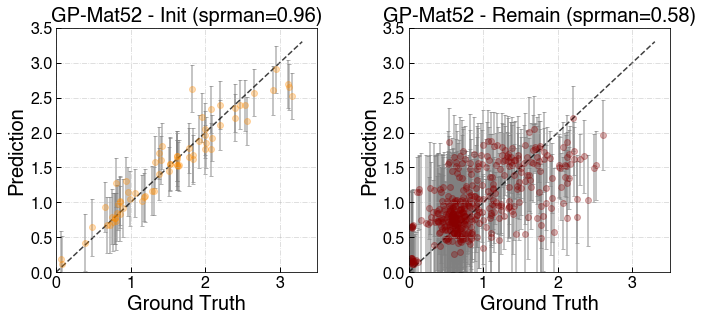

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  3.168620841
Optimization restart 1/3, f = 67.62066098018951
Optimization restart 2/3, f = 66.06997343919599
Optimization restart 3/3, f = 66.06708457210152
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999536  |   0.01,10.0   |        
  [1]    |                       1.43790223  |   0.01,10.0   |        
  [2]    |                       0.79639912  |   0.01,10.0   |        
  [3]    |                       2.04428714  |   0.01,10.0   |        
  [4]    |                       9.99267062  |   0.01,10.0   |        
  [5]    |                       1.20546249  |   0.01,10.0   |        
  [6]    |                       9.99999254  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       7.06069769  |   0.01,10.0   |        
  [9]    |                       9.99986100  |   0.01,10.0   |        
  [10]   |                       1.68

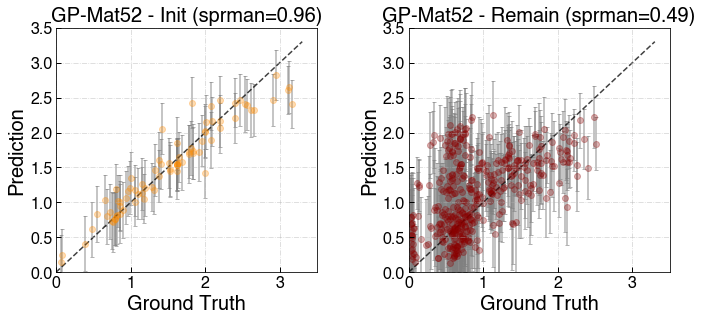

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  3.168620841
Optimization restart 1/3, f = 45.624499800561445
Optimization restart 2/3, f = 45.66897270128005
Optimization restart 3/3, f = 71.80022842289547
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.90982696  |   0.01,10.0   |        
  [1]    |                       0.92347641  |   0.01,10.0   |        
  [2]    |                       9.93949744  |   0.01,10.0   |        
  [3]    |                       2.09483751  |   0.01,10.0   |        
  [4]    |                       9.98261822  |   0.01,10.0   |        
  [5]    |                       9.97471650  |   0.01,10.0   |        
  [6]    |                       0.13027750  |   0.01,10.0   |        
  [7]    |                       9.58603732  |   0.01,10.0   |        
  [8]    |                       9.99998638  |   0.01,10.0   |        
  [9]    |                       1.36588580  |   0.01,10.0   |        
  [10]   |                       0.2

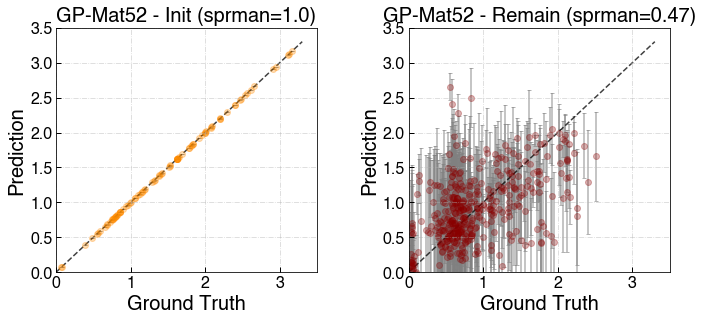

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.168620841
Optimization restart 1/3, f = 83.65915194799514
Optimization restart 2/3, f = 83.65915280869368
Optimization restart 3/3, f = 83.65915227014038
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.99243509  |   0.01,10.0   |        
  [2]    |                       2.77818061  |   0.01,10.0   |        
  [3]    |                       1.01514818  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999998  |   0.01,10.0   |        
  [6]    |                       9.99995879  |   0.01,10.0   |        
  [7]    |                       1.37234038  |   0.01,10.0   |        
  [8]    |                       9.99999994  |   0.01,10.0   |        
  [9]    |                       9.99999996  |   0.01,10.0   |        
  [10]   |                       1.1

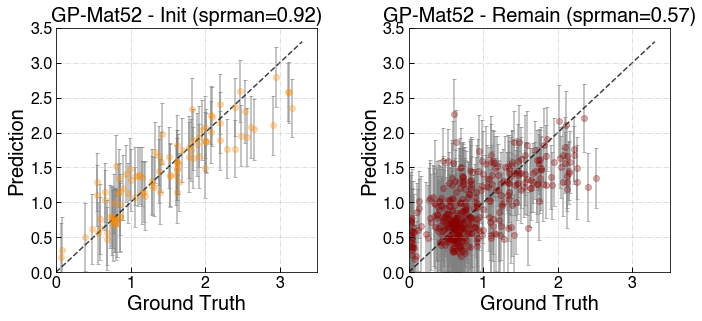

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 88.89825435158897
Optimization restart 2/3, f = 94.21221146258368
Optimization restart 3/3, f = 94.21221225583835
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.71192250  |   0.01,10.0   |        
  [2]    |                       0.74858323  |   0.01,10.0   |        
  [3]    |                       1.85393614  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.67991669  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.1

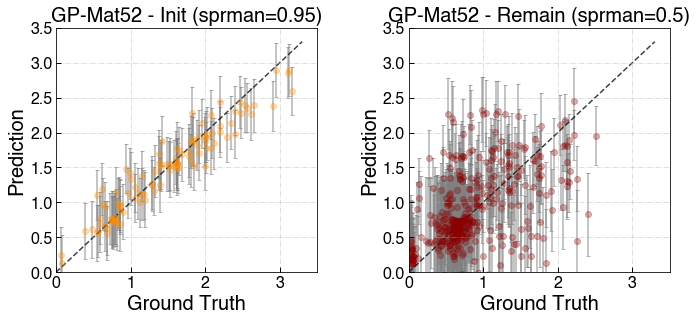

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 100.72452987899914
Optimization restart 2/3, f = 100.76378118516169
Optimization restart 3/3, f = 100.76364201786595
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999986  |   0.01,10.0   |        
  [1]    |                       1.45239151  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.28248047  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999474  |   0.01,10.0   |        
  [7]    |                       0.93461808  |   0.01,10.0   |        
  [8]    |                       9.99999925  |   0.01,10.0   |        
  [9]    |                       1.97611185  |   0.01,10.0   |        
  [10]   |                       

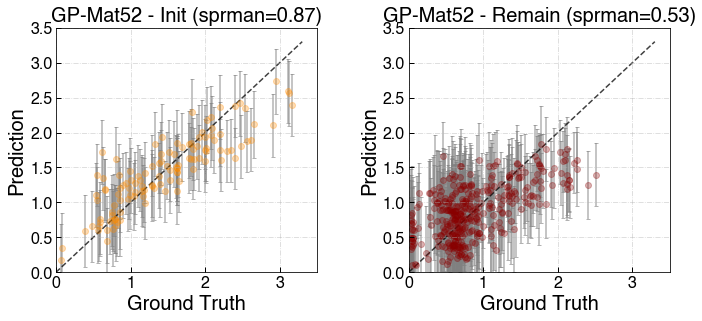

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 107.79335903169112
Optimization restart 2/3, f = 107.79320486436654
Optimization restart 3/3, f = 107.79343470431202
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.34507313  |   0.01,10.0   |        
  [2]    |                       7.30721916  |   0.01,10.0   |        
  [3]    |                       1.10255578  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.77266554  |   0.01,10.0   |        
  [8]    |                       9.99999976  |   0.01,10.0   |        
  [9]    |                       1.31468741  |   0.01,10.0   |        
  [10]   |                       

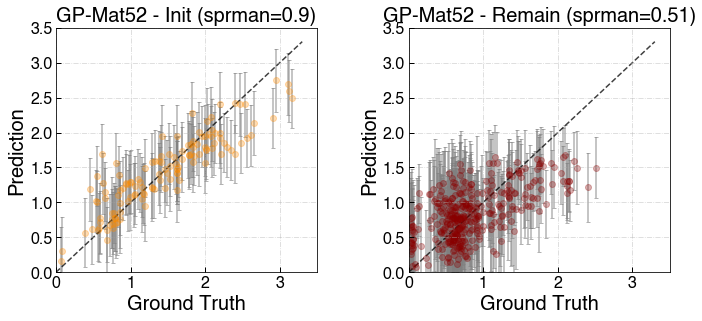

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 111.83982430178253
Optimization restart 2/3, f = 111.83982439159678
Optimization restart 3/3, f = 106.60448600769905
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999803  |   0.01,10.0   |        
  [1]    |                       0.82477400  |   0.01,10.0   |        
  [2]    |                       1.17198306  |   0.01,10.0   |        
  [3]    |                       1.57230224  |   0.01,10.0   |        
  [4]    |                       9.99999957  |   0.01,10.0   |        
  [5]    |                       0.45829483  |   0.01,10.0   |        
  [6]    |                       9.97907604  |   0.01,10.0   |        
  [7]    |                       9.99998763  |   0.01,10.0   |        
  [8]    |                       9.99997699  |   0.01,10.0   |        
  [9]    |                       0.97393252  |   0.01,10.0   |        
  [10]   |                       

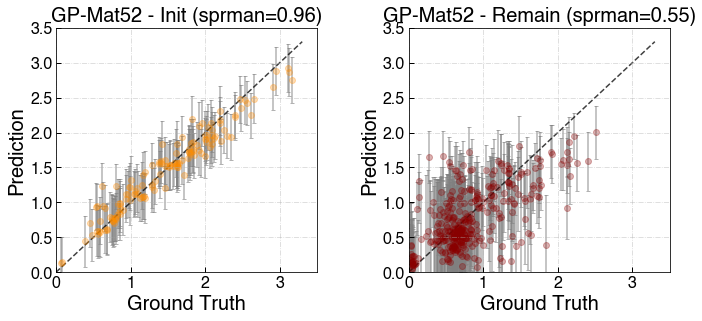

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 120.60101383242886
Optimization restart 2/3, f = 110.76831841267384
Optimization restart 3/3, f = 120.60100199551718
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.37673567  |   0.01,10.0   |        
  [1]    |                       0.77524323  |   0.01,10.0   |        
  [2]    |                       0.98262885  |   0.01,10.0   |        
  [3]    |                       1.43714976  |   0.01,10.0   |        
  [4]    |                       3.12413213  |   0.01,10.0   |        
  [5]    |                       0.59753327  |   0.01,10.0   |        
  [6]    |                       9.99984466  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       2.55115341  |   0.01,10.0   |        
  [9]    |                       0.90239372  |   0.01,10.0   |        
  [10]   |                       

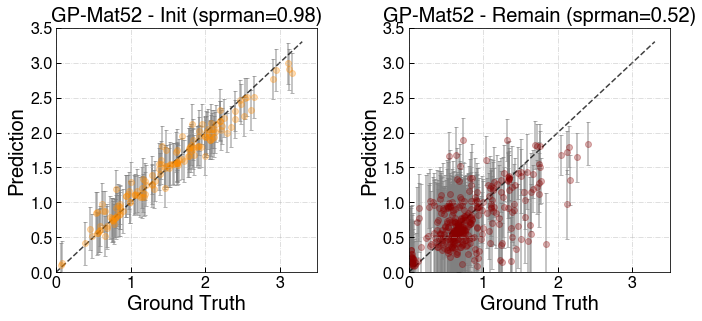

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 121.0349666374922
Optimization restart 2/3, f = 119.06532898565544
Optimization restart 3/3, f = 127.22656767870244
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99625321  |   0.01,10.0   |        
  [1]    |                       0.80378980  |   0.01,10.0   |        
  [2]    |                       1.10499188  |   0.01,10.0   |        
  [3]    |                       2.19274682  |   0.01,10.0   |        
  [4]    |                       9.99539998  |   0.01,10.0   |        
  [5]    |                       0.41623696  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       9.99807642  |   0.01,10.0   |        
  [8]    |                       1.28562689  |   0.01,10.0   |        
  [9]    |                       2.57920556  |   0.01,10.0   |        
  [10]   |                       0

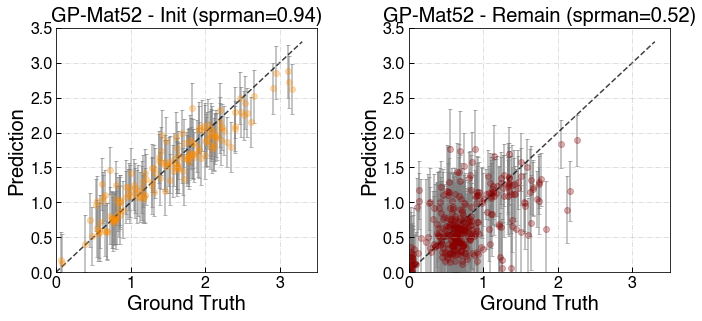

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 122.69613878713704
Optimization restart 2/3, f = 122.69613902931961
Optimization restart 3/3, f = 122.69649412446037
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.73278948  |   0.01,10.0   |        
  [2]    |                       1.37170170  |   0.01,10.0   |        
  [3]    |                       0.98621047  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.49821038  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99996977  |   0.01,10.0   |        
  [9]    |                       1.06228831  |   0.01,10.0   |        
  [10]   |                       

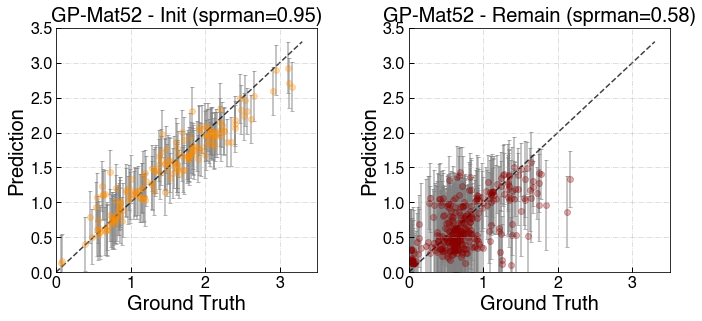

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 125.06892832065512
Optimization restart 2/3, f = 125.06856017679968
Optimization restart 3/3, f = 125.2185534573716
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999908  |   0.01,10.0   |        
  [1]    |                       0.75246261  |   0.01,10.0   |        
  [2]    |                       1.40038848  |   0.01,10.0   |        
  [3]    |                       1.05348974  |   0.01,10.0   |        
  [4]    |                       9.99968858  |   0.01,10.0   |        
  [5]    |                       9.99302052  |   0.01,10.0   |        
  [6]    |                       1.56094467  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99998476  |   0.01,10.0   |        
  [9]    |                       1.28757716  |   0.01,10.0   |        
  [10]   |                       0

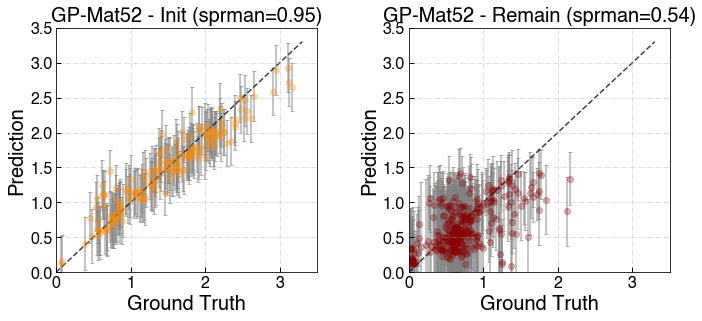

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 132.63767271068792
Optimization restart 2/3, f = 138.62945396609962
Optimization restart 3/3, f = 135.0428918733612
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.72468583  |   0.01,10.0   |        
  [2]    |                       1.35033372  |   0.01,10.0   |        
  [3]    |                       1.05625236  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99998367  |   0.01,10.0   |        
  [6]    |                       1.65062610  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.91415306  |   0.01,10.0   |        
  [10]   |                       0

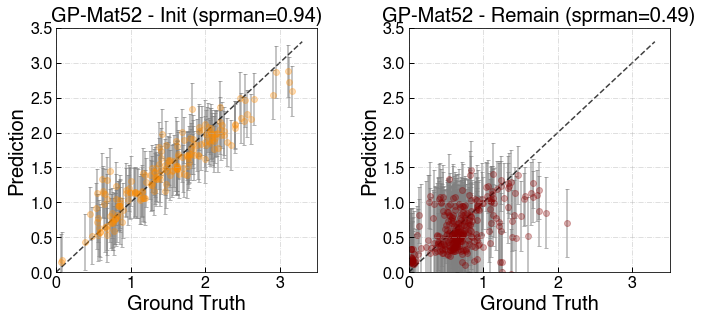

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 137.57276374303157
Optimization restart 2/3, f = 137.57350533798774
Optimization restart 3/3, f = 137.6600009126947
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99983823  |   0.01,10.0   |        
  [1]    |                       0.66626821  |   0.01,10.0   |        
  [2]    |                       1.28848874  |   0.01,10.0   |        
  [3]    |                       0.79732297  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99997173  |   0.01,10.0   |        
  [6]    |                       1.48777112  |   0.01,10.0   |        
  [7]    |                       9.95859477  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.49130388  |   0.01,10.0   |        
  [10]   |                       0

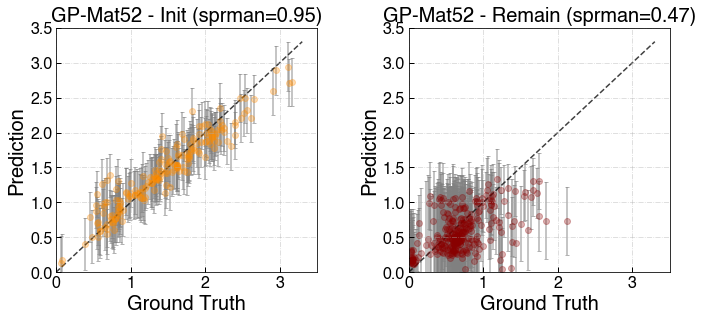

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 142.4188331004633
Optimization restart 2/3, f = 142.41956359772456
Optimization restart 3/3, f = 142.4188329297572
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999985  |   0.01,10.0   |        
  [1]    |                       1.14893681  |   0.01,10.0   |        
  [2]    |                       1.45165632  |   0.01,10.0   |        
  [3]    |                       1.21930868  |   0.01,10.0   |        
  [4]    |                       9.99999996  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       1.49085897  |   0.01,10.0   |        
  [7]    |                       9.99997389  |   0.01,10.0   |        
  [8]    |                       1.32991587  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.

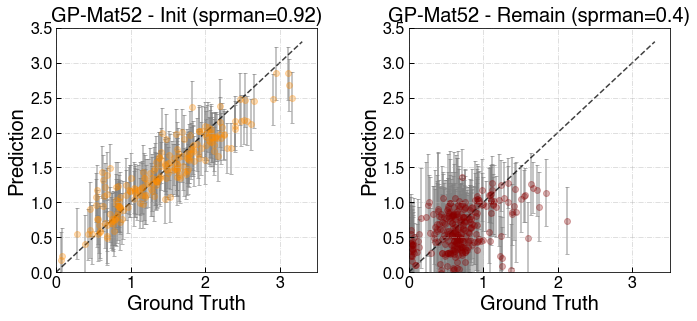

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 147.05369094559893
Optimization restart 2/3, f = 146.7278356181045
Optimization restart 3/3, f = 147.05935692069968
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.96038315  |   0.01,10.0   |        
  [2]    |                       1.15486920  |   0.01,10.0   |        
  [3]    |                       0.73599658  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.98829842  |   0.01,10.0   |        
  [6]    |                       2.15956035  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.43656724  |   0.01,10.0   |        
  [10]   |                       0

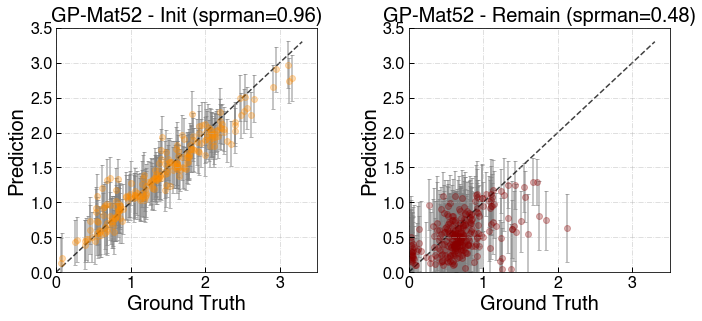

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.21988867
Optimization restart 1/3, f = -16.413473362195333
Optimization restart 2/3, f = -18.424539100261388
Optimization restart 3/3, f = -15.109408260441317
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.56568132  |   0.01,10.0   |        
  [2]    |                       1.07012857  |   0.01,10.0   |        
  [3]    |                       9.99999657  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       1.41486102  |   0.01,10.0   |        
  [6]    |                       9.99999598  |   0.01,10.0   |        
  [7]    |                       0.19460974  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999989  |   0.01,10.0   |        
  [10]   |                     

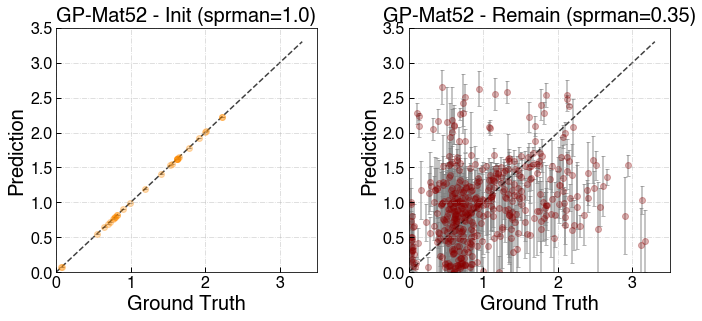

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  2.21988867
Optimization restart 1/3, f = 25.424300126877057
Optimization restart 2/3, f = 25.424300032251928
Optimization restart 3/3, f = 25.426012725616978
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       0.91274258  |   0.01,10.0   |        
  [1]    |                       0.70348644  |   0.01,10.0   |        
  [2]    |                       1.03084594  |   0.01,10.0   |        
  [3]    |                       0.66024133  |   0.01,10.0   |        
  [4]    |                       0.82733489  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.56414940  |   0.01,10.0   |        
  [7]    |                       9.99993259  |   0.01,10.0   |        
  [8]    |                       1.04249402  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       9.

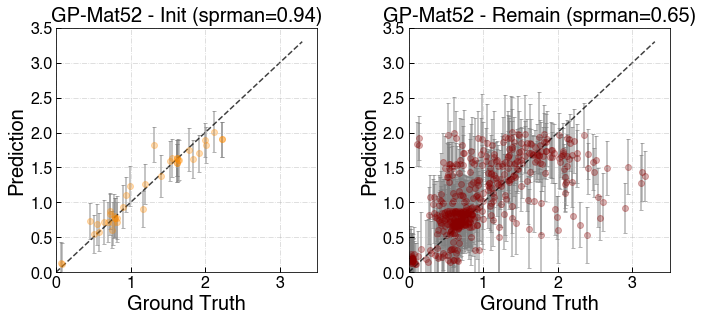

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  2.346627306
Optimization restart 1/3, f = 37.23207558647172
Optimization restart 2/3, f = 37.232076299928764
Optimization restart 3/3, f = 37.232075743282735
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.32293566  |   0.01,10.0   |        
  [1]    |                       0.49734611  |   0.01,10.0   |        
  [2]    |                       6.30314386  |   0.01,10.0   |        
  [3]    |                       1.70160637  |   0.01,10.0   |        
  [4]    |                       9.99999988  |   0.01,10.0   |        
  [5]    |                       2.45856130  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10.

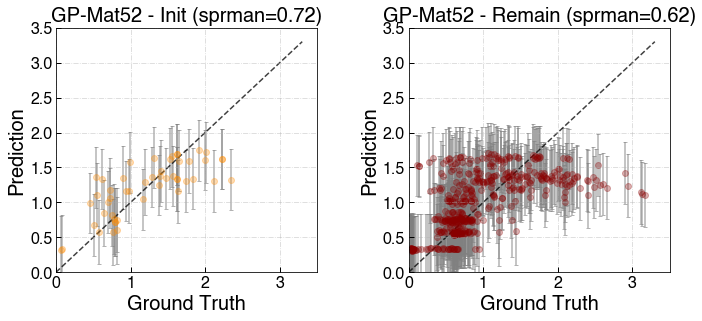

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  2.346627306
Optimization restart 1/3, f = 40.32929769522622
Optimization restart 2/3, f = 40.32929765417219
Optimization restart 3/3, f = 40.32929772546687
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.99286853  |   0.01,10.0   |        
  [1]    |                       0.46464337  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.66772576  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       9.99995085  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10.00

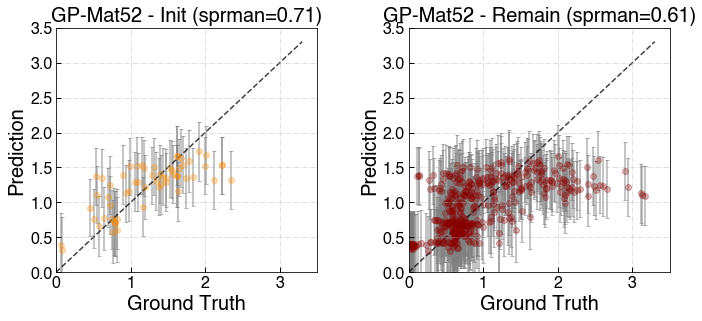

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  2.534359557
Optimization restart 1/3, f = 43.726478271951166
Optimization restart 2/3, f = 43.72647834979547
Optimization restart 3/3, f = 43.72647855879684
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       4.98205749  |   0.01,10.0   |        
  [1]    |                       0.54125309  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.35723080  |   0.01,10.0   |        
  [4]    |                       0.48286661  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       9.99999991  |   0.01,10.0   |        
  [7]    |                       1.11875102  |   0.01,10.0   |        
  [8]    |                       9.99999998  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       2.7

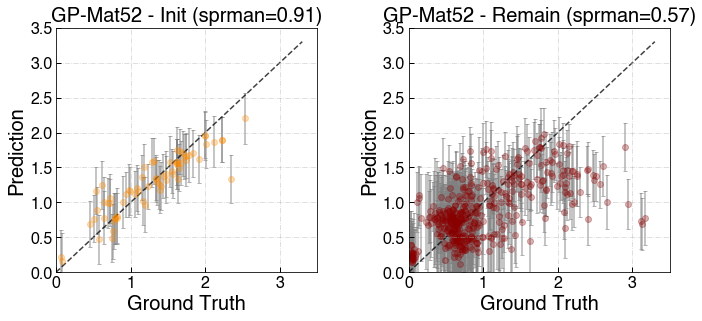

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  2.534359557
Optimization restart 1/3, f = 47.15211003898604
Optimization restart 2/3, f = 46.74057809625714
Optimization restart 3/3, f = 46.740578188119024
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.48381375  |   0.01,10.0   |        
  [1]    |                       0.57008828  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.53335945  |   0.01,10.0   |        
  [4]    |                       0.48770733  |   0.01,10.0   |        
  [5]    |                       9.99999985  |   0.01,10.0   |        
  [6]    |                       9.99994401  |   0.01,10.0   |        
  [7]    |                       1.26976704  |   0.01,10.0   |        
  [8]    |                       9.99999970  |   0.01,10.0   |        
  [9]    |                       9.99999622  |   0.01,10.0   |        
  [10]   |                       4.5

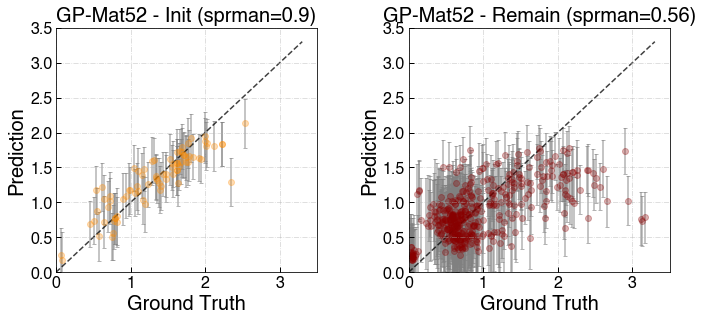

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  2.901818968
Optimization restart 1/3, f = 54.854994412994124
Optimization restart 2/3, f = 54.85499444753627
Optimization restart 3/3, f = 54.857569493102346
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.50101988  |   0.01,10.0   |        
  [1]    |                       0.71559874  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.03870971  |   0.01,10.0   |        
  [4]    |                       1.01690976  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999944  |   0.01,10.0   |        
  [7]    |                       0.92192659  |   0.01,10.0   |        
  [8]    |                       9.99999097  |   0.01,10.0   |        
  [9]    |                       9.99995425  |   0.01,10.0   |        
  [10]   |                       1.

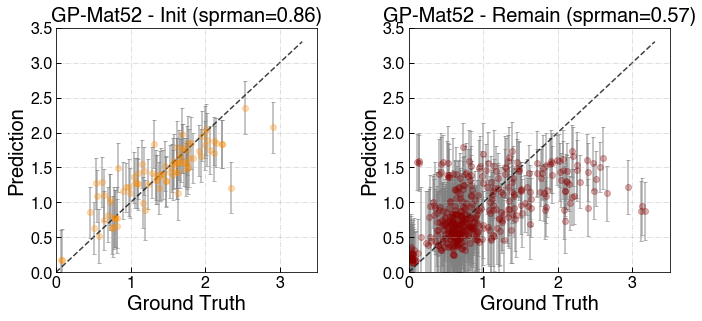

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  2.901818968
Optimization restart 1/3, f = 69.16112952708963
Optimization restart 2/3, f = 67.76409932719821
Optimization restart 3/3, f = 69.16112219929721
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.64594015  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       1.08540558  |   0.01,10.0   |        
  [4]    |                       0.48335149  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       2.39305090  |   0.01,10.0   |        
  [7]    |                       0.93996901  |   0.01,10.0   |        
  [8]    |                       4.52494905  |   0.01,10.0   |        
  [9]    |                       9.99999929  |   0.01,10.0   |        
  [10]   |                       1.5

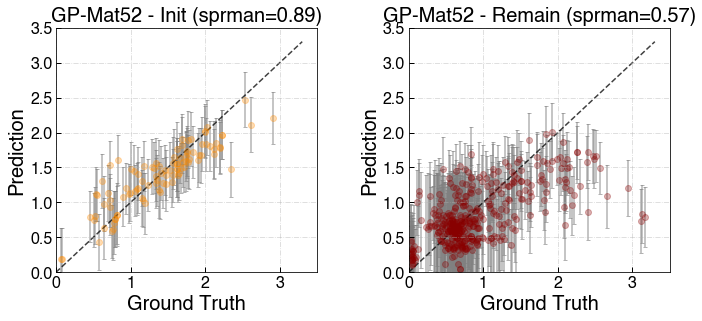

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  2.901818968
Optimization restart 1/3, f = 76.24777467503608
Optimization restart 2/3, f = 77.58152826003416
Optimization restart 3/3, f = 77.2401115262455
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99980703  |   0.01,10.0   |        
  [1]    |                       0.75973120  |   0.01,10.0   |        
  [2]    |                       9.99940589  |   0.01,10.0   |        
  [3]    |                       1.13631704  |   0.01,10.0   |        
  [4]    |                       0.59204973  |   0.01,10.0   |        
  [5]    |                       9.99995795  |   0.01,10.0   |        
  [6]    |                       9.99999925  |   0.01,10.0   |        
  [7]    |                       0.76352238  |   0.01,10.0   |        
  [8]    |                       9.98656555  |   0.01,10.0   |        
  [9]    |                       9.99997272  |   0.01,10.0   |        
  [10]   |                       1.56

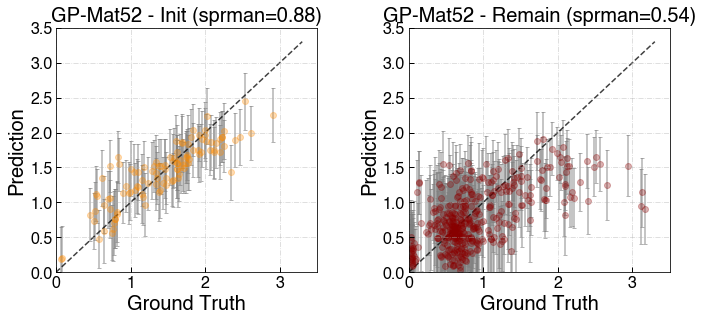

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  2.901818968
Optimization restart 1/3, f = 80.37076704001046
Optimization restart 2/3, f = 80.17529086154659
Optimization restart 3/3, f = 80.37072748322913
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.18767667  |   0.01,10.0   |        
  [1]    |                       0.75295134  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       0.97265850  |   0.01,10.0   |        
  [4]    |                       0.83703987  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99992165  |   0.01,10.0   |        
  [7]    |                       0.68833082  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.7

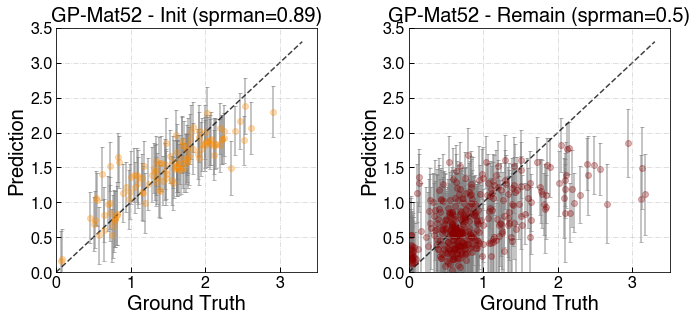

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.128147799
Optimization restart 1/3, f = 95.39191023113146
Optimization restart 2/3, f = 94.52944821387618
Optimization restart 3/3, f = 95.36774772628885
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       2.18403010  |   0.01,10.0   |        
  [1]    |                       0.92912956  |   0.01,10.0   |        
  [2]    |                       0.79387419  |   0.01,10.0   |        
  [3]    |                       0.41541512  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.76983130  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.66708147  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.7

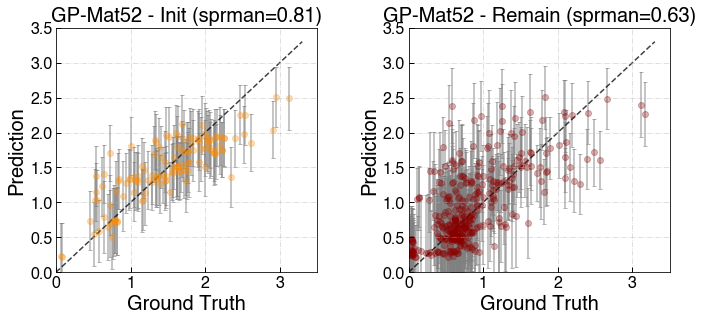

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.128147799
Optimization restart 1/3, f = 101.23753922004956
Optimization restart 2/3, f = 101.53660030692448
Optimization restart 3/3, f = 99.81277272795326
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99998431  |   0.01,10.0   |        
  [1]    |                       1.15928472  |   0.01,10.0   |        
  [2]    |                       1.94036109  |   0.01,10.0   |        
  [3]    |                       0.45747923  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.17788172  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.15883258  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

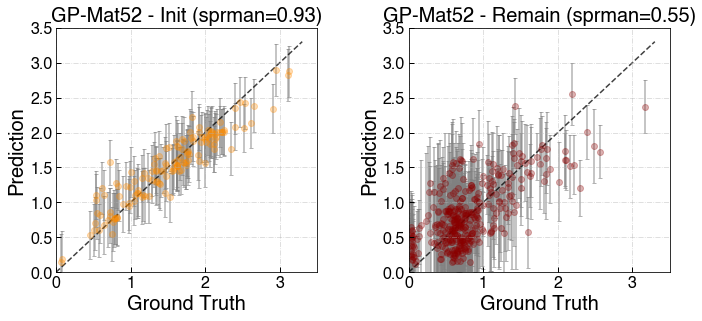

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 114.39753047883904
Optimization restart 2/3, f = 111.06306102293291
Optimization restart 3/3, f = 111.06306379664092
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.80147123  |   0.01,10.0   |        
  [2]    |                       0.76338708  |   0.01,10.0   |        
  [3]    |                       0.73549997  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.15340963  |   0.01,10.0   |        
  [7]    |                       9.94975966  |   0.01,10.0   |        
  [8]    |                       9.99960449  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

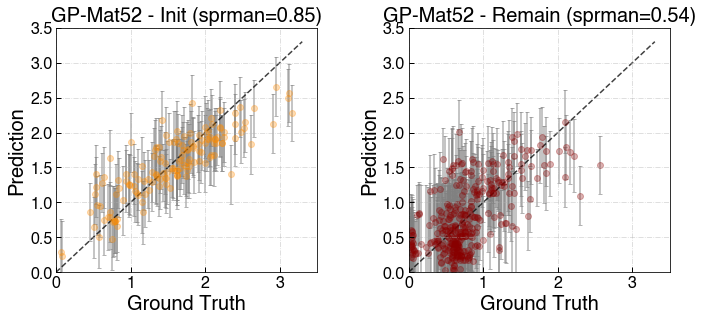

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 118.35264114222538
Optimization restart 2/3, f = 118.71483818570961
Optimization restart 3/3, f = 116.49697009688497
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.77714811  |   0.01,10.0   |        
  [2]    |                       1.01543131  |   0.01,10.0   |        
  [3]    |                       1.49905810  |   0.01,10.0   |        
  [4]    |                       9.99999913  |   0.01,10.0   |        
  [5]    |                       0.34390917  |   0.01,10.0   |        
  [6]    |                       9.99790815  |   0.01,10.0   |        
  [7]    |                       9.99880008  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       0.94203403  |   0.01,10.0   |        
  [10]   |                       

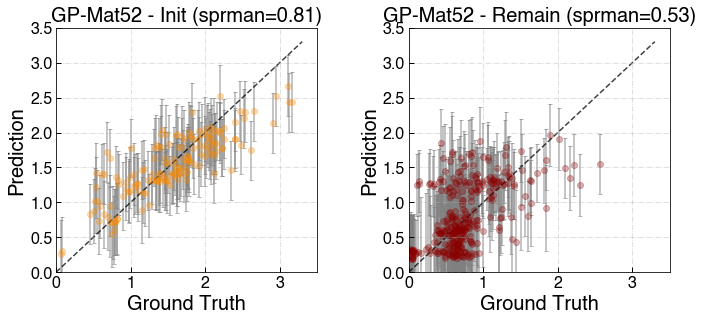

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 121.57017045752717
Optimization restart 2/3, f = 123.97741943751971
Optimization restart 3/3, f = 122.32310560264968
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.04682138  |   0.01,10.0   |        
  [1]    |                       0.81786925  |   0.01,10.0   |        
  [2]    |                       9.99999988  |   0.01,10.0   |        
  [3]    |                       1.58801765  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.41144369  |   0.01,10.0   |        
  [6]    |                       9.99582238  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.76747679  |   0.01,10.0   |        
  [9]    |                       0.83691416  |   0.01,10.0   |        
  [10]   |                       

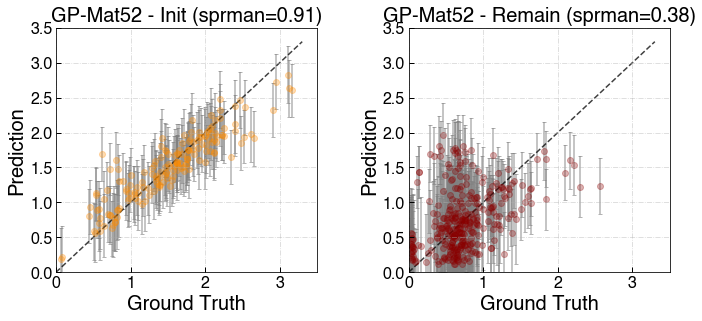

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 127.94999857260953
Optimization restart 2/3, f = 127.9498686370173
Optimization restart 3/3, f = 132.33567689335354
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999999  |   0.01,10.0   |        
  [1]    |                       0.77796450  |   0.01,10.0   |        
  [2]    |                       1.49556564  |   0.01,10.0   |        
  [3]    |                       0.64643965  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99998017  |   0.01,10.0   |        
  [6]    |                       1.08701284  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.27928772  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

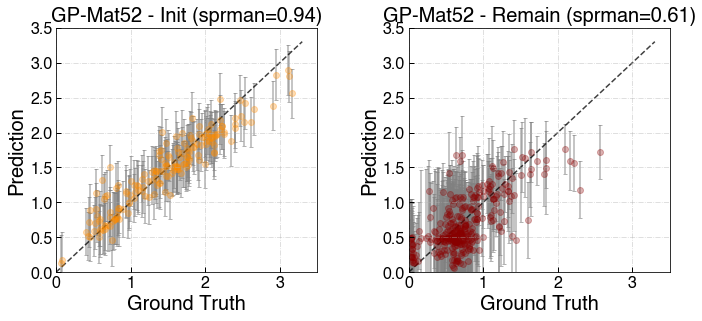

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 135.347822935298
Optimization restart 2/3, f = 139.08507588056932
Optimization restart 3/3, f = 135.3478228083191
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.80326170  |   0.01,10.0   |        
  [2]    |                       1.49653303  |   0.01,10.0   |        
  [3]    |                       0.69611837  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99970673  |   0.01,10.0   |        
  [6]    |                       0.95983277  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.37276274  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.6

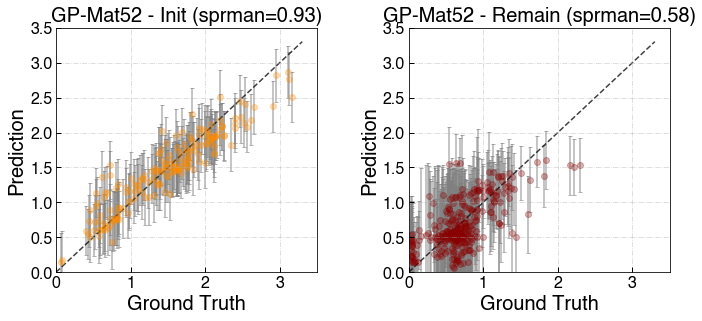

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 149.5755411746755
Optimization restart 2/3, f = 146.12152178793872
Optimization restart 3/3, f = 146.12152348672296
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999997  |   0.01,10.0   |        
  [1]    |                       0.79868887  |   0.01,10.0   |        
  [2]    |                       1.56525943  |   0.01,10.0   |        
  [3]    |                       1.08945436  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99995175  |   0.01,10.0   |        
  [6]    |                       1.05937438  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.27196547  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

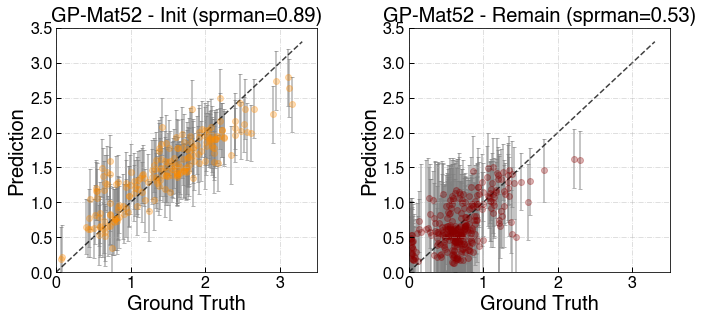

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 154.99504466568303
Optimization restart 2/3, f = 154.35200002060412
Optimization restart 3/3, f = 150.8192326134514
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.77398301  |   0.01,10.0   |        
  [2]    |                       1.43763435  |   0.01,10.0   |        
  [3]    |                       1.01754309  |   0.01,10.0   |        
  [4]    |                       9.99981462  |   0.01,10.0   |        
  [5]    |                       0.74199885  |   0.01,10.0   |        
  [6]    |                       1.30114107  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.31608126  |   0.01,10.0   |        
  [9]    |                       1.40624384  |   0.01,10.0   |        
  [10]   |                       0

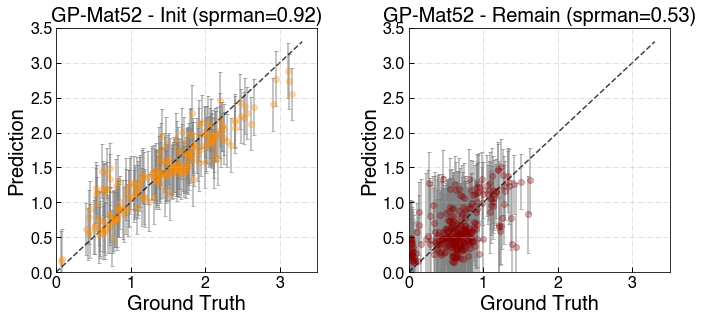

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 156.41815382773152
Optimization restart 2/3, f = 153.02602211116738
Optimization restart 3/3, f = 154.19975206554128
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99933199  |   0.01,10.0   |        
  [1]    |                       0.82482676  |   0.01,10.0   |        
  [2]    |                       1.49636919  |   0.01,10.0   |        
  [3]    |                       1.05036325  |   0.01,10.0   |        
  [4]    |                       9.99999946  |   0.01,10.0   |        
  [5]    |                       9.91528513  |   0.01,10.0   |        
  [6]    |                       0.92951992  |   0.01,10.0   |        
  [7]    |                       9.97645170  |   0.01,10.0   |        
  [8]    |                       1.08451003  |   0.01,10.0   |        
  [9]    |                       9.99265503  |   0.01,10.0   |        
  [10]   |                       

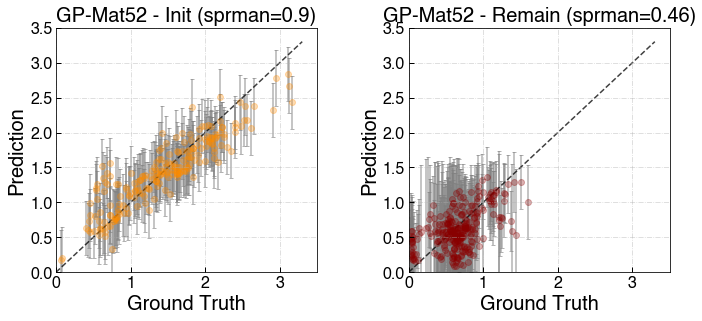

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.12165848
Optimization restart 1/3, f = -10.24040187766262
Optimization restart 2/3, f = -8.286907628931608
Optimization restart 3/3, f = -12.390426775719789
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       9.99986888  |   0.01,10.0   |        
  [2]    |                       0.32531291  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       1.14441102  |   0.01,10.0   |        
  [5]    |                       9.99999989  |   0.01,10.0   |        
  [6]    |                       9.99999988  |   0.01,10.0   |        
  [7]    |                       0.52036312  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

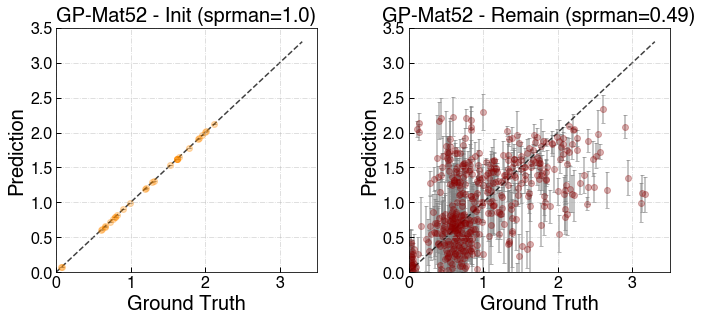

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  2.610829677
Optimization restart 1/3, f = 5.538551749989836
Optimization restart 2/3, f = 5.427815184600675
Optimization restart 3/3, f = 28.346603126155102
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999990  |   0.01,10.0   |        
  [1]    |                       0.01174219  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999859  |   0.01,10.0   |        
  [7]    |                       1.09147683  |   0.01,10.0   |        
  [8]    |                       1.32565847  |   0.01,10.0   |        
  [9]    |                       9.99999706  |   0.01,10.0   |        
  [10]   |                       3.2

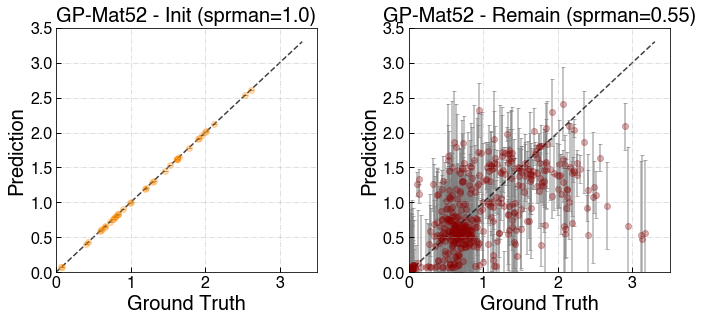

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  2.901818968
Optimization restart 1/3, f = 39.11560024287653
Optimization restart 2/3, f = 41.28623064777376
Optimization restart 3/3, f = 41.18825749696786
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.12400767  |   0.01,10.0   |        
  [2]    |                       0.86523678  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999998  |   0.01,10.0   |        
  [5]    |                       9.99999988  |   0.01,10.0   |        
  [6]    |                       9.99999999  |   0.01,10.0   |        
  [7]    |                       1.20864478  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999957  |   0.01,10.0   |        
  [10]   |                       0.51

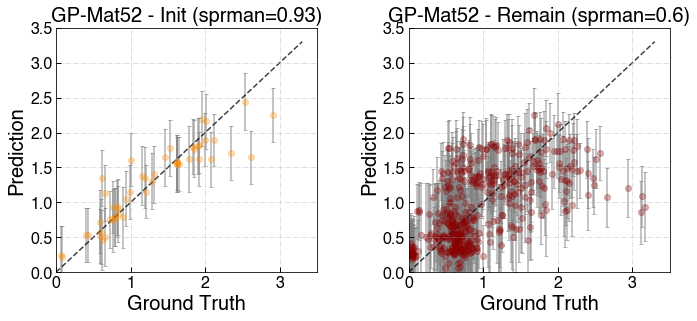

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  2.901818968
Optimization restart 1/3, f = 40.4437283177704
Optimization restart 2/3, f = 40.51690701134249
Optimization restart 3/3, f = 40.51691468153243
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.27054631  |   0.01,10.0   |        
  [2]    |                       0.97720341  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999593  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       1.34272449  |   0.01,10.0   |        
  [8]    |                       2.84270122  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.603

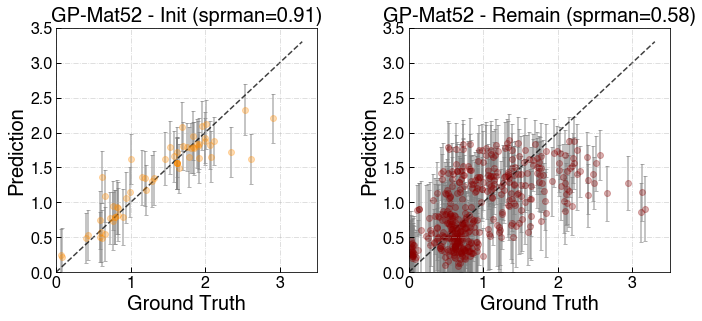

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  2.901818968
Optimization restart 1/3, f = 46.466561842237596
Optimization restart 2/3, f = 46.891200888392646
Optimization restart 3/3, f = 46.4665619383368
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       3.40260641  |   0.01,10.0   |        
  [1]    |                       1.19641596  |   0.01,10.0   |        
  [2]    |                       0.90403545  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999980  |   0.01,10.0   |        
  [5]    |                       9.99999988  |   0.01,10.0   |        
  [6]    |                       9.99999384  |   0.01,10.0   |        
  [7]    |                       1.47911056  |   0.01,10.0   |        
  [8]    |                       2.82353170  |   0.01,10.0   |        
  [9]    |                       9.99999978  |   0.01,10.0   |        
  [10]   |                       0.6

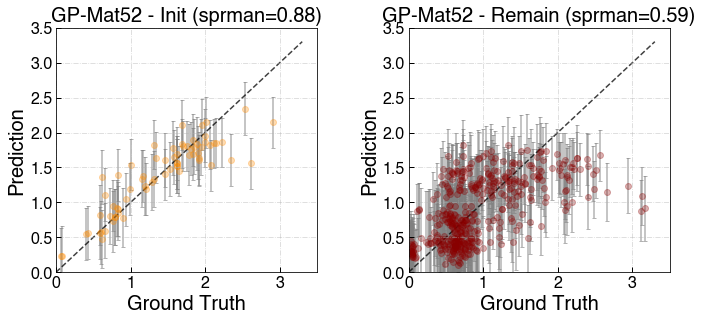

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  2.901818968
Optimization restart 1/3, f = 54.34893558628974
Optimization restart 2/3, f = 54.34173156980236
Optimization restart 3/3, f = 54.3417313379457
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999971  |   0.01,10.0   |        
  [1]    |                       1.27753913  |   0.01,10.0   |        
  [2]    |                       0.81807811  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999989  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99998110  |   0.01,10.0   |        
  [7]    |                       1.64411761  |   0.01,10.0   |        
  [8]    |                       3.27949987  |   0.01,10.0   |        
  [9]    |                       9.99996332  |   0.01,10.0   |        
  [10]   |                       0.771

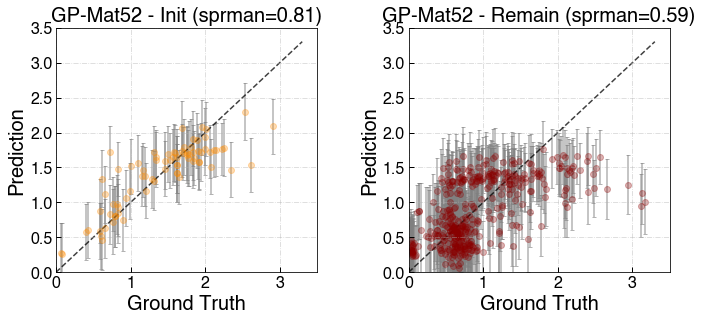

90
highest power so far:  2.901818968


reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


Optimization restart 1/3, f = 61.70338450309465
Optimization restart 2/3, f = 61.70332964261321
Optimization restart 3/3, f = 61.7033845875495
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.91943706  |   0.01,10.0   |        
  [2]    |                       0.89989488  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                       9.99999995  |   0.01,10.0   |        
  [5]    |                       9.99999999  |   0.01,10.0   |        
  [6]    |                       2.77915931  |   0.01,10.0   |        
  [7]    |                       2.33317444  |   0.01,10.0   |        
  [8]    |                       2.02871474  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.59936969  |   0.01,10.0   |        
  [11

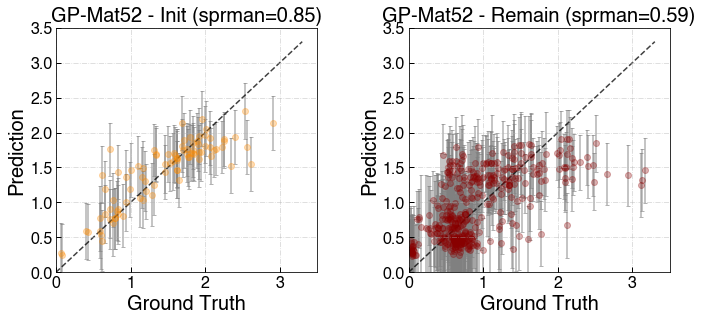

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  2.901818968
Optimization restart 1/3, f = 66.72251810952574
Optimization restart 2/3, f = 66.72251802723216
Optimization restart 3/3, f = 68.61939896949798
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.89950174  |   0.01,10.0   |        
  [2]    |                       0.86802665  |   0.01,10.0   |        
  [3]    |                       9.99997693  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       2.56574971  |   0.01,10.0   |        
  [7]    |                       2.13452785  |   0.01,10.0   |        
  [8]    |                       1.94967340  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.6

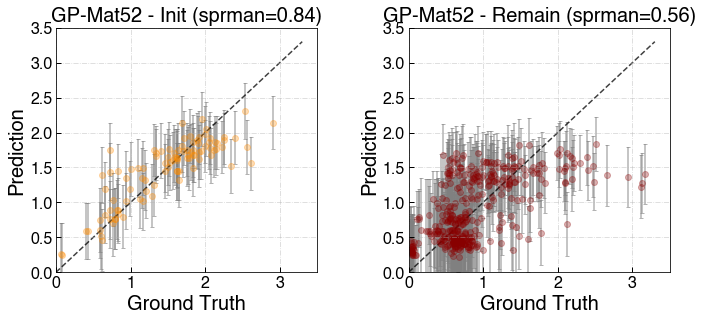

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  2.901818968
Optimization restart 1/3, f = 71.81045301152596
Optimization restart 2/3, f = 76.97285348537636
Optimization restart 3/3, f = 76.97285369337081
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.78262588  |   0.01,10.0   |        
  [2]    |                      10.00000000  |   0.01,10.0   |        
  [3]    |                       0.72512484  |   0.01,10.0   |        
  [4]    |                       0.51313818  |   0.01,10.0   |        
  [5]    |                       9.99996817  |   0.01,10.0   |        
  [6]    |                       9.99999983  |   0.01,10.0   |        
  [7]    |                       0.89762029  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      10.0

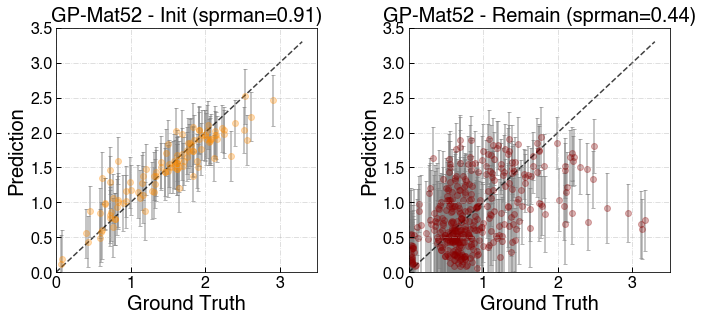

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  2.901818968
Optimization restart 1/3, f = 81.77318997783425
Optimization restart 2/3, f = 81.42197161209553
Optimization restart 3/3, f = 81.42194277028992
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       9.72432708  |   0.01,10.0   |        
  [2]    |                       0.37623210  |   0.01,10.0   |        
  [3]    |                       9.99991988  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999986  |   0.01,10.0   |        
  [6]    |                       9.99999180  |   0.01,10.0   |        
  [7]    |                       1.36845051  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99994158  |   0.01,10.0   |        
  [10]   |                       0.7

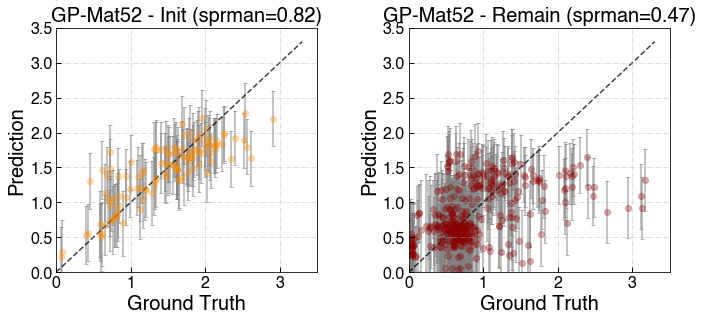

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  2.901818968
Optimization restart 1/3, f = 88.27351594958827
Optimization restart 2/3, f = 87.93705719258473
Optimization restart 3/3, f = 90.8076785937414
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.66728515  |   0.01,10.0   |        
  [2]    |                       1.82656939  |   0.01,10.0   |        
  [3]    |                       9.99763732  |   0.01,10.0   |        
  [4]    |                       0.82504931  |   0.01,10.0   |        
  [5]    |                       0.37654222  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.82135146  |   0.01,10.0   |        
  [8]    |                       1.61545979  |   0.01,10.0   |        
  [9]    |                       1.45972481  |   0.01,10.0   |        
  [10]   |                       1.09

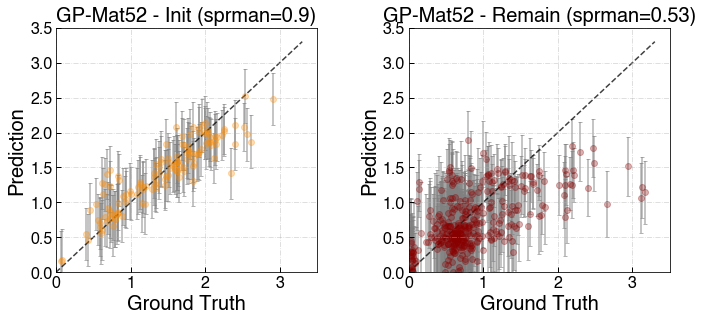

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  2.901818968
Optimization restart 1/3, f = 96.37199744360865
Optimization restart 2/3, f = 96.41036801760498
Optimization restart 3/3, f = 99.26456675680112
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.79383918  |   0.01,10.0   |        
  [2]    |                       1.35540080  |   0.01,10.0   |        
  [3]    |                       9.79496411  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.39292594  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       2.02574452  |   0.01,10.0   |        
  [9]    |                       0.85562675  |   0.01,10.0   |        
  [10]   |                       0.5

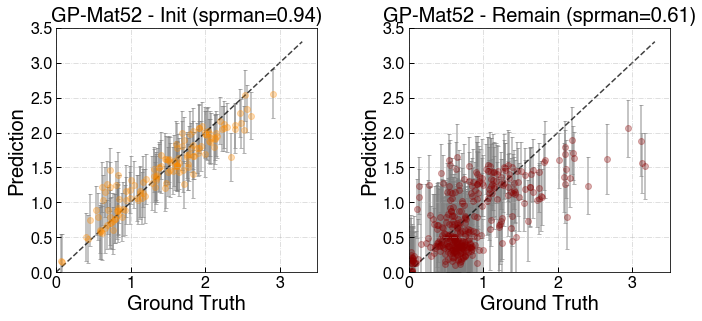

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.112154836
Optimization restart 1/3, f = 106.07117505721291
Optimization restart 2/3, f = 115.63985750201161
Optimization restart 3/3, f = 113.83852184809218
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.76681018  |   0.01,10.0   |        
  [2]    |                       1.75410210  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.37451152  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       9.99972983  |   0.01,10.0   |        
  [9]    |                       0.87868399  |   0.01,10.0   |        
  [10]   |                       

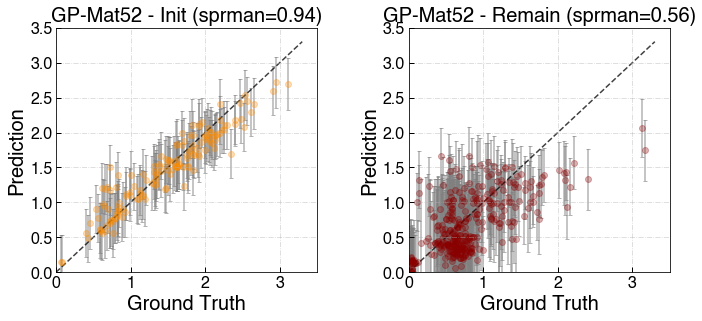

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 120.60393823795843
Optimization restart 2/3, f = 120.3027370084242
Optimization restart 3/3, f = 120.19881128307321
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99114726  |   0.01,10.0   |        
  [1]    |                       0.78490003  |   0.01,10.0   |        
  [2]    |                       1.16290759  |   0.01,10.0   |        
  [3]    |                       1.24124712  |   0.01,10.0   |        
  [4]    |                       9.92676311  |   0.01,10.0   |        
  [5]    |                       0.50623222  |   0.01,10.0   |        
  [6]    |                       1.63736690  |   0.01,10.0   |        
  [7]    |                       9.94033313  |   0.01,10.0   |        
  [8]    |                       9.98860179  |   0.01,10.0   |        
  [9]    |                       0.95370591  |   0.01,10.0   |        
  [10]   |                       0

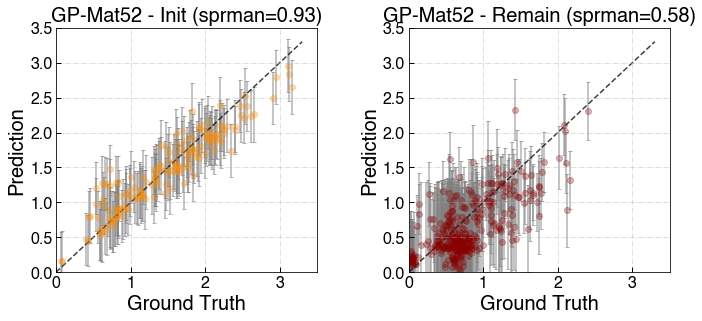

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 127.75574525888355
Optimization restart 2/3, f = 127.77320978043736
Optimization restart 3/3, f = 128.1812045118402
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99980559  |   0.01,10.0   |        
  [1]    |                       0.74657989  |   0.01,10.0   |        
  [2]    |                       1.12468331  |   0.01,10.0   |        
  [3]    |                       9.99960399  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.31348508  |   0.01,10.0   |        
  [6]    |                       0.84448268  |   0.01,10.0   |        
  [7]    |                       9.99252216  |   0.01,10.0   |        
  [8]    |                       1.44859240  |   0.01,10.0   |        
  [9]    |                       1.53144344  |   0.01,10.0   |        
  [10]   |                       0

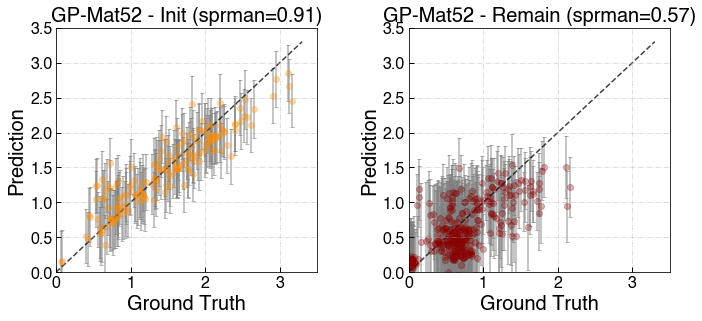

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 135.52108078325824
Optimization restart 2/3, f = 132.45651513346382
Optimization restart 3/3, f = 132.45652684733255
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.86764007  |   0.01,10.0   |        
  [2]    |                       1.29624486  |   0.01,10.0   |        
  [3]    |                       1.33458156  |   0.01,10.0   |        
  [4]    |                       9.99999971  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       1.33786957  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.21115676  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

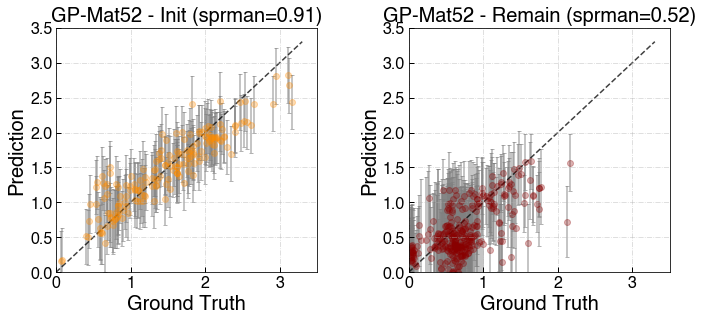

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 134.52698336374584
Optimization restart 2/3, f = 134.52801710833262
Optimization restart 3/3, f = 134.52709644506513
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.85509695  |   0.01,10.0   |        
  [2]    |                       1.21838145  |   0.01,10.0   |        
  [3]    |                       1.37089666  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999617  |   0.01,10.0   |        
  [6]    |                       1.31522702  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.12603712  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

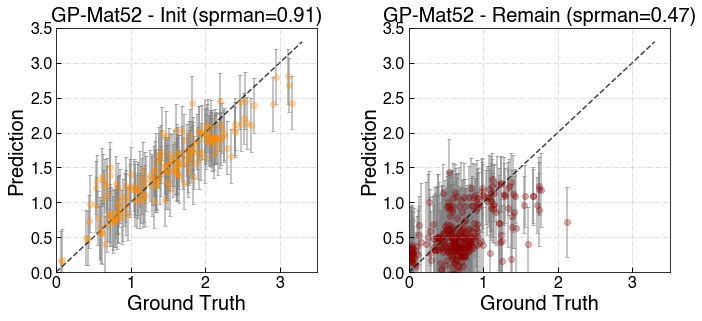

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 138.36144870853855
Optimization restart 2/3, f = 138.36108995298684
Optimization restart 3/3, f = 138.30901315598558
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.83240087  |   0.01,10.0   |        
  [2]    |                       1.08700352  |   0.01,10.0   |        
  [3]    |                       1.18761503  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       1.09348962  |   0.01,10.0   |        
  [6]    |                       2.19842009  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       2.45228720  |   0.01,10.0   |        
  [9]    |                       0.96013112  |   0.01,10.0   |        
  [10]   |                       

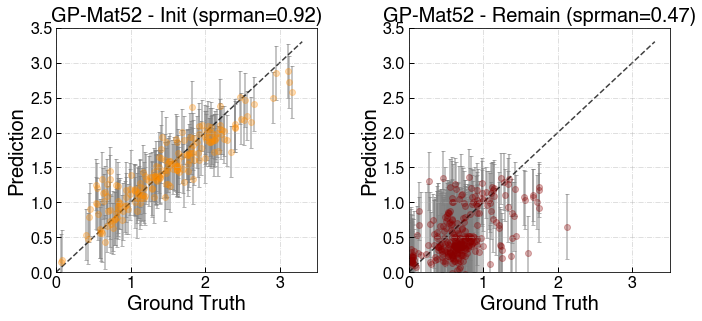

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 141.69246169794945
Optimization restart 2/3, f = 141.69246153374044
Optimization restart 3/3, f = 141.6924617099974
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.87907428  |   0.01,10.0   |        
  [2]    |                       1.25110861  |   0.01,10.0   |        
  [3]    |                       1.28584328  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99996912  |   0.01,10.0   |        
  [6]    |                       1.24691230  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       1.04894523  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0

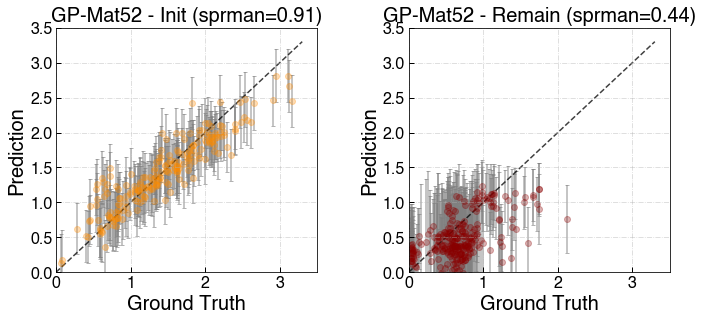

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 144.6140002122616
Optimization restart 2/3, f = 144.6188986057523
Optimization restart 3/3, f = 144.61889882420843
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.88176748  |   0.01,10.0   |        
  [2]    |                       1.30185220  |   0.01,10.0   |        
  [3]    |                       1.20409176  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99975021  |   0.01,10.0   |        
  [6]    |                       1.24367885  |   0.01,10.0   |        
  [7]    |                       9.99999759  |   0.01,10.0   |        
  [8]    |                       1.05737819  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       0.

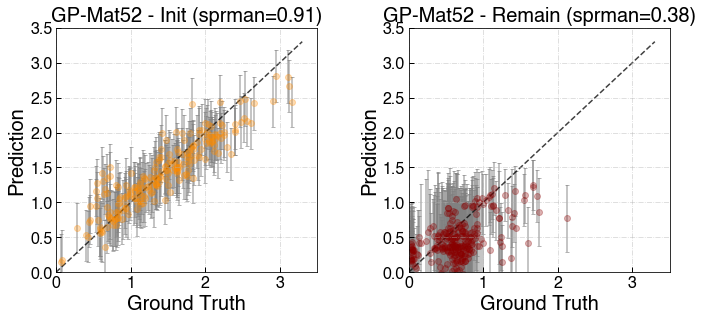

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


230
highest power so far:  2.016576623
Optimization restart 1/3, f = -19.532123660633033
Optimization restart 2/3, f = -19.54550116318608
Optimization restart 3/3, f = -18.99281933107058
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.03816630  |   0.01,10.0   |        
  [1]    |                       1.00160157  |   0.01,10.0   |        
  [2]    |                       2.47513279  |   0.01,10.0   |        
  [3]    |                       3.18364999  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99999026  |   0.01,10.0   |        
  [6]    |                       3.19930407  |   0.01,10.0   |        
  [7]    |                       9.99999463  |   0.01,10.0   |        
  [8]    |                       1.00624351  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                      

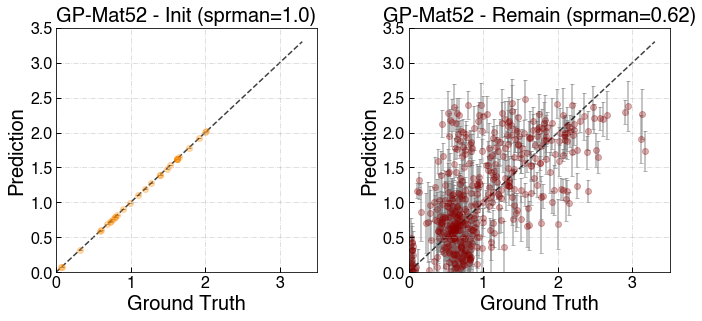

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


40
highest power so far:  3.128147799
Optimization restart 1/3, f = -4.693581175650152
Optimization restart 2/3, f = -2.650435532606185
Optimization restart 3/3, f = -2.3252317764713943
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.60854220  |   0.01,10.0   |        
  [2]    |                       0.90703575  |   0.01,10.0   |        
  [3]    |                       9.99999800  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                       9.99999989  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.30879662  |   0.01,10.0   |        
  [9]    |                       2.95250856  |   0.01,10.0   |        
  [10]   |                       

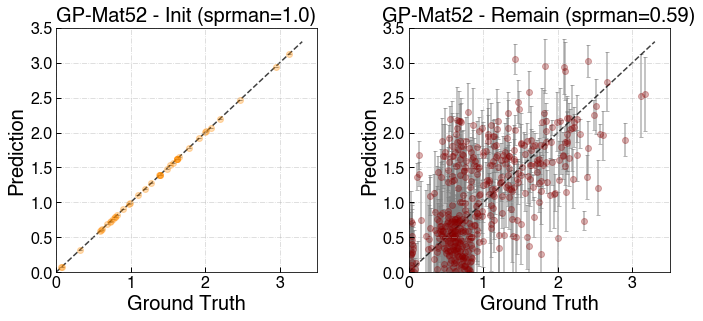

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


50
highest power so far:  3.168620841
Optimization restart 1/3, f = 42.47413098791334
Optimization restart 2/3, f = 42.42611543902706
Optimization restart 3/3, f = 42.46827024398541
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       1.65460970  |   0.01,10.0   |        
  [1]    |                       0.58278885  |   0.01,10.0   |        
  [2]    |                       3.00530548  |   0.01,10.0   |        
  [3]    |                       9.99999986  |   0.01,10.0   |        
  [4]    |                       9.99999771  |   0.01,10.0   |        
  [5]    |                       9.99999956  |   0.01,10.0   |        
  [6]    |                       2.98007756  |   0.01,10.0   |        
  [7]    |                       9.99997886  |   0.01,10.0   |        
  [8]    |                       9.99999985  |   0.01,10.0   |        
  [9]    |                       9.99997852  |   0.01,10.0   |        
  [10]   |                       0.61

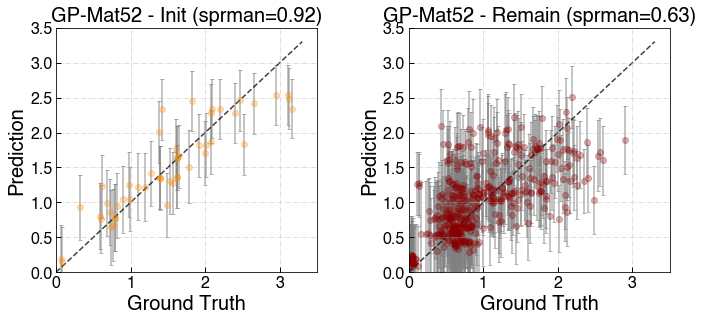

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


60
highest power so far:  3.168620841
Optimization restart 1/3, f = 48.36880590045486
Optimization restart 2/3, f = 48.36880601474911
Optimization restart 3/3, f = 48.368806122784186
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       4.52914949  |   0.01,10.0   |        
  [1]    |                       0.50979608  |   0.01,10.0   |        
  [2]    |                       0.87641727  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       0.97475118  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       1.8

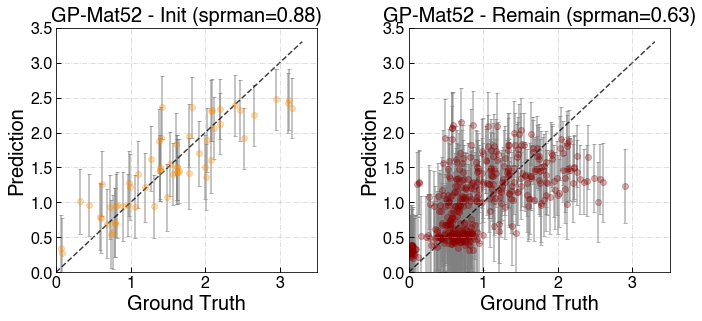

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


70
highest power so far:  3.168620841
Optimization restart 1/3, f = 52.9868565776448
Optimization restart 2/3, f = 51.42085291504086
Optimization restart 3/3, f = 51.41068149571894
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.68378477  |   0.01,10.0   |        
  [2]    |                       1.64516988  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99992992  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                       0.36548451  |   0.01,10.0   |        
  [8]    |                       0.28952829  |   0.01,10.0   |        
  [9]    |                       0.73539328  |   0.01,10.0   |        
  [10]   |                      10.000

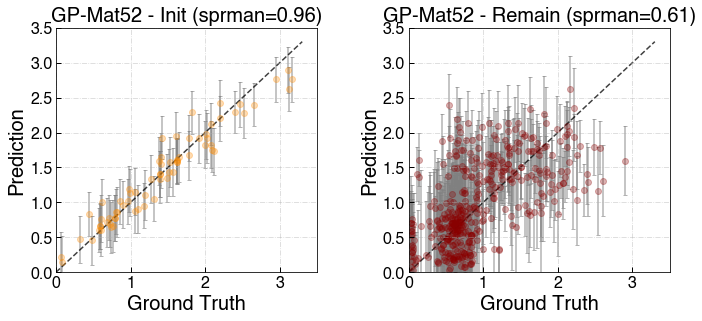

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


80
highest power so far:  3.168620841
Optimization restart 1/3, f = 61.30769918243781
Optimization restart 2/3, f = 62.805189935357205
Optimization restart 3/3, f = 61.307705821849524
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.17764606  |   0.01,10.0   |        
  [2]    |                       1.49747443  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                       9.99999947  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.47688871  |   0.01,10.0   |        
  [9]    |                       0.36968068  |   0.01,10.0   |        
  [10]   |                      10.

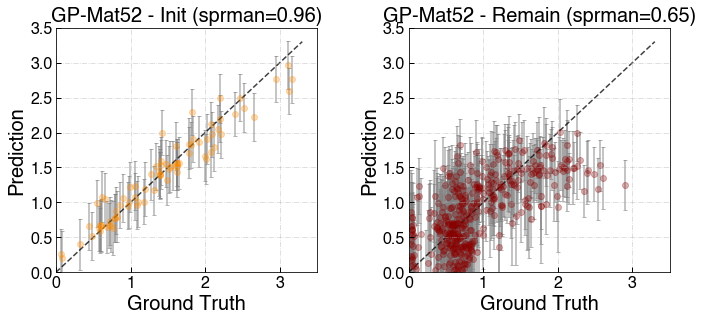

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


90
highest power so far:  3.168620841
Optimization restart 1/3, f = 69.65898627996407
Optimization restart 2/3, f = 66.94247250996472
Optimization restart 3/3, f = 70.66112238739511
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.02567932  |   0.01,10.0   |        
  [2]    |                       0.77488149  |   0.01,10.0   |        
  [3]    |                      10.00000000  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                      10.00000000  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.43650671  |   0.01,10.0   |        
  [9]    |                       0.83014704  |   0.01,10.0   |        
  [10]   |                      10.00

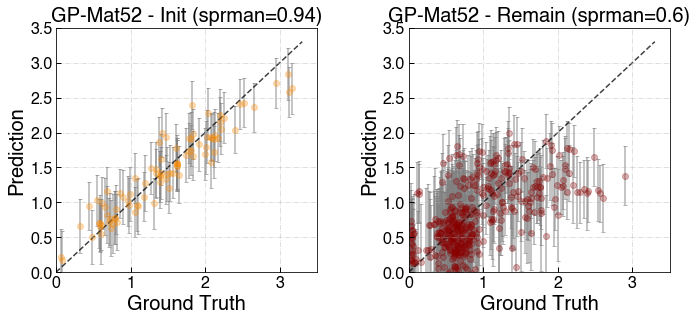

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


100
highest power so far:  3.168620841
Optimization restart 1/3, f = 73.6759949749241
Optimization restart 2/3, f = 73.70468989580016
Optimization restart 3/3, f = 76.01197652969978
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99998026  |   0.01,10.0   |        
  [1]    |                       0.72044655  |   0.01,10.0   |        
  [2]    |                       2.22578490  |   0.01,10.0   |        
  [3]    |                       1.50409985  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99475889  |   0.01,10.0   |        
  [6]    |                       1.42777375  |   0.01,10.0   |        
  [7]    |                       9.99878228  |   0.01,10.0   |        
  [8]    |                       0.52925626  |   0.01,10.0   |        
  [9]    |                       9.81128439  |   0.01,10.0   |        
  [10]   |                       0.27

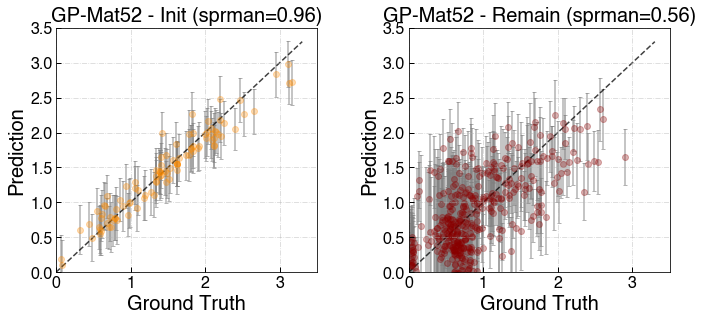

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


110
highest power so far:  3.168620841
Optimization restart 1/3, f = 75.02626026371433
Optimization restart 2/3, f = 74.85740660729115
Optimization restart 3/3, f = 75.19572445468988
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999911  |   0.01,10.0   |        
  [1]    |                       0.74582735  |   0.01,10.0   |        
  [2]    |                       9.99666224  |   0.01,10.0   |        
  [3]    |                       1.45776932  |   0.01,10.0   |        
  [4]    |                       9.96661660  |   0.01,10.0   |        
  [5]    |                       9.99875017  |   0.01,10.0   |        
  [6]    |                       2.17093130  |   0.01,10.0   |        
  [7]    |                       9.99475259  |   0.01,10.0   |        
  [8]    |                       0.56260237  |   0.01,10.0   |        
  [9]    |                       9.95026364  |   0.01,10.0   |        
  [10]   |                       0.2

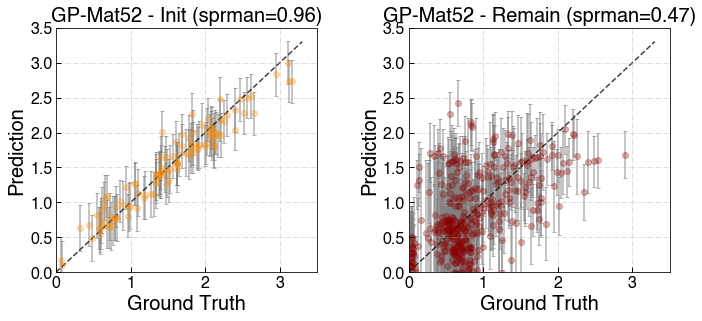

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


120
highest power so far:  3.168620841
Optimization restart 1/3, f = 95.1904083089897
Optimization restart 2/3, f = 93.26247869824093
Optimization restart 3/3, f = 94.34955396137127
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99999886  |   0.01,10.0   |        
  [1]    |                       0.61975223  |   0.01,10.0   |        
  [2]    |                       0.74992663  |   0.01,10.0   |        
  [3]    |                       0.91047451  |   0.01,10.0   |        
  [4]    |                       9.99999945  |   0.01,10.0   |        
  [5]    |                       1.09314568  |   0.01,10.0   |        
  [6]    |                       0.74987689  |   0.01,10.0   |        
  [7]    |                       0.68289759  |   0.01,10.0   |        
  [8]    |                      10.00000000  |   0.01,10.0   |        
  [9]    |                       9.99999958  |   0.01,10.0   |        
  [10]   |                       0.68

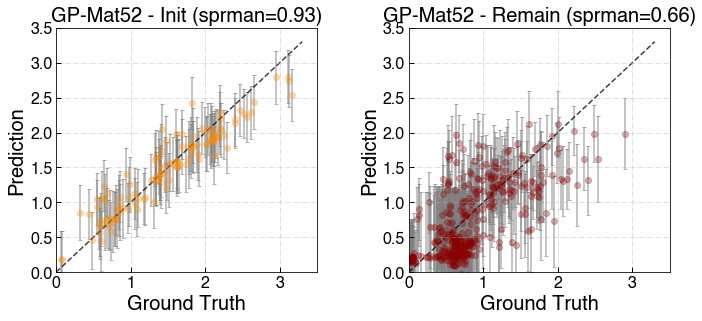

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


130
highest power so far:  3.168620841
Optimization restart 1/3, f = 98.65125920720406
Optimization restart 2/3, f = 99.1672760122619
Optimization restart 3/3, f = 100.50035581175723
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       1.12827789  |   0.01,10.0   |        
  [2]    |                       1.09785253  |   0.01,10.0   |        
  [3]    |                       2.03888512  |   0.01,10.0   |        
  [4]    |                       9.99999999  |   0.01,10.0   |        
  [5]    |                       0.72135589  |   0.01,10.0   |        
  [6]    |                       9.99877769  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.64668473  |   0.01,10.0   |        
  [9]    |                       0.85221512  |   0.01,10.0   |        
  [10]   |                       1.6

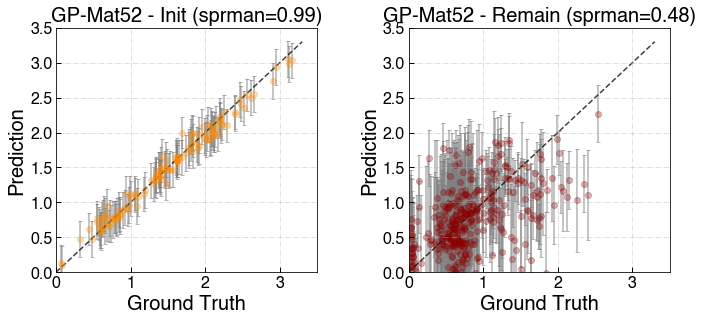

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


140
highest power so far:  3.168620841
Optimization restart 1/3, f = 101.06374377410552
Optimization restart 2/3, f = 103.4461254874456
Optimization restart 3/3, f = 103.45031270816328
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99997704  |   0.01,10.0   |        
  [1]    |                       1.04800986  |   0.01,10.0   |        
  [2]    |                       1.04392235  |   0.01,10.0   |        
  [3]    |                       1.66391835  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.60513011  |   0.01,10.0   |        
  [6]    |                      10.00000000  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.71430572  |   0.01,10.0   |        
  [9]    |                       1.09235261  |   0.01,10.0   |        
  [10]   |                       0

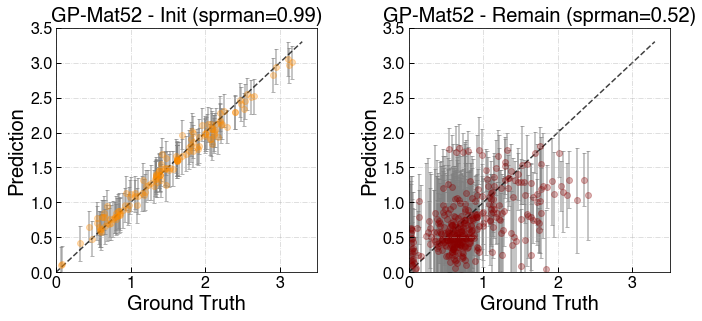

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


150
highest power so far:  3.168620841
Optimization restart 1/3, f = 115.46471709310295
Optimization restart 2/3, f = 115.46472146185988
Optimization restart 3/3, f = 115.46471726880968
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                      10.00000000  |   0.01,10.0   |        
  [1]    |                       0.73680472  |   0.01,10.0   |        
  [2]    |                       0.99506367  |   0.01,10.0   |        
  [3]    |                       1.29661589  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       9.99964111  |   0.01,10.0   |        
  [6]    |                       1.00905399  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.77393261  |   0.01,10.0   |        
  [9]    |                      10.00000000  |   0.01,10.0   |        
  [10]   |                       

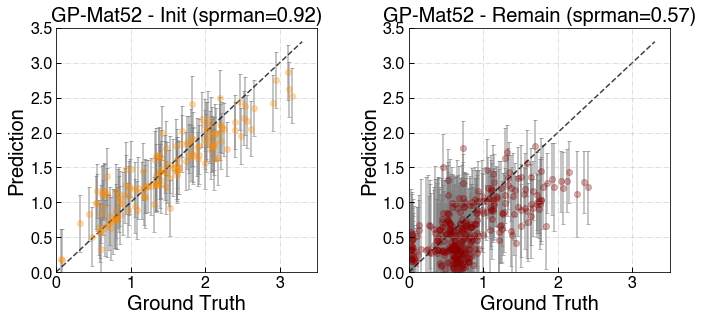

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


160
highest power so far:  3.168620841
Optimization restart 1/3, f = 123.92555027391913
Optimization restart 2/3, f = 124.19826694644716
Optimization restart 3/3, f = 124.25815410157581
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99994127  |   0.01,10.0   |        
  [1]    |                       0.79367487  |   0.01,10.0   |        
  [2]    |                       0.95108288  |   0.01,10.0   |        
  [3]    |                       1.15299710  |   0.01,10.0   |        
  [4]    |                       9.99999959  |   0.01,10.0   |        
  [5]    |                       8.67334620  |   0.01,10.0   |        
  [6]    |                       1.02637189  |   0.01,10.0   |        
  [7]    |                       9.99973850  |   0.01,10.0   |        
  [8]    |                       0.74634712  |   0.01,10.0   |        
  [9]    |                       2.45849677  |   0.01,10.0   |        
  [10]   |                       

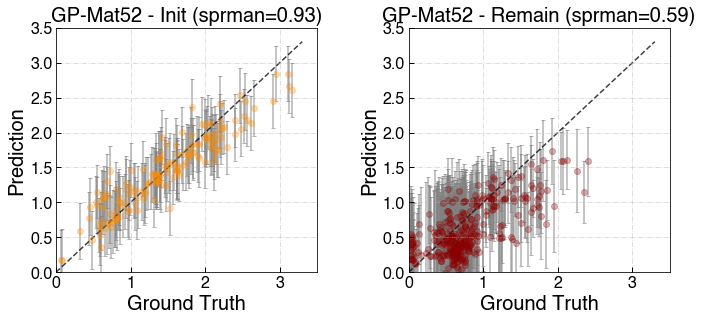

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


170
highest power so far:  3.168620841
Optimization restart 1/3, f = 126.73699548128722
Optimization restart 2/3, f = 127.24412292202365
Optimization restart 3/3, f = 129.5541671360682
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       5.87322233  |   0.01,10.0   |        
  [1]    |                       0.90476601  |   0.01,10.0   |        
  [2]    |                       0.90142470  |   0.01,10.0   |        
  [3]    |                       1.73151733  |   0.01,10.0   |        
  [4]    |                       9.99426746  |   0.01,10.0   |        
  [5]    |                       0.63301437  |   0.01,10.0   |        
  [6]    |                       9.99940154  |   0.01,10.0   |        
  [7]    |                       9.99999945  |   0.01,10.0   |        
  [8]    |                       0.76352332  |   0.01,10.0   |        
  [9]    |                       0.92213914  |   0.01,10.0   |        
  [10]   |                       0

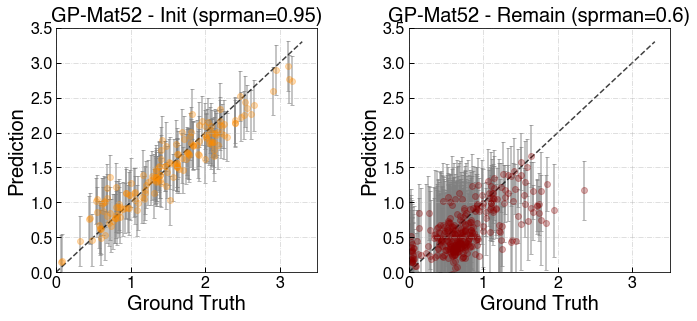

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


180
highest power so far:  3.168620841
Optimization restart 1/3, f = 127.37765295909233
Optimization restart 2/3, f = 127.3708451032407
Optimization restart 3/3, f = 127.32891042056426
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       4.44809090  |   0.01,10.0   |        
  [1]    |                       0.95409315  |   0.01,10.0   |        
  [2]    |                       0.90536529  |   0.01,10.0   |        
  [3]    |                       1.98495756  |   0.01,10.0   |        
  [4]    |                       1.39405197  |   0.01,10.0   |        
  [5]    |                       0.62767964  |   0.01,10.0   |        
  [6]    |                       9.99999994  |   0.01,10.0   |        
  [7]    |                       9.99999816  |   0.01,10.0   |        
  [8]    |                       0.80974473  |   0.01,10.0   |        
  [9]    |                       1.01424010  |   0.01,10.0   |        
  [10]   |                       1

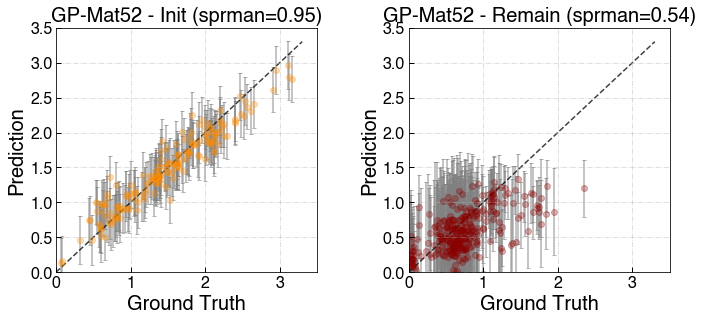

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


190
highest power so far:  3.168620841
Optimization restart 1/3, f = 131.59246703844613
Optimization restart 2/3, f = 131.59246694644406
Optimization restart 3/3, f = 131.59247130361086
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99990903  |   0.01,10.0   |        
  [1]    |                       1.29829284  |   0.01,10.0   |        
  [2]    |                       0.94149434  |   0.01,10.0   |        
  [3]    |                       1.46015926  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.71821674  |   0.01,10.0   |        
  [6]    |                       2.19990702  |   0.01,10.0   |        
  [7]    |                       9.99999434  |   0.01,10.0   |        
  [8]    |                       0.85330160  |   0.01,10.0   |        
  [9]    |                       1.75003215  |   0.01,10.0   |        
  [10]   |                       

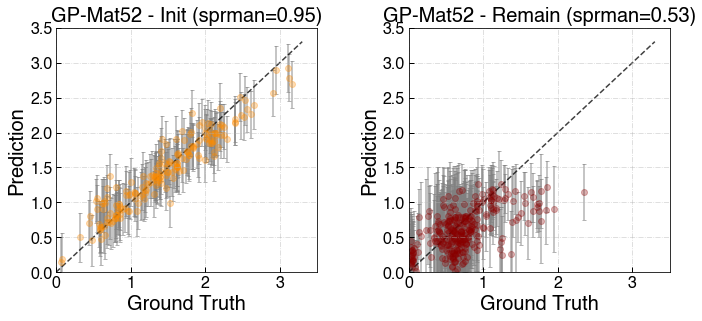

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


200
highest power so far:  3.168620841
Optimization restart 1/3, f = 137.18870855682087
Optimization restart 2/3, f = 137.1887094671428
Optimization restart 3/3, f = 137.18974809899706
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99988785  |   0.01,10.0   |        
  [1]    |                       1.44030305  |   0.01,10.0   |        
  [2]    |                       1.09639093  |   0.01,10.0   |        
  [3]    |                       1.29789012  |   0.01,10.0   |        
  [4]    |                       9.99996740  |   0.01,10.0   |        
  [5]    |                       0.83953232  |   0.01,10.0   |        
  [6]    |                       1.80677429  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.84358058  |   0.01,10.0   |        
  [9]    |                       1.88684063  |   0.01,10.0   |        
  [10]   |                       0

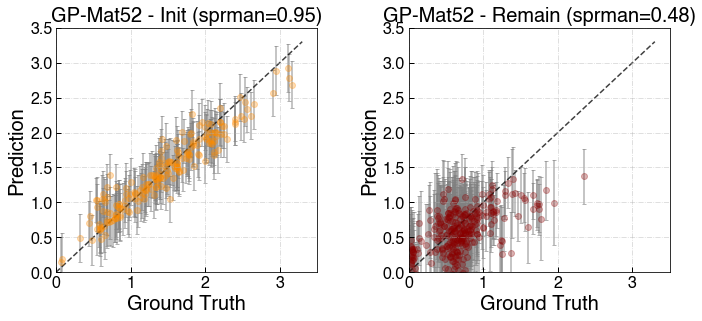

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


210
highest power so far:  3.168620841
Optimization restart 1/3, f = 147.46312468429034
Optimization restart 2/3, f = 147.46312399640624
Optimization restart 3/3, f = 147.4631241833753
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99997637  |   0.01,10.0   |        
  [1]    |                       1.51407269  |   0.01,10.0   |        
  [2]    |                       1.27868676  |   0.01,10.0   |        
  [3]    |                       1.17182081  |   0.01,10.0   |        
  [4]    |                       9.99995949  |   0.01,10.0   |        
  [5]    |                       0.90800340  |   0.01,10.0   |        
  [6]    |                       1.64147601  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.97221002  |   0.01,10.0   |        
  [9]    |                       2.01959845  |   0.01,10.0   |        
  [10]   |                       0

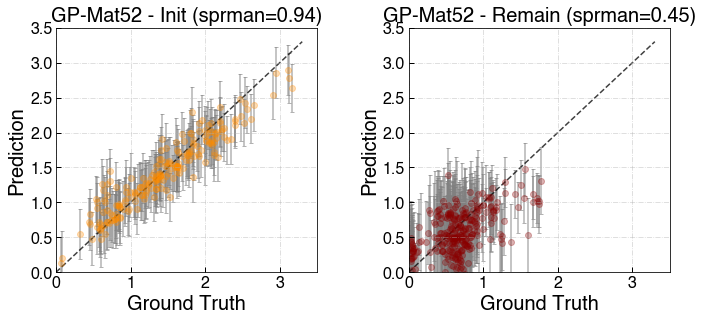

reconstraining parameters Mat52.lengthscale
reconstraining parameters Mat52.variance


220
highest power so far:  3.168620841
Optimization restart 1/3, f = 152.25279498808789
Optimization restart 2/3, f = 152.25425623840124
Optimization restart 3/3, f = 152.25279468024058
  index  |  GP_regression.Mat52.lengthscale  |  constraints  |  priors
  [0]    |                       9.99997456  |   0.01,10.0   |        
  [1]    |                       1.41561029  |   0.01,10.0   |        
  [2]    |                       1.29581678  |   0.01,10.0   |        
  [3]    |                       1.16635344  |   0.01,10.0   |        
  [4]    |                      10.00000000  |   0.01,10.0   |        
  [5]    |                       0.79888337  |   0.01,10.0   |        
  [6]    |                       1.54700862  |   0.01,10.0   |        
  [7]    |                      10.00000000  |   0.01,10.0   |        
  [8]    |                       0.89091210  |   0.01,10.0   |        
  [9]    |                       1.99762385  |   0.01,10.0   |        
  [10]   |                       

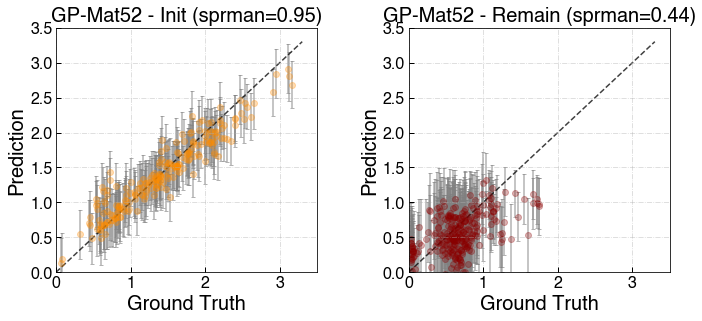

230


In [33]:
y_list_descr = []
for rep in np.arange(10):
    elem4_indx_random = [np.random.randint(len(X_val)) for i in np.arange(10)]
    X_val_init = X_val[elem4_indx_random]
    y_val_init = y_val[elem4_indx_random]
    X_init = np.concatenate([X_train, X_test, X_val_init])
    y_init = np.concatenate([y_train, y_test, y_val_init])
    X_remain = np.delete(X_val,elem4_indx_random, 0)
    y_remain = np.delete(y_val,elem4_indx_random, 0) 
    for it in np.arange(20):
        print("highest power so far: ", np.max(y_init))

        ker = GPy.kern.Matern52(input_dim = len(X_init[0]), ARD =True)#
        ker.lengthscale.constrain_bounded(1e-2, 10)
        ker.variance.constrain_bounded(1e-2, 100.0)

        gpy_regr = GPRegression(X_init, y_init, ker)#
        #gpy_regr.Gaussian_noise.variance = (0.01)**2
        #gpy_regr.Gaussian_noise.variance.fix()
        gpy_regr.randomize()
        gpy_regr.optimize_restarts(num_restarts=3,verbose =True, messages=False)
        print(ker.lengthscale)
        print(ker.variance)
        print(gpy_regr.Gaussian_noise)


        y_pred_init, y_uncer_init= gpy_regr.predict(X_init)
        y_pred_remain, y_uncer_remain = gpy_regr.predict(X_remain)
        plt_true_vs_pred([y_init, y_remain], 
                         [y_pred_init, y_pred_remain], [y_uncer_init, y_uncer_remain],
                         ['GP-Mat52 - Init','GP-Mat52 - Remain'],
                         ['darkorange', 'darkred'])
        ucb = np.sqrt(y_uncer_remain)+y_pred_remain
        top_ucb_indx = np.argsort(ucb[:,-1])[-10:]
        X_new = X_remain[top_ucb_indx]
        y_new = y_remain[top_ucb_indx]

        X_init = np.concatenate([X_init, X_new])
        y_init = np.concatenate([y_init, y_new])
        X_remain = np.delete(X_remain,top_ucb_indx, 0)
        y_remain = np.delete(y_remain,top_ucb_indx, 0)
        print(len(X_init))
    y_list_descr.append(y_init)

In [1]:
fig, axes = plt.subplots(1, 1, figsize=(5.5*1.5, 4.5), sharey = False)
fs = 20
ax = axes
ymax_acc_list = []
for i in np.arange(len(y_list_descr)):
    ymax_acc = np.maximum.accumulate(y_list_descr[i])
    ax.plot(np.arange(len(y_list_descr[i]))-len(np.concatenate([X_train, X_test])),
            ymax_acc, c = 'green', alpha = 0.3)
    ymax_acc_list.append(ymax_acc)
ax.plot(np.arange(len(y_list_descr[0]))-len(np.concatenate([X_train, X_test])),
        np.mean(ymax_acc_list, axis = 0), '--', c = 'blue', alpha = 0.8)
#ax.scatter(np.arange(len(y_init))-len(np.concatenate([X_train, X_test])),y_init, c = 'green',alpha = 0.2)

ax.plot(np.zeros(10),np.arange(10)/2-1, '--',c = 'black')
ax.set_ylabel('Current Best Efficiency', fontsize = 20)
ax.set_xlabel('Materials Composition', fontsize = 20)

ax.set_ylim(0.2, 3.5)
#axes[0].set_xlim(-1, 105)
#axes[0].set_xticks(np.arange(0,105,10))
ax.legend(fontsize = fs*0.7)
ax.tick_params(direction='in', length=5, width=1, labelsize = fs*.8, grid_alpha = 0.5)
ax.grid(True, linestyle='-.')

plt.show()

NameError: name 'plt' is not defined